# Sentiment analysis & topic modelling

In [1]:
#import libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import seaborn as sns
import csv
import re
import string
import spacy
import nltk
nltk.download('vader_lexicon')
from wordcloud import WordCloud
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from tqdm import tqdm, tqdm_notebook
from tqdm import trange
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

sns.set_style('whitegrid')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/ziliang/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


## Sentiment analysis

We will now load the BT articles and score them using VADER, which will let us know the sentiment of each article. 

In [2]:
bt_df = pd.read_csv('../datasets/bt/bt_combined.csv')

In [3]:
bt_df

,Unnamed: 0,byline,date,headline,page,text
0,0,Helmi Yusof,2014-12-29,Nurturing talent – 10 years and counting,12 - 13,helmi@sph.com.sg @HelmiBT CHILDAID 2104 was a ...
1,1,R Sivanithy,2014-12-29,Good chance for window-dressing push on STI,7,STOCKS sivan@sph.com.sg @RSivanithyBT IN TH...
2,2,Robert Halili,2014-12-29,Directors’ buying down in holiday shortened week,6,INSIDE MARKETS But selling recovers with 12 co...
3,3,Cai Haoxiang,2014-12-29,Why invest? And how do you do it?,10,MONDAY MULTIPLE Aim for a sustainable stream o...
4,4,Claire Huang,2014-12-29,Correction:,4,IN “Continued smooth sailing a safe bet for no...
5,5,Lee Meixian,2014-12-29,Soft market ahead for most developers,1,OUTLOOK 2015: INDUSTRIAL PROPERTY But high-spe...
6,6,Pauline Ng,2014-12-29,More of the same enervating and dismal politic...,2,"OUTLOOK 2015: MALAYSIA Analysts, however, hope..."
7,7,NaN,2014-12-30,Advertisers give BT website top marks,3,Singapore THE Business Times website has been ...
8,8,NaN,2014-12-30,PM: Michael Fam a rare and selfless individual,6,OBITUARY: MICHAEL FAM MICHAEL Fam was a “rare ...
9,9,Anthony Rowley,2014-12-30,Scrabbling for a place at the AIIB table,21,Strong political bargaining is going on behind...


In [4]:
bt_df.drop('Unnamed: 0', axis=1, inplace=True) # drop column that was formed from index

### Check for null values

In [5]:
bt_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49171 entries, 0 to 49170
Data columns (total 5 columns):
byline      41208 non-null object
date        49171 non-null object
headline    49161 non-null object
page        47805 non-null object
text        49159 non-null object
dtypes: object(5)
memory usage: 1.9+ MB


In [6]:
bt_df[bt_df['text'].isna()]

,byline,date,headline,page,text
12046,"District Medical Officer, Nacala, Mozambique19...",2015-10-24,NaN,8 - 9,NaN
26707,Singapore Island Country Club – New Courseaug ...,2016-03-26,NaN,L16,NaN
29817,NaN,2017-11-25,NaN,NaN,NaN
30150,NaN,2017-11-11,NaN,NaN,NaN
30369,NaN,2017-11-04,SAVING FACE (cont’d),NaN,NaN
32512,NaN,2017-08-10,Rallying to #OneNationTogether,4,NaN
35929,Per Cent Or S$0.02 To Close Trading At S$2.78.,2017-02-10,NaN,7,NaN
40600,NaN,2018-06-15,NEW KIDS ON THE BLOCK (Cont’d),NaN,NaN
42702,NaN,2018-03-16,A CLASSIC MAKEOVER,NaN,NaN
42856,NaN,2018-03-09,SPRING/SUMMER 2018 TREND REPORT(cont’d),NaN,NaN


We have 12 articles with null values for the text. As this is just 0.02% of our data, we can drop these rows. 

In [7]:
bt_df = bt_df.dropna(subset = ['text'])
bt_df.isna().sum()

byline      7954
date           0
headline       5
page        1359
text           0
dtype: int64

We no longer have null values for the text column.

In [8]:
tqdm.pandas(tqdm_notebook) #instantiate to see progress bar in pandas when needed

#### Removing email and twitter handles

Many of the stories contain the email and twitter handles of the journalists. Let's use regular expressions to get rid of them. 

In [9]:
bt_df['text'] = bt_df['text'].progress_map(lambda text: re.sub('\S*@\S*\s?', '', text)) 
#re.sub find patterns of text with @ and replace with nothing, hence removing them
#progress map to use tqdm to track progress 

100%|██████████| 49159/49159 [00:10<00:00, 4651.96it/s]
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


### Modify VADER lexicon

Because VADER is a general sentiment analyser, we need to augment it for financial and economic sentiment analysis. Much research has been done in this area and I will use the [Loughran-McDonald list](https://sraf.nd.edu/textual-analysis/resources/#LM%20Sentiment%20Word%20Lists) of financial terms. 

To do so, we will instantiate two different versions of the VADER sentiment intensity analyser. One will be the base version and the other will have financial terms added to the lexicon. We will then use both to score a sentence related to finance to see if both return different sentiment scores. 

In [10]:
sia_base = SentimentIntensityAnalyzer()
sia_finance = SentimentIntensityAnalyzer()

In [11]:
#update sia_finance lexicon with positive and negative words
positive = [] #empty list to store positive words
with open('../datasets/financial-words/lm_positive.csv', 'r') as f: #open positive csv as f
    reader = csv.reader(f) #read f using csv.reader
    for row in reader: #this returns every word as a list
        positive.append(row[0].strip().lower()) #call first element (the word), remove all leading and trailing whitespaces, lowercase, append to positive list
    
negative = [] #empty list to store negative words
with open('../datasets/financial-words/lm_negative.csv', 'r') as f: #open negative csv as f
    reader = csv.reader(f) #read f using csv.reader
    for row in reader: #this returns every word as a list
        negative.append(row[0].strip().lower()) #call first element (the word), remove all leading and trailing whitespaces, lowercase, append to negative list

final_lex = {} #empty dict to store final lexicon
final_lex.update({word:2.0 for word in positive}) #add positive score for every positive word
final_lex.update({word:-2.0 for word in negative}) #add negative score for every negative word
final_lex.update(sia_finance.lexicon) #add base lexicon
sia_finance.lexicon = final_lex #sia_finance's lexicon is now the new lexicon

In [12]:
print('Base lexicon:', len(sia_base.lexicon))
print('Base + finance lexicon:', len(sia_finance.lexicon))

Base lexicon: 7502
Base + finance lexicon: 9341


Let's test if the expanded lexicon makes a difference. 

In [13]:
sentence = 'Stocks were volatile on Tuesday due to the recent calamities in the Singapore market.' # sample sentence

tokenized_sentence = nltk.word_tokenize(sentence) #tokenise words
pos_word_list=[] #empty list for positive words
neu_word_list=[] #empty list for negative words
neg_word_list=[] #empty list for neutral words

for word in tokenized_sentence:
    if (sia_base.polarity_scores(word)['compound']) >= 0.1: #above 0.1 considered positive
        pos_word_list.append(word)
    elif (sia_base.polarity_scores(word)['compound']) <= -0.1: #below -0.1 considered negative
        neg_word_list.append(word)
    else:
        neu_word_list.append(word)      #else neutral          

print('Positive:',pos_word_list) #return positive words
print('Neutral:',neu_word_list) #return neutral words
print('Negative:',neg_word_list) #return negative words
score = sia_base.polarity_scores(sentence) #score full sentence
print('\nScores:', score)

Positive: []
Neutral: ['Stocks', 'were', 'volatile', 'on', 'Tuesday', 'due', 'to', 'the', 'recent', 'calamities', 'in', 'the', 'Singapore', 'market', '.']
Negative: []

Scores: {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}


In [14]:
sentence = 'Stocks were volatile on Tuesday due to the recent calamities in the Singapore market.' # sample sentence

tokenized_sentence = nltk.word_tokenize(sentence) #tokenise words
pos_word_list=[] #empty list for positive words
neu_word_list=[] #empty list for negative words
neg_word_list=[] #empty list for neutral words

for word in tokenized_sentence:
    if (sia_finance.polarity_scores(word)['compound']) >= 0.1: #above 0.1 considered positive
        pos_word_list.append(word)
    elif (sia_finance.polarity_scores(word)['compound']) <= -0.1: #below -0.1 considered negative
        neg_word_list.append(word)
    else:
        neu_word_list.append(word)      #else neutral          

print('Positive:',pos_word_list) #return positive words
print('Neutral:',neu_word_list) #return neutral words
print('Negative:',neg_word_list) #return negative words
score = sia_finance.polarity_scores(sentence) #score full sentence
print('\nScores:', score)

Positive: []
Neutral: ['Stocks', 'were', 'on', 'Tuesday', 'due', 'to', 'the', 'recent', 'in', 'the', 'Singapore', 'market', '.']
Negative: ['volatile', 'calamities']

Scores: {'neg': 0.333, 'neu': 0.667, 'pos': 0.0, 'compound': -0.7184}


Analyser with base lexicon returned a neutral score while the analyser with financial lexicon returned a negative score, showing the financial lexicon makes a difference. 

## Apply VADER to BT articles

In [15]:
bt_df['scores'] = bt_df['text'].progress_map(lambda article: sia_finance.polarity_scores(article)) 
#progress map to see progress

100%|██████████| 49159/49159 [05:50<00:00, 140.13it/s]
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [16]:
scores = ['neg', 'neu', 'pos', 'compound']
for score in scores: #split up scores into individual columns
    bt_df[score]  = bt_df['scores'].apply(lambda score_dict: score_dict[score])

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


The compound score will form our new economic indicator, which we will call BT Beats - Business & Economic Activity Trends & Sentiment.

## Visualisation of BT Beats and economic data

#### Quarterly data

In [17]:
bt_df['date'] = pd.to_datetime(bt_df['date']) #change to date type
bt_df['date'].dtype #check if change is successful 

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


dtype('<M8[ns]')

In [18]:
quart_df = pd.read_csv('../datasets/economic-data/quart.csv')
quart_df.drop('Unnamed: 0', axis=1, inplace=True)
quart_df['date'] = pd.to_datetime(quart_df['date']) #change to date type
quart_df['date'].dtype #check if change is successful 

dtype('<M8[ns]')

/anaconda3/lib/python3.7/site-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


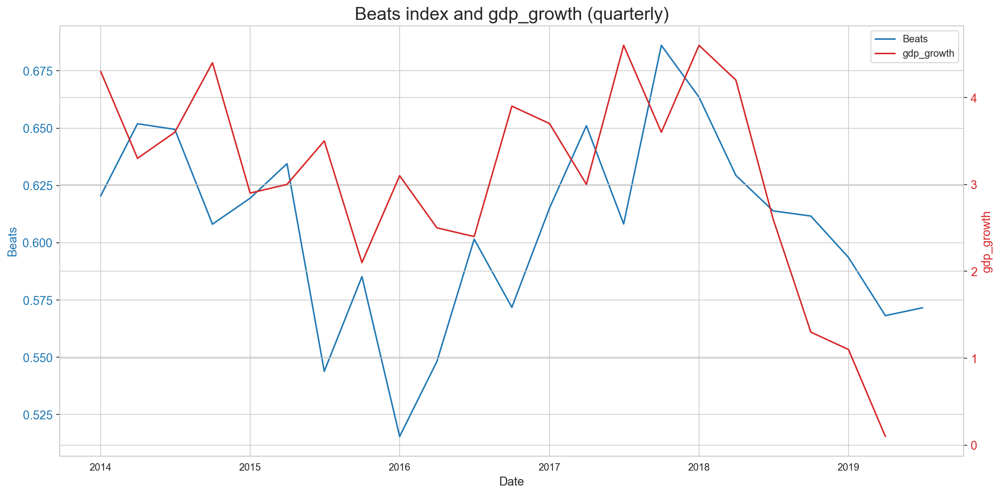

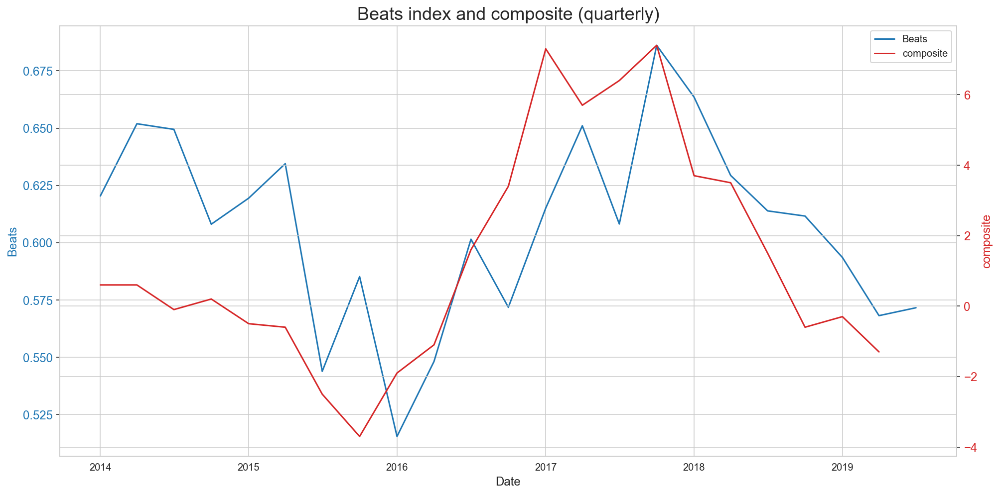

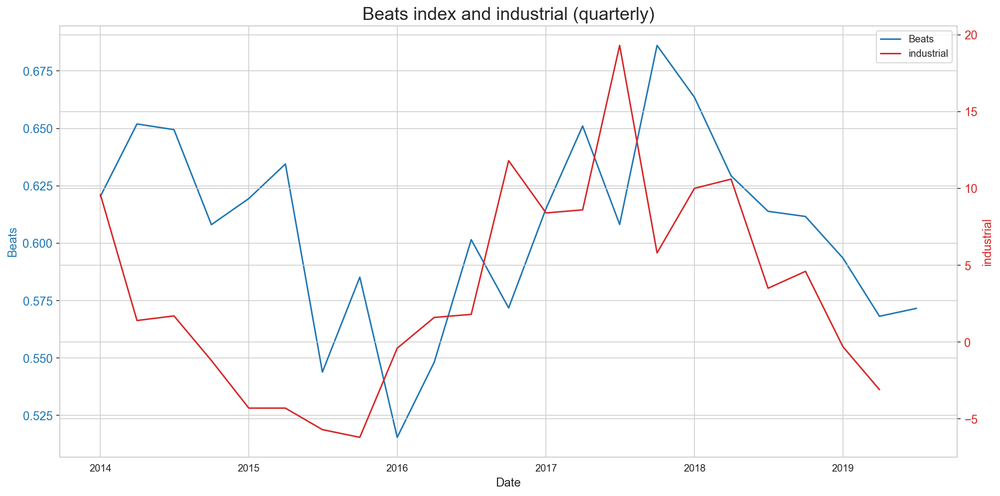

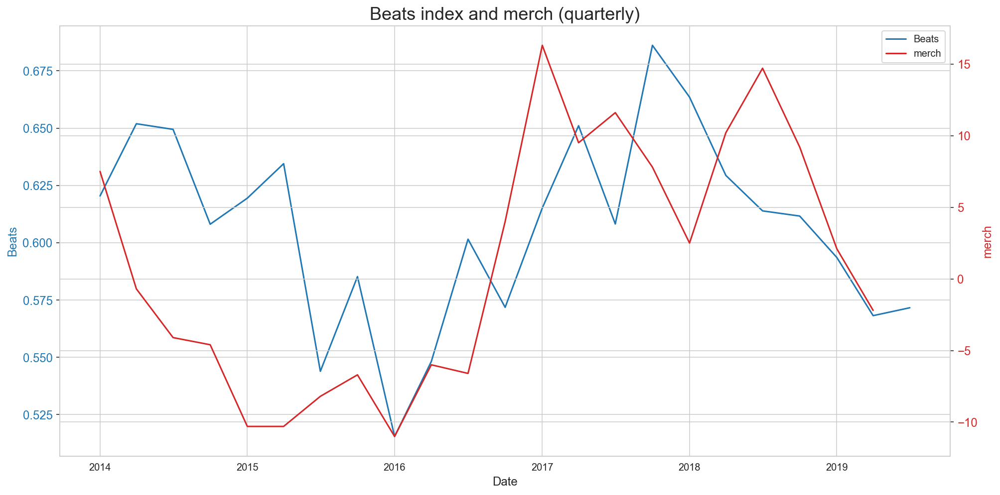

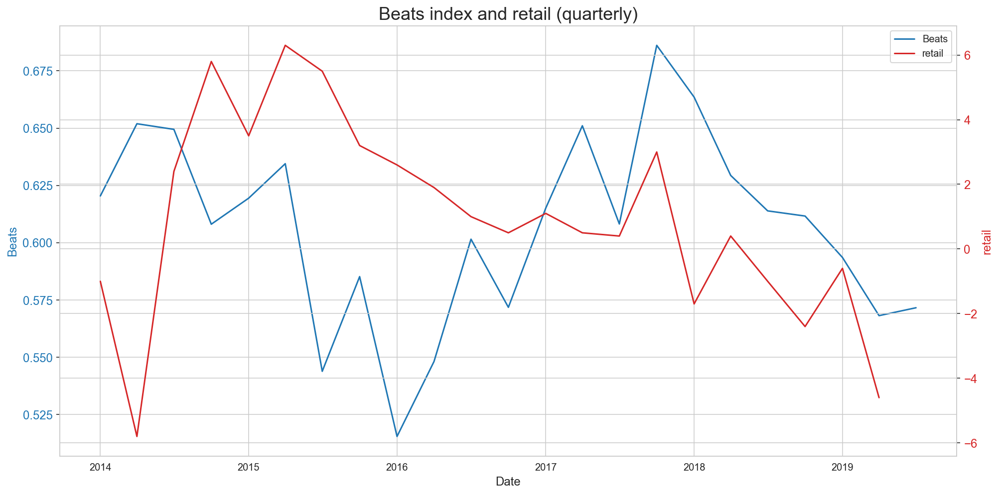

In [19]:
for column in quart_df.columns.drop('date'): #plot each column successively, except date
    fig, ax1 = plt.subplots(figsize=(14,7)) #dual axis plot

    color1 = 'tab:blue'
    ax1.set_xlabel('Date', size=12)
    ax1.set_ylabel('Beats', color=color1, size=12)
    ax1.plot(bt_df.groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().index.to_timestamp(), 
             bt_df.groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().values, 
             color=color1, 
             label='Beats')
    #groupby period then take mean of compound score, plot x is time, y is mean compound score
    ax1.tick_params(axis='y', labelsize=12, labelcolor=color1)
    ax1.set_title('Beats index and {} (quarterly)'.format(column), size=18)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color2 = 'tab:red'
    ax2.set_ylabel(column, color=color2, size=12)  # we already handled the x-label with ax1
    ax2.plot(quart_df['date'], quart_df[column], color=color2, label=column)
    ax2.tick_params(axis='y', labelsize=12, labelcolor=color2)
    
    # ask matplotlib for the plotted objects and their labels
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(lines1 + lines2, labels1 + labels2)

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.show()

Plots show that the Beats index is correlated with the other economic indicators to varying degrees. Indeed, the Beats index seems to be a leading indicator for some of the other indexes and we can explore this further. 

/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/datetimelike.py:1197: FutureWarning: Addition/subtraction of integers and integer-arrays to DatetimeArray is deprecated, will be removed in a future version.  Instead of adding/subtracting `n`, use `n * self.freq`
  maybe_integer_op_deprecated(self)


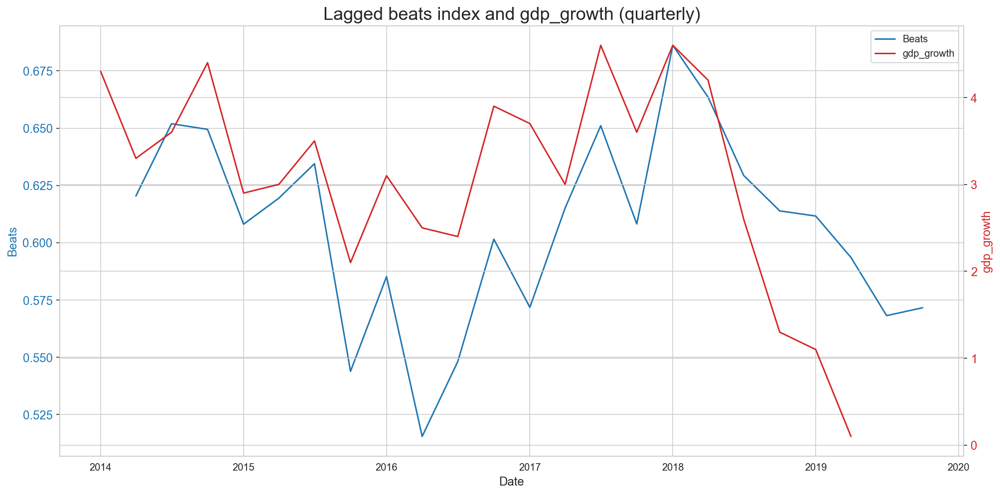

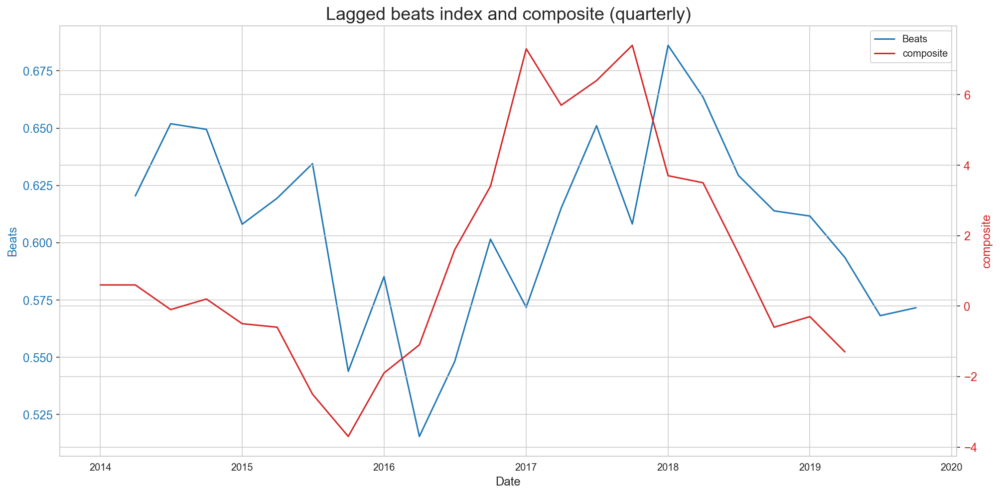

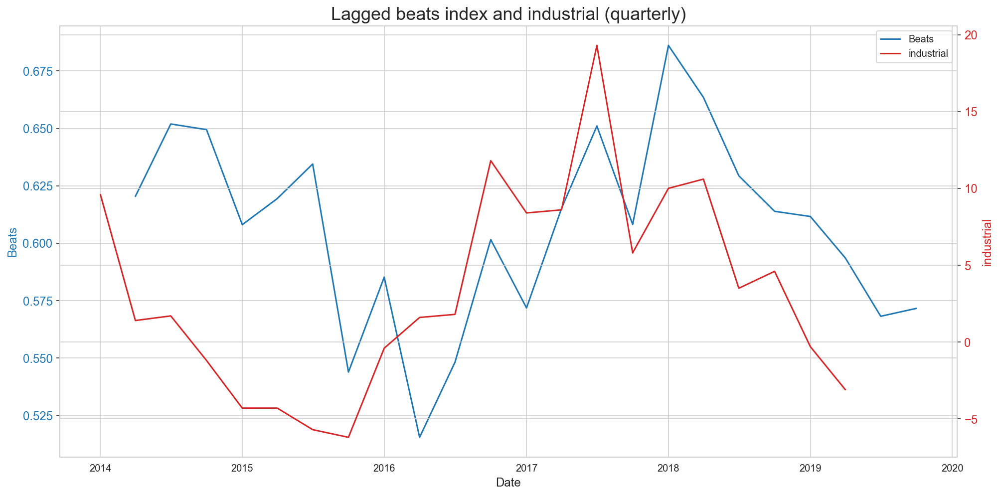

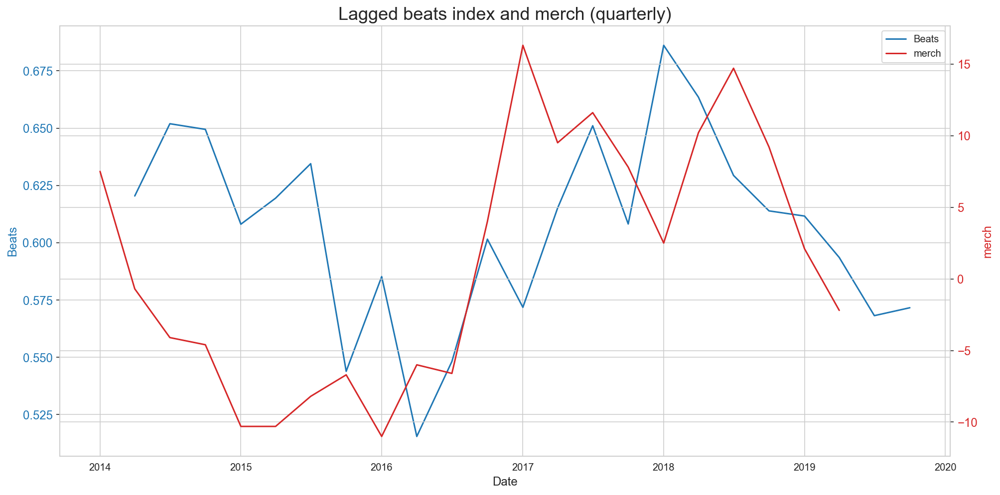

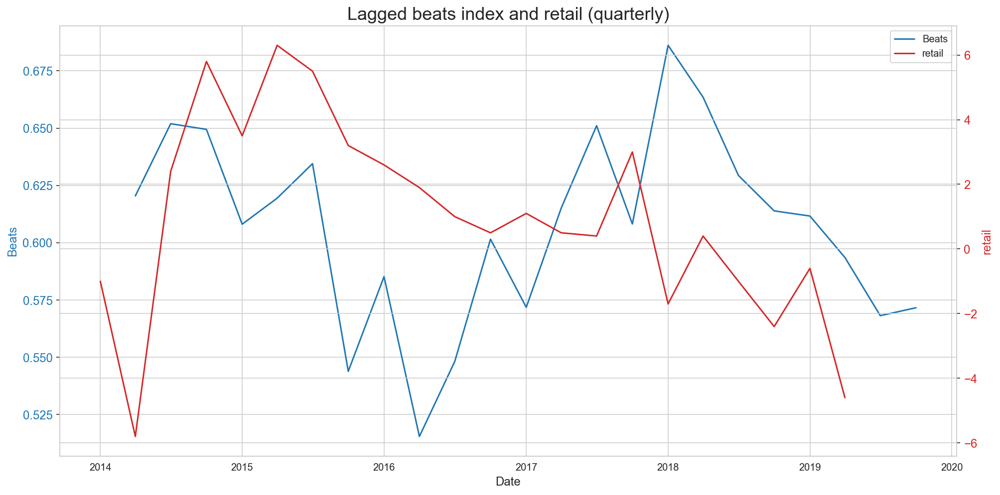

In [20]:
for column in quart_df.columns.drop('date'): #plot each column successively, except date
    fig, ax1 = plt.subplots(figsize=(14,7)) #dual axis plot

    color1 = 'tab:blue'
    ax1.set_xlabel('Date', size=12)
    ax1.set_ylabel('Beats', color=color1, size=12)
    ax1.plot(bt_df.groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().index.to_timestamp()+1, 
             bt_df.groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().values, 
             color=color1, 
             label='Beats')
    #groupby period then take mean of compound score, 
    #plot x is time(+1 to shift beats back one time period ie plot 2018Q3 value at 2018Q4), 
    #y is mean compound score
    ax1.tick_params(axis='y', labelsize=12, labelcolor=color1)
    ax1.set_title('Lagged beats index and {} (quarterly)'.format(column), size=18)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color2 = 'tab:red'
    ax2.set_ylabel(column, color=color2, size=12)  # we already handled the x-label with ax1
    ax2.plot(quart_df['date'], quart_df[column], color=color2, label=column)
    ax2.tick_params(axis='y', labelsize=12, labelcolor=color2)
    
    # ask matplotlib for the plotted objects and their labels
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(lines1 + lines2, labels1 + labels2)

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.show()

We can see that the Beats index and GDP are almost perfectly synced now when we move the time period for Beats back by one quarter (for example, plotting 2018 Q3 score at 2018 Q4). The same can be observed for the industrial production index, albeit to a lesser degree.

#### Monthly data

In [21]:
month_df = pd.read_csv('../datasets/economic-data/month.csv')
month_df.drop('Unnamed: 0', axis=1, inplace=True)
month_df['date'] = pd.to_datetime(month_df['date']) #change to date type
month_df['date'].dtype #check if change is successful 

dtype('<M8[ns]')

In [269]:
[column for column in month_df.columns.drop('date')]

['industrial', 'merch', 'retail']

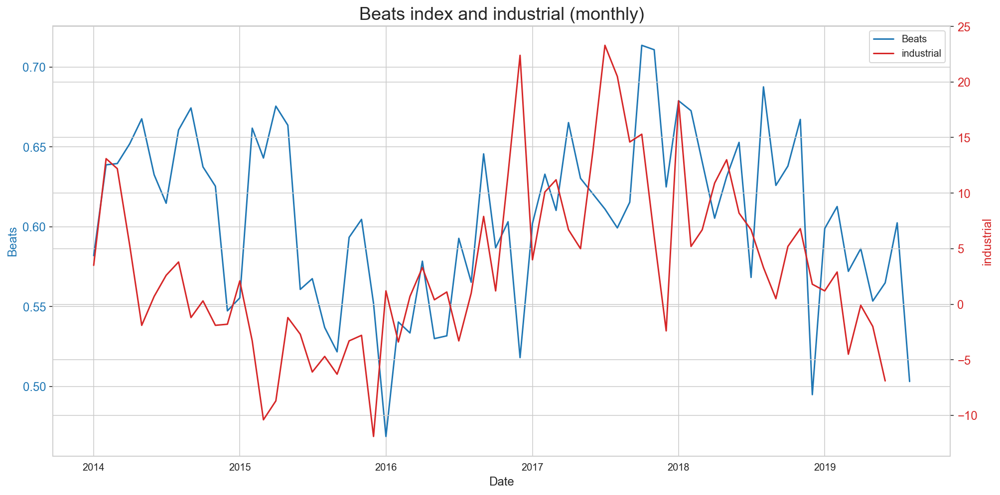

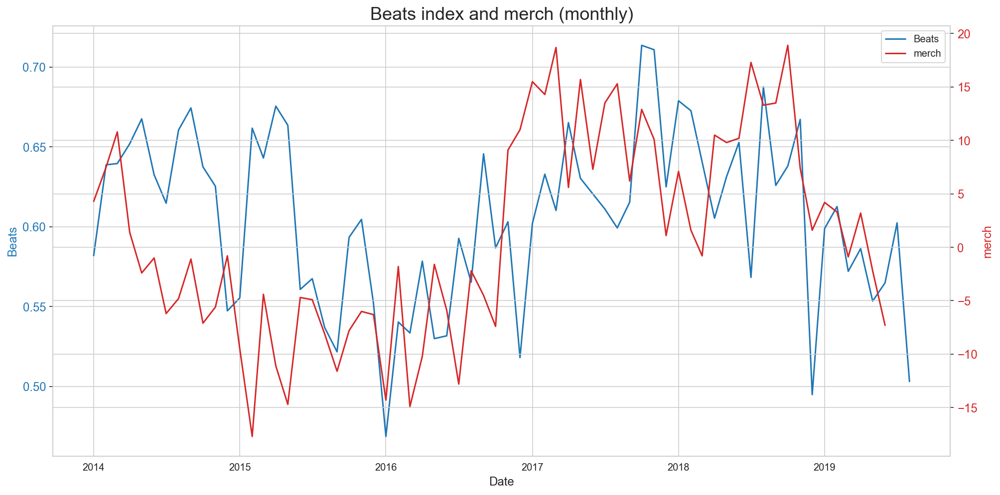

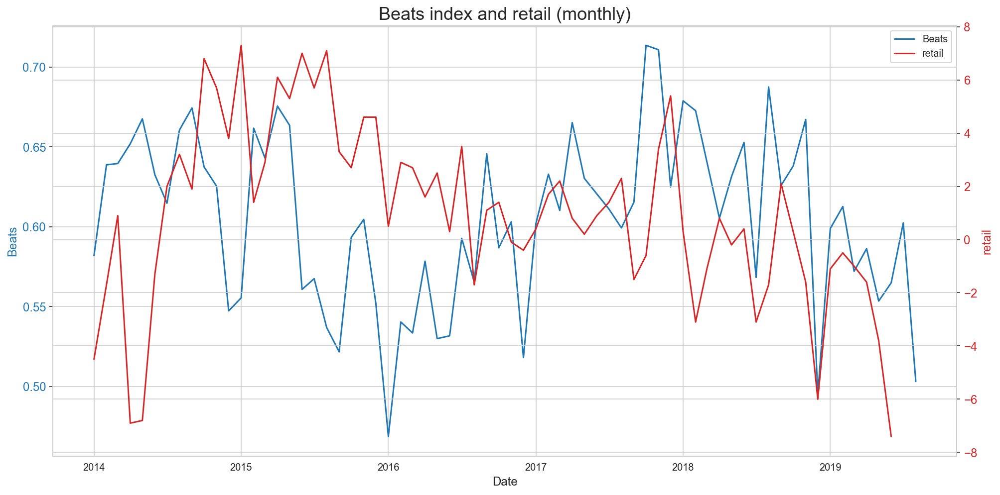

In [22]:
for column in month_df.columns.drop('date'): #plot each column successively, except date
    fig, ax1 = plt.subplots(figsize=(14,7)) #dual axis plot

    color1 = 'tab:blue'
    ax1.set_xlabel('Date', size=12)
    ax1.set_ylabel('Beats', color=color1, size=12)
    ax1.plot(bt_df.groupby(bt_df.date.dt.to_period('m'))['compound'].mean().index.to_timestamp(), #groupby period then take mean of compound score, plot x is time,
             bt_df.groupby(bt_df.date.dt.to_period('m'))['compound'].mean().values, #y is mean compound score
             color=color1, label='Beats')
    ax1.tick_params(axis='y', labelsize=12, labelcolor=color1)
    ax1.set_title('Beats index and {} (monthly)'.format(column), size=18)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color2 = 'tab:red'
    ax2.set_ylabel(column, color=color2, size=12)  # we already handled the x-label with ax1
    ax2.plot(month_df['date'], month_df[column], color=color2, label=column)
    ax2.tick_params(axis='y', labelsize=12, labelcolor=color2)
    
    # ask matplotlib for the plotted objects and their labels
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(lines1 + lines2, labels1 + labels2)

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.show()

The monthly Beats index also shows correlation with other economic indicators, matching the general trend of the data's movement.

## Topic modelling 

Using Latent Dirichlet Allocation (LDA), we can identify topics within the entire collection of articles. LDA tells us which topic an article is most likely to belong to and the words most associated with each topic. 

### Yearly topics

Let's identify 10 topics of each year and the words most associated with each topic. 

Before LDA can be performed, we must process the articles (remove capitalisation and punctuation, lemmatise) and then build a document term matrix through vectorisation.

#### Remove capitalisation and punctuation 

In [23]:
#lowercase words and strip punctuation except for apostrophe and dash
bt_df['text_clean'] = bt_df['text'].progress_map(lambda x: ''.join([y for y in list(x.lower()) if y in string.ascii_lowercase+" -'0123456789"]))
#strip dash as well, dash was not stripped in previous step as that would join word inappropriately eg: well-known to wellknown
bt_df['text_clean'] = bt_df['text_clean'].progress_map(lambda x: x.replace('-',' '))

100%|██████████| 49159/49159 [00:27<00:00, 1777.65it/s]
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
100%|██████████| 49159/49159 [00:00<00:00, 154588.48it/s]
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


#### Expand stop words

In [24]:
nlp = spacy.load('en')

In [25]:
nlp.Defaults.stop_words.update(['mr', 'ms', 'say', 'singapore', 'year', 'cent', 'million']) #add common words

In [26]:
print(nlp.vocab['mr'].is_stop)#check if word is inside 
print(nlp.vocab['ms'].is_stop)
print(nlp.vocab['say'].is_stop) 
print(nlp.vocab['singapore'].is_stop)
print(nlp.vocab['year'].is_stop)
print(nlp.vocab['cent'].is_stop)
print(nlp.vocab['million'].is_stop)

True
True
True
True
True
True
True


#### Lemmatisation

In [27]:
def lemmatize(text):
    # Parse sentence into tokens
    doc = nlp(text)
    # Extract lemma for each token and join
    lemmatize_text = " ".join([token.lemma_ for token in doc])
    # pronouns are converted to -PRON-, which is not recognised as stopwords in count vectorizer and tfidf vectorizer, hence they need to be removed
    lemmatize_text = lemmatize_text.replace('-PRON-', '')
    return lemmatize_text

In [28]:
#form new column with lemmatized words
bt_df['text_lemma'] = bt_df['text_clean'].progress_apply(lemmatize)

100%|██████████| 49159/49159 [1:13:09<00:00, 11.20it/s]
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


#### Model topics

Let's define a function to find topics by year.

In [108]:
def topic_year(year_list, n_topics):
    top_words = {} #to store top words of every year
    topic_array = np.array([]) #to store topics of every year
    for year in year_list:
        year_dict = {} #to store top words of this year
        cv = CountVectorizer(max_df=0.95, min_df=2, ngram_range=(1, 2), stop_words=frozenset(nlp.Defaults.stop_words))
        #set max_df so we ignore terms that have a document frequency higher than 95% of documents
        #set min_df so we ignore terms that appear in fewer than 2 documents
        #n_grams to take two words into account at once for context
        #stop words to ignore common english words
        print(f'Forming document term matrix for {year}...')
        dtm = cv.fit_transform(bt_df[bt_df['date'].dt.year == year]['text_lemma'])
        #form doc term matrix of text by year
        print(f'Modelling topics for {year}...')
        LDA = LatentDirichletAllocation(n_components=n_topics, random_state=42, verbose=1) #set n topics, 
        #verbose so we know it's still running as can take a while 
        LDA.fit(dtm)
        topic_proba = LDA.transform(dtm) #to get topic probability for this year
        topic_results = topic_proba.argmax(axis=1) #to get index position of the highest value in each article 
        topic_array = np.concatenate((topic_array, topic_results)) #add to the array of topics
        print('\n')
        print(f'##### TOPICS FOR {year} #####')
        print('\n')
        for index, topic in enumerate(LDA.components_): #returns 10 rows representing 10 topics, each row containing probabilities associated with all words in our dtm, probabilities show how likely the word is associated with that topic
            print(f'THE TOP 30 WORDS FOR TOPIC #{index+1}') #index+1 because index starts at zero
            words = [cv.get_feature_names()[i] for i in topic.argsort()[-30:]] #save the top 30 words in a list
            print(words)
            probs = [topic[i] for i in topic.argsort()[-30:]] #save associated probabilities
            weights = dict(zip(words, probs)) #zip into dictionary
            year_dict[index] = weights #storing weights into year dict, using just index instead of index+1 so this matches the topic number stored in the array
            wc = WordCloud( #instantiate
                background_color="white",
                max_words=2000,
                width=1024,
                height=720)
            wc.generate_from_frequencies(weights) #make the wordcloud
            plt.axis('off')
            plt.imshow(wc)#display
            plt.show()
            print('\n')
        top_words[year] = year_dict #storing top words of each topic for the year
        print('='*60)
        print('\n')
    return {'topics': topic_array, 'top_words': top_words}

Forming document term matrix for 2014...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2014...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2014 #####


THE TOP 30 WORDS FOR TOPIC #1
['mobile', 'board', 'global', 'way', 'director', 'financial', 'development', 'add', 'country', 'good', 'world', 'system', 'datum', 'provide', 'product', 'people', 'help', 'time', 'use', 'asia', 'industry', 'work', 'market', 'technology', 'new', 'customer', 'need', 'service', 'business', 'company']


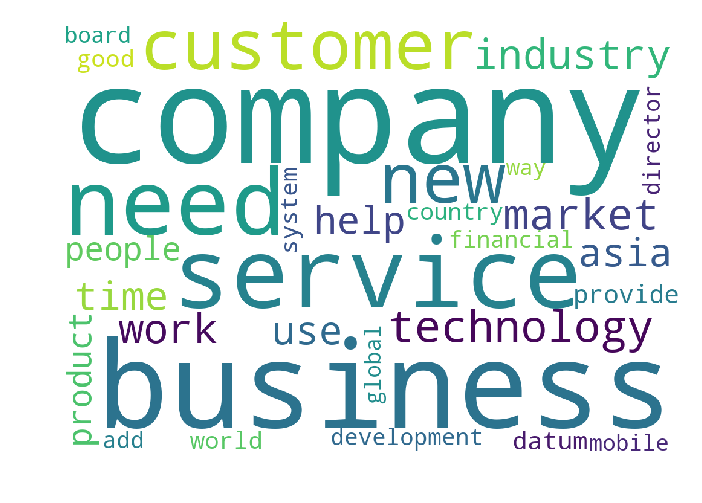



THE TOP 30 WORDS FOR TOPIC #2
['low', 'fall', 'export', 'country', 'point', 'increase', 'japanese', 'trade', 'global', 'asia', 'report', 'high', 'bank', 'continue', 'sector', 'policy', 'airline', 'economist', 'inflation', 'government', 'rate', 'expect', 'china', 'month', 'rise', 'market', 'economic', 'japan', 'economy', 'growth']


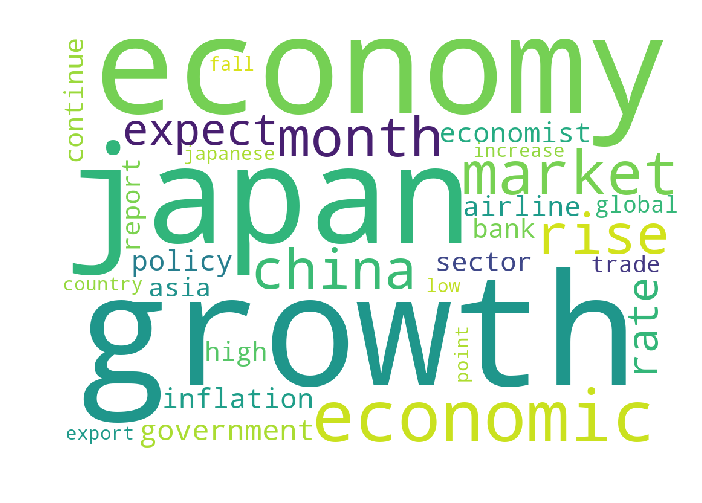



THE TOP 30 WORDS FOR TOPIC #3
['add', 'point', 'local', 'keppel', 'supply', 'firm', 'trading', 'low', 'industry', 'large', 'month', 'water', 'day', 'project', 'state', 'oil price', 'cost', 'come', 'high', 'government', 'week', 'country', 'billion', 'company', 'time', 'stock', 'gas', 'price', 'market', 'oil']


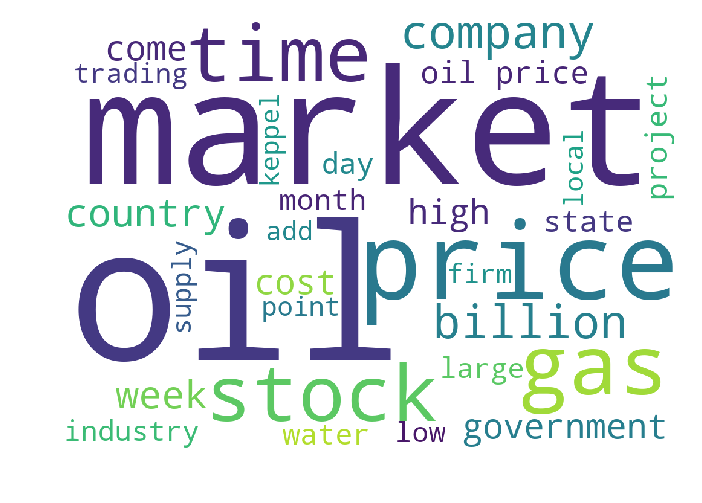



THE TOP 30 WORDS FOR TOPIC #4
['term', 'risk', 'country', 'large', 'kong', 'hong kong', 'trade', 'group', 'hong', 'interest', 'growth', 'capital', 'high', 'bond', 'asset', 'time', 'rate', 'financial', 'global', 'new', 'fund', 'company', 'billion', 'investor', 'business', 'investment', 'asia', 'china', 'market', 'bank']


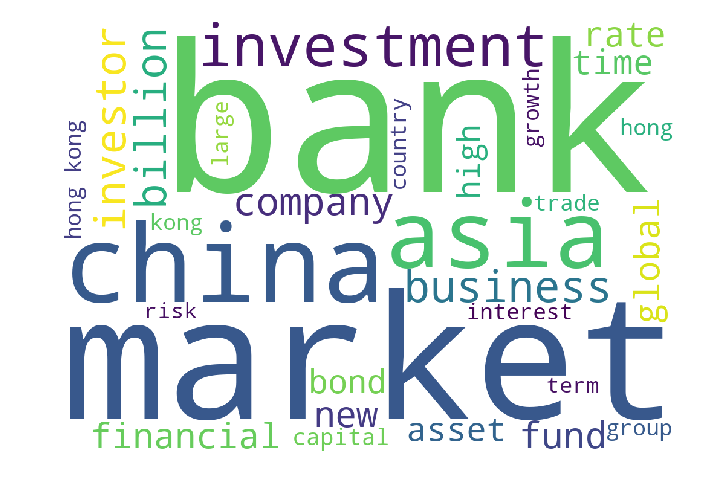



THE TOP 30 WORDS FOR TOPIC #5
['company', 'time', 'launch', 'operator', 'market', 'add', 'manager', 'plant', 'industry', 'mall', 'award', 'fee', 'increase', 'design', 'public', 'use', 'solar', 'development', 'trust', 'business', 'hotel', 'group', 'unit', 'bus', 'property', 'project', 'new', 'energy', 'service', 'reit']


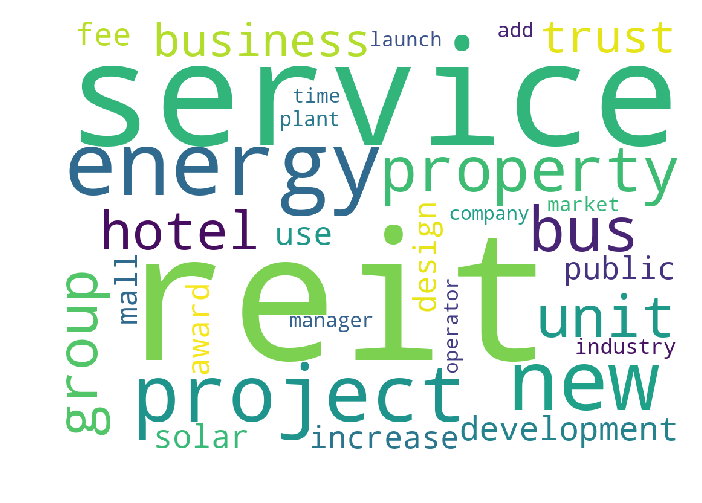



THE TOP 30 WORDS FOR TOPIC #6
['income', 'report', 'continue', 'result', 'company', 'ago', 'fall', 'yesterday', 'loss', 'increase', '2014', 'net profit', 'low', 'stock', 'expect', 'business', 'growth', 'month', 'billion', 'rise', 'earning', 'high', 'market', 'end', 'share', 'group', 'profit', 'net', 'quarter', 'revenue']


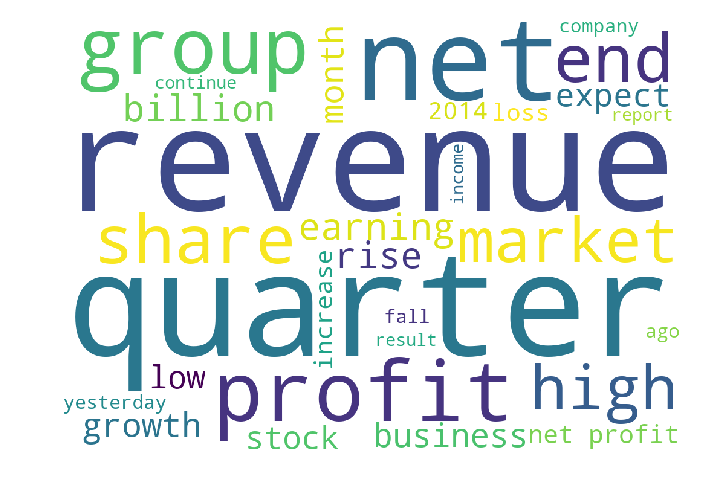



THE TOP 30 WORDS FOR TOPIC #7
['local', 'home', 'find', 'chef', 'include', 'start', 'run', 'way', 'play', 'open', 'artist', 'look', 'use', 'know', 'day', 'wine', 'world', 'design', 'restaurant', 'old', 'food', 'want', 'come', 'people', 'new', 'good', 'time', 'like', 'art', 'work']


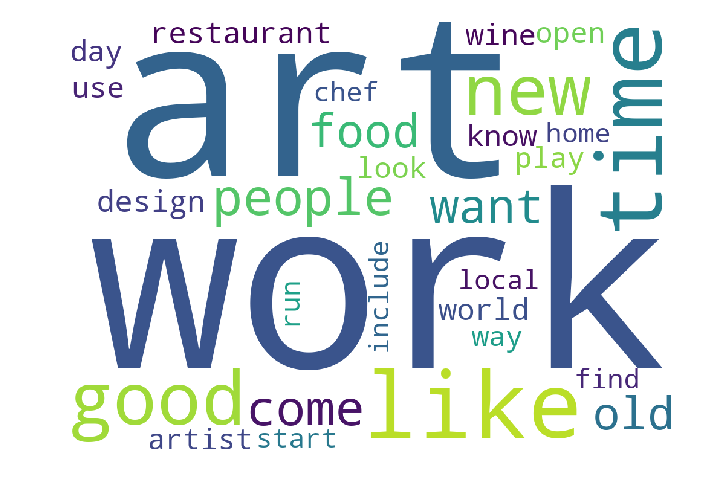



THE TOP 30 WORDS FOR TOPIC #8
['capital', 'issue', 'director', 'high', 'stake', 'offer', 'interest', 'month', 'quarter', 'acquisition', 'stock', 'acquire', 'trade', 'average', 'shareholder', 'investment', 'close', 'value', 'unit', 'purchase', 'holding', 'buy', 'market', '2013', 'sale', 'group', 'company', 'property', 'price', 'share']


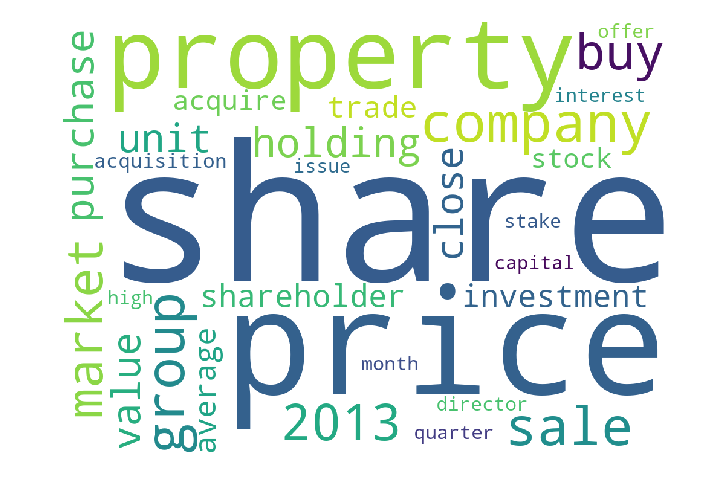



THE TOP 30 WORDS FOR TOPIC #9
['expect', 'square', 'include', 'use', 'rent', 'home', 'residential', 'group', 'launch', 'sale', 'high', 'market', 'building', 'business', 'developer', 'sq ft', 'ft', 'psf', 'office', 'new', 'space', 'area', 'development', 'sq', 'price', 'land', 'property', 'site', 'project', 'unit']


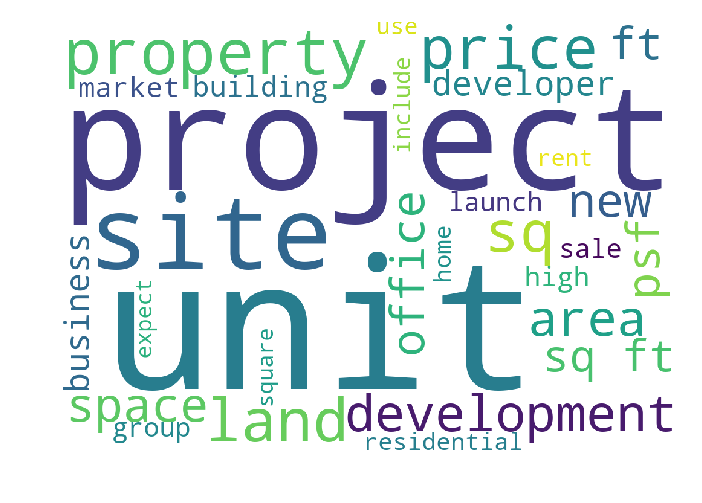



THE TOP 30 WORDS FOR TOPIC #10
['pay', 'need', 'world', 'minister', 'big', 'small', 'speed', 'month', 'use', 'come', 'increase', 'business', 'drive', 'engine', 'low', 'vehicle', 'good', 'model', 'premium', 'time', 'coe', 'company', 'cat', 'sport', 'government', 'tax', 'high', 'worker', 'car', 'new']


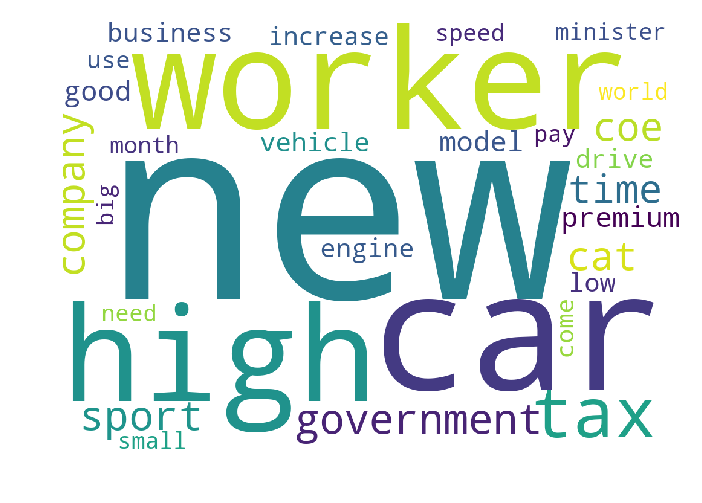





Forming document term matrix for 2015...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2015...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2015 #####


THE TOP 30 WORDS FOR TOPIC #1
['report', 'investor', 'week', 'counter', 'stake', 'acquire', 'buy', 'capital', 'exchange', 'noble', 'director', 'close', 'business', 'trading', 'firm', 'issue', 'list', 'average', 'purchase', '2014', 'holding', 'sgx', 'shareholder', 'trade', 'stock', 'price', 'market', 'group', 'company', 'share']


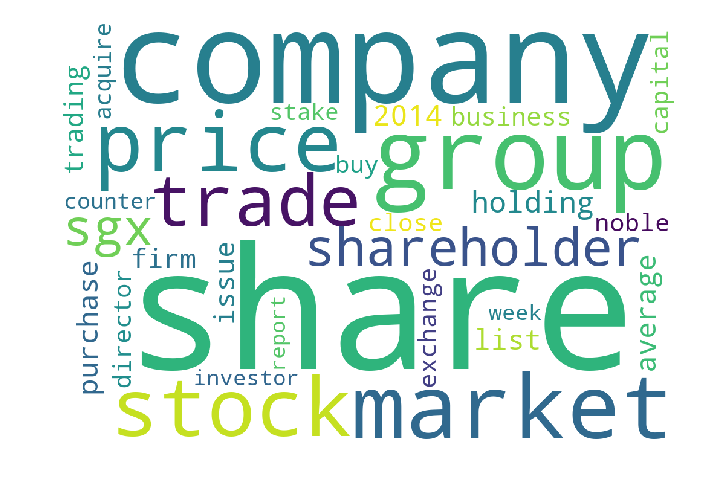



THE TOP 30 WORDS FOR TOPIC #2
['company', 'expect', 'oil', 'rise', 'dollar', 'equity', 'month', 'risk', 'week', 'economy', 'high', 'interest', 'report', 'low', 'asset', 'global', 'time', 'fund', 'bond', 'china', 'growth', 'financial', 'investment', 'investor', 'billion', 'stock', 'price', 'rate', 'bank', 'market']


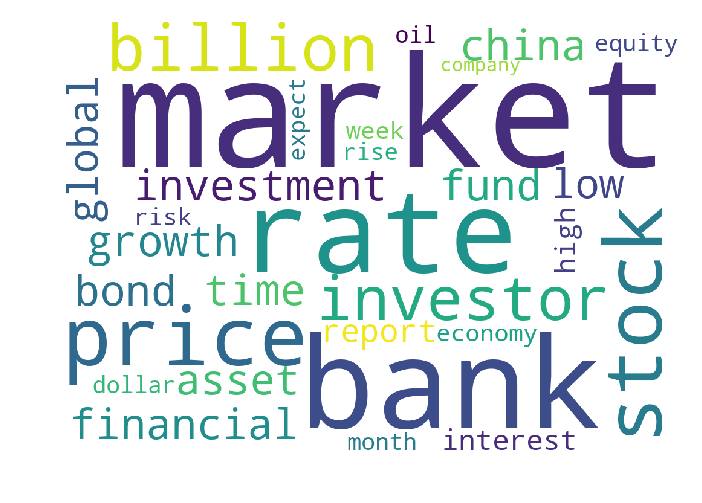



THE TOP 30 WORDS FOR TOPIC #3
['global', 'build', 'development', 'sector', 'design', 'provide', 'world', 'ship', 'management', 'project', 'cost', 'asia', 'add', 'market', 'service', 'develop', 'programme', 'time', 'need', 'work', 'system', 'product', 'customer', 'use', 'business', 'company', 'new', 'technology', 'energy', 'industry']


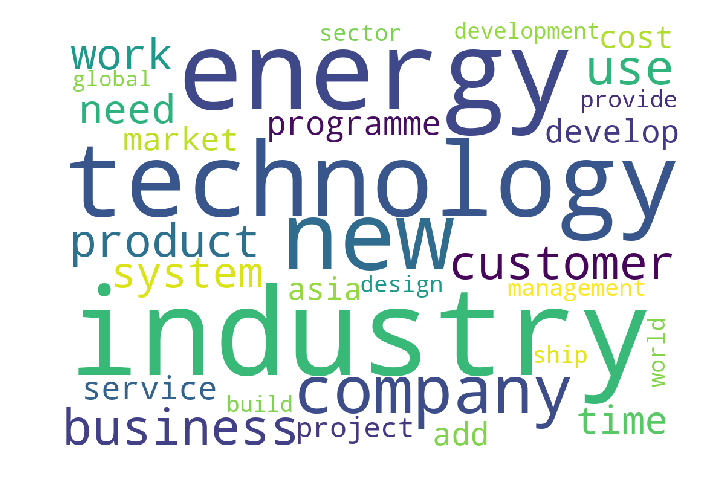



THE TOP 30 WORDS FOR TOPIC #4
['international', 'include', 'big', 'price', 'information publish', 'publish', 'base', 'board', 'corporate', 'coe', 'management', 'use', 'customer', 'work', 'market', 'china', 'financial', 'high', 'time', 'good', 'director', 'asia', 'bank', 'group', 'car', 'information', 'new', 'service', 'business', 'company']


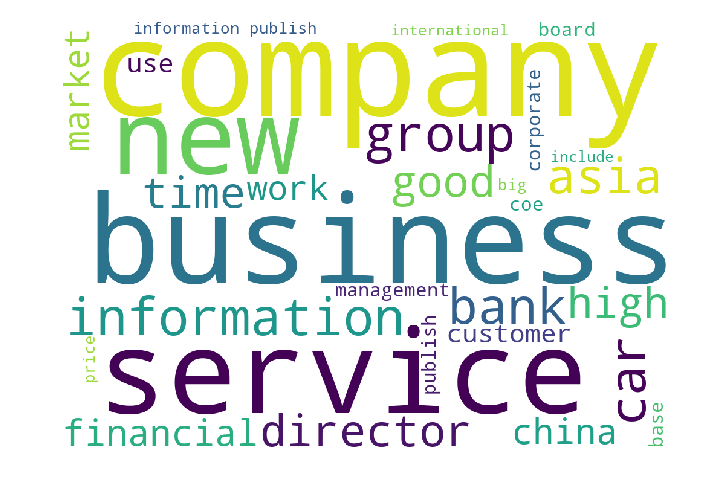



THE TOP 30 WORDS FOR TOPIC #5
['net profit', 'continue', 'cost', 'earning', 'business', 'remain', 'sale', 'ago', '2014', 'billion', 'property', 'increase', 'low', 'market', 'reit', 'share', 'fall', 'end', '2015', 'high', 'rise', 'month', 'expect', 'profit', 'group', 'growth', 'net', 'revenue', 'price', 'quarter']


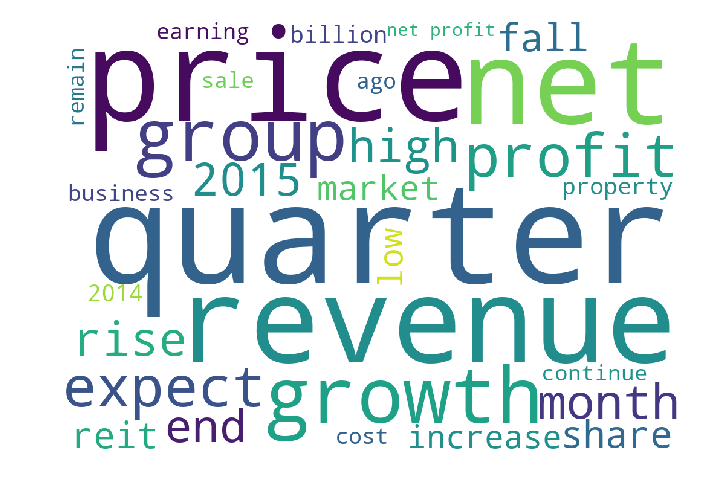



THE TOP 30 WORDS FOR TOPIC #6
['service', 'productivity', 'change', 'future', 'sme', 'job', 'industry', 'high', 'people', 'market', 'work', 'support', 'singaporean', 'worker', 'good', 'continue', 'economic', 'time', 'sector', 'economy', 'country', 'minister', 'help', 'growth', 'need', 'new', 'government', 'lee', 'company', 'business']


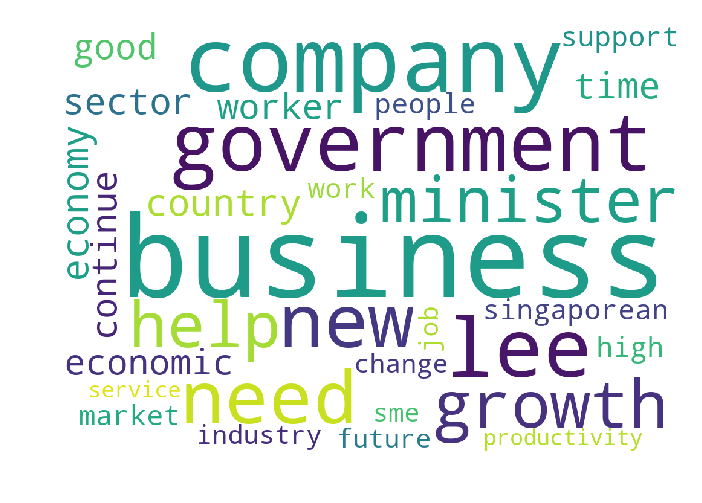



THE TOP 30 WORDS FOR TOPIC #7
['find', 'local', 'include', 'place', 'brand', 'way', 'world', 'start', 'use', 'artist', 'wine', 'look', 'know', 'play', 'old', 'open', 'day', 'design', 'want', 'people', 'come', 'food', 'chef', 'restaurant', 'new', 'time', 'good', 'work', 'like', 'art']


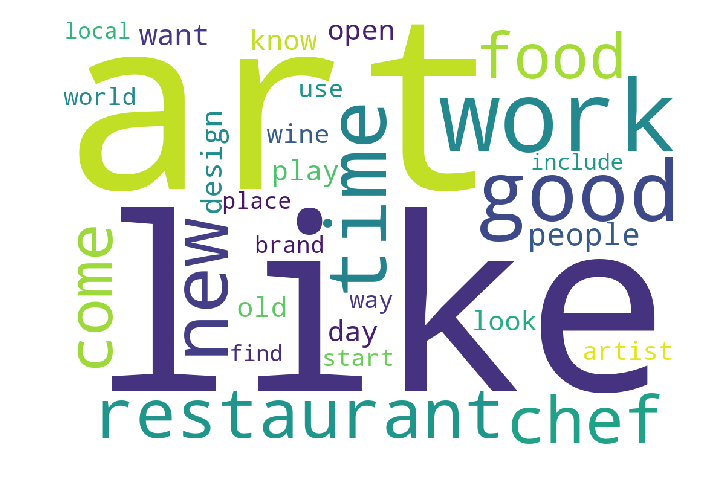



THE TOP 30 WORDS FOR TOPIC #8
['launch', 'sq ft', 'ft', 'month', 'building', 'psf', 'buyer', 'estate', 'space', 'private', 'party', 'home', 'sq', 'group', 'sell', 'high', 'residential', 'area', 'developer', 'sale', 'office', 'new', 'site', 'market', 'development', 'land', 'project', 'price', 'unit', 'property']


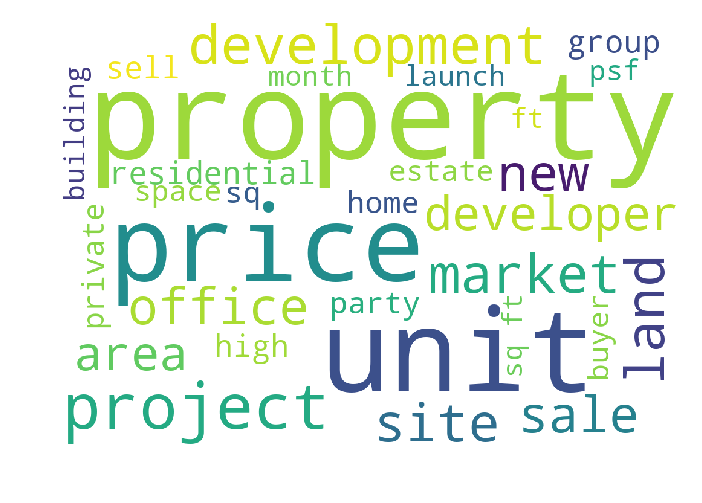



THE TOP 30 WORDS FOR TOPIC #9
['help', 'partner', 'group', 'country', 'team', 'development', 'need', 'base', 'product', 'network', 'region', 'startup', 'use', 'platform', 'customer', 'global', 'work', 'include', 'time', 'world', 'add', 'city', 'datum', 'technology', 'market', 'new', 'service', 'asia', 'business', 'company']


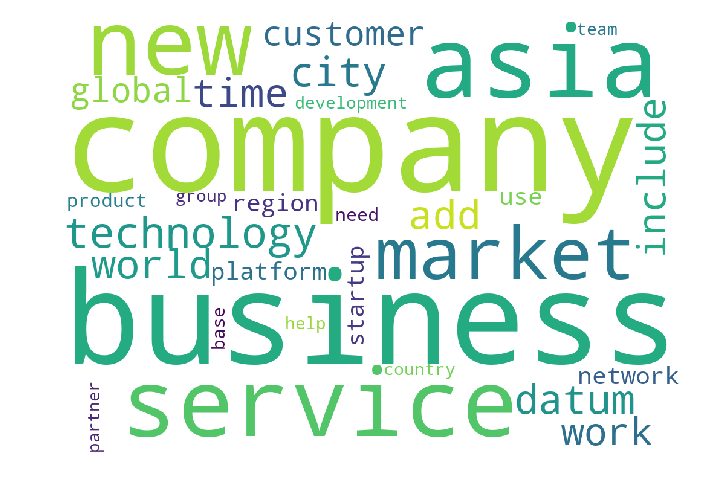



THE TOP 30 WORDS FOR TOPIC #10
['international', 'south', 'people', 'republican', 'lead', 'member', 'asian', 'issue', 'party', 'leader', 'asean', 'japanese', 'time', 'asia', 'chinese', 'minister', 'political', 'new', 'economy', 'american', 'world', 'policy', 'president', 'trade', 'government', 'state', 'economic', 'country', 'japan', 'china']


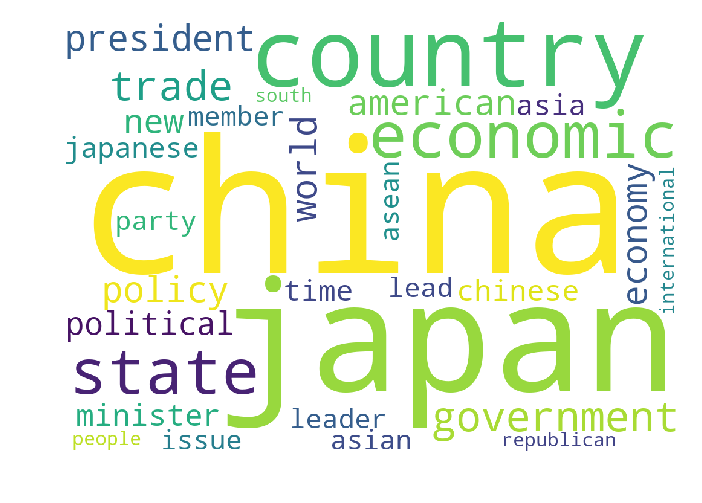





Forming document term matrix for 2016...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2016...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2016 #####


THE TOP 30 WORDS FOR TOPIC #1
['day', 'insurance', 'financial', 'plan', 'economy', 'global', 'life', 'insurer', 'win', 'remain', 'leave', 'high', 'energy', 'economic', 'car', 'european', 'people', 'country', 'point', 'come', 'government', 'good', 'brexit', 'world', 'market', 'uk', 'new', 'eu', 'business', 'time']


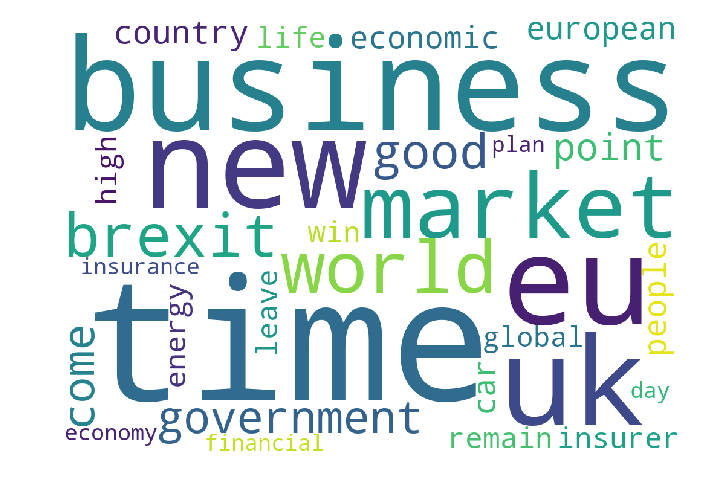



THE TOP 30 WORDS FOR TOPIC #2
['end', 'week', 'report', 'net', 'trading', 'time', 'expect', 'shareholder', 'business', 'sgx', 'revenue', 'firm', 'average', 'profit', 'billion', 'low', 'high', 'fall', 'rise', 'quarter', 'growth', 'month', '2015', 'trade', 'group', 'stock', 'company', 'price', 'market', 'share']


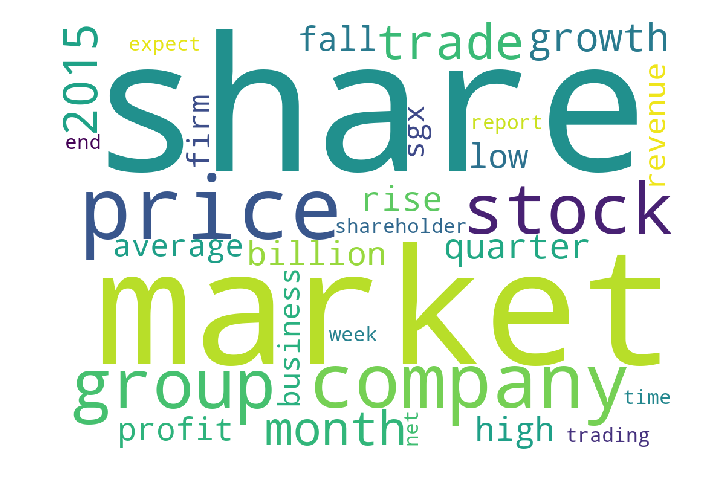



THE TOP 30 WORDS FOR TOPIC #3
['private', 'minister', 'sector', 'court', 'company', '2015', 'charge', 'malaysia', 'authority', 'mas', 'include', 'time', 'state', 'investigation', 'pay', 'money', 'transaction', 'public', 'low', 'account', 'government', 'service', 'deal', 'financial', '1mdb', 'investment', 'report', 'fund', 'bank', 'billion']


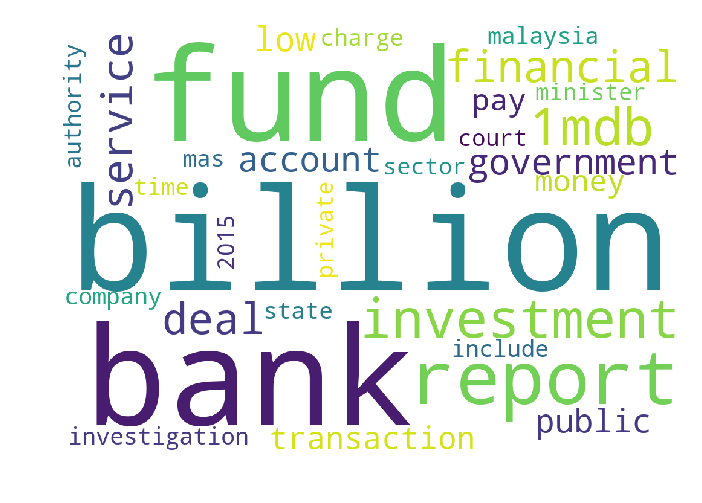



THE TOP 30 WORDS FOR TOPIC #4
['japanese', 'interest rate', 'fiscal', 'interest', 'company', 'investment', 'risk', 'currency', 'investor', 'country', 'need', 'report', 'yen', 'time', 'central bank', 'world', 'monetary', 'global', 'china', 'central', 'government', 'economic', 'financial', 'growth', 'rate', 'japan', 'policy', 'economy', 'market', 'bank']


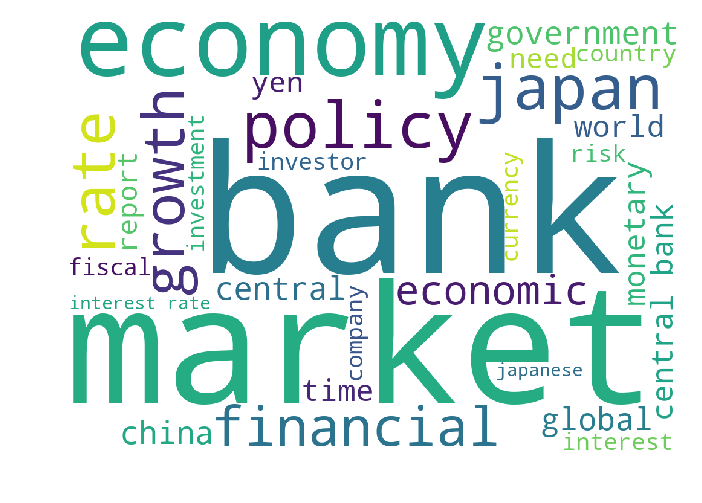



THE TOP 30 WORDS FOR TOPIC #5
['development', 'end', 'quarter', 'income', 'net', 'value', 'new', 'low', 'unit', '2016', 'bank', 'investor', 'fund', 'project', 'business', 'trust', 'expect', 'bond', 'company', 'rate', 'billion', 'high', 'oil', 'group', 'investment', 'reit', 'asset', 'property', 'price', 'market']


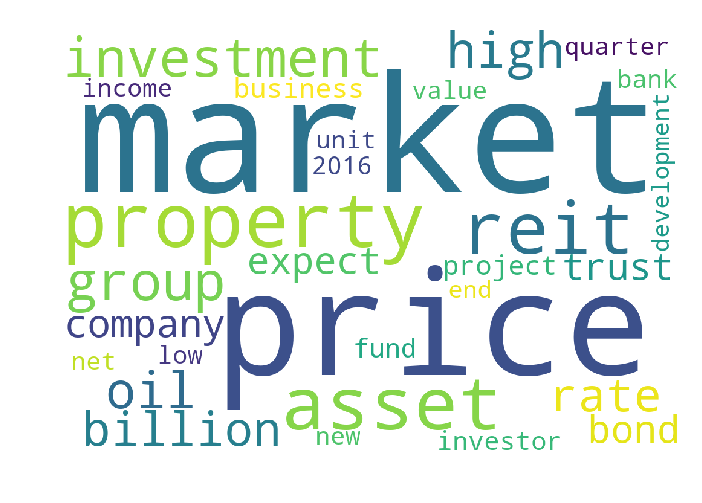



THE TOP 30 WORDS FOR TOPIC #6
['foreign', 'donald', 'come', 'region', 'east', 'business', 'policy', 'chinese', 'win', 'clinton', 'candidate', 'south', 'election', 'include', 'world', 'time', 'japan', 'political', 'asia', 'economic', 'republican', 'american', 'presidential', 'new', 'trade', 'state', 'country', 'president', 'trump', 'china']


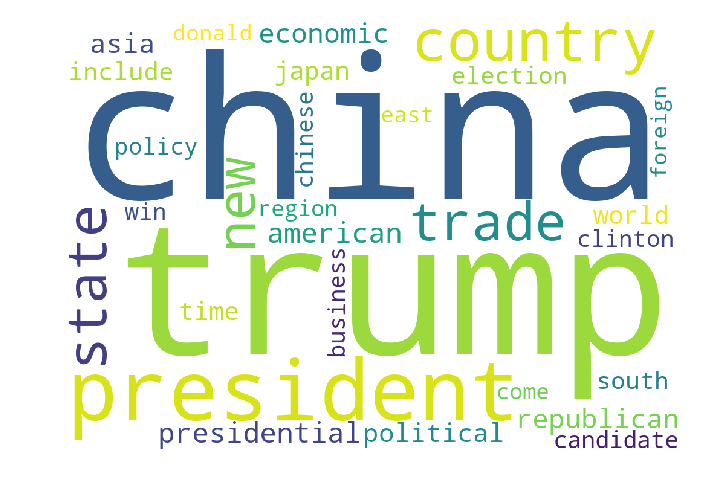



THE TOP 30 WORDS FOR TOPIC #7
['government', 'group', 'consumer', 'platform', 'high', 'payment', 'base', 'innovation', 'growth', 'firm', 'work', 'add', 'help', 'sector', 'financial', 'use', 'startup', 'industry', 'sme', 'need', 'asia', 'time', 'technology', 'customer', 'market', 'service', 'new', 'bank', 'company', 'business']


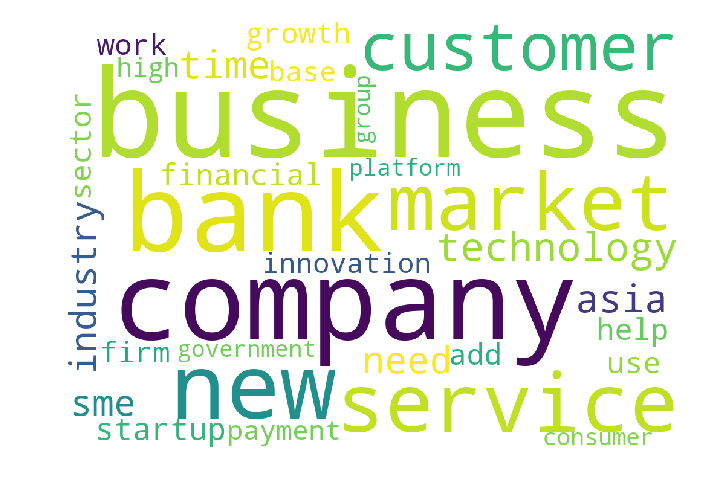



THE TOP 30 WORDS FOR TOPIC #8
['film', 'company', 'way', 'find', 'play', 'local', 'include', 'home', 'brand', 'people', 'start', 'day', 'open', 'know', 'design', 'look', 'old', 'wine', 'want', 'art', 'use', 'come', 'chef', 'restaurant', 'time', 'work', 'food', 'good', 'new', 'like']


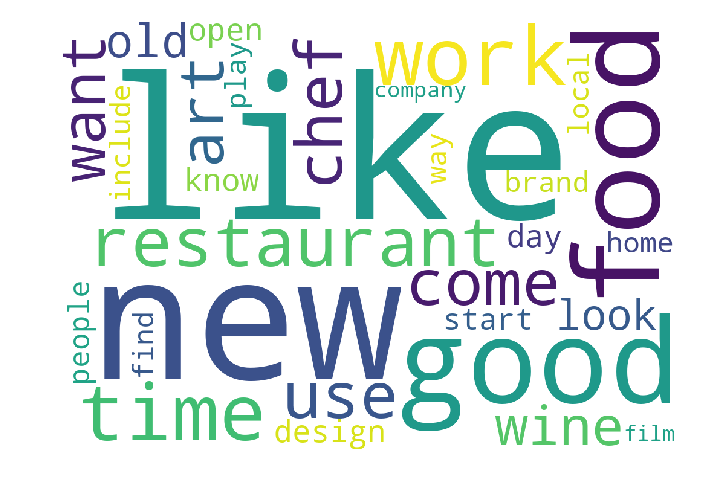



THE TOP 30 WORDS FOR TOPIC #9
['social', 'asia', 'management', 'manage', 'add', 'lee', 'develop', 'organisation', 'provide', 'director', 'world', 'datum', 'way', 'change', 'build', 'security', 'use', 'good', 'system', 'help', 'service', 'time', 'industry', 'people', 'new', 'technology', 'need', 'work', 'company', 'business']


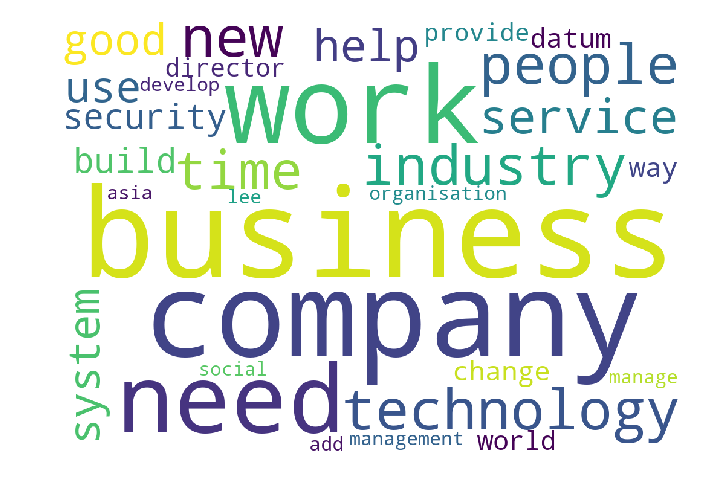



THE TOP 30 WORDS FOR TOPIC #10
['art', 'sq ft', 'ft', 'director', 'time', 'development', 'space', 'car', 'psf', 'road', 'sq', 'month', 'sell', 'residential', 'area', 'high', 'buyer', 'private', 'developer', 'home', 'launch', 'land', 'site', 'sale', 'project', 'market', 'new', 'property', 'unit', 'price']


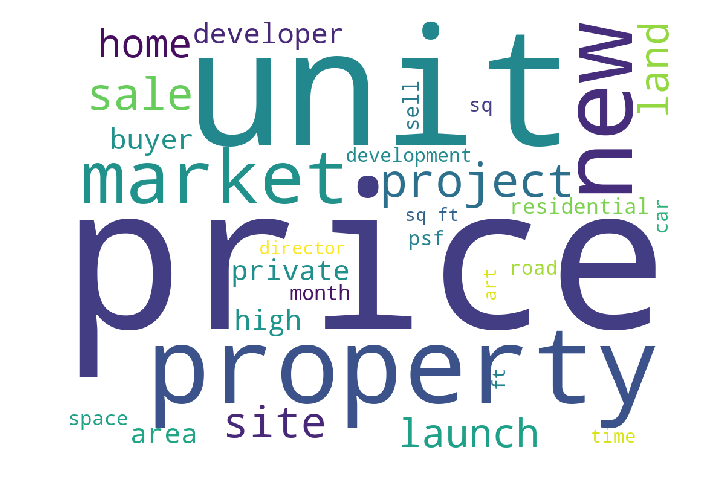





Forming document term matrix for 2017...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2017...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2017 #####


THE TOP 30 WORDS FOR TOPIC #1
['month', 'home', 'psf', 'building', 'lease', 'sq ft', 'ft', 'private', 'expect', 'high', 'estate', 'quarter', 'space', 'new', 'sq', 'project', 'residential', 'reit', 'hotel', 'office', 'area', 'developer', 'market', 'development', 'sale', 'land', 'site', 'price', 'unit', 'property']


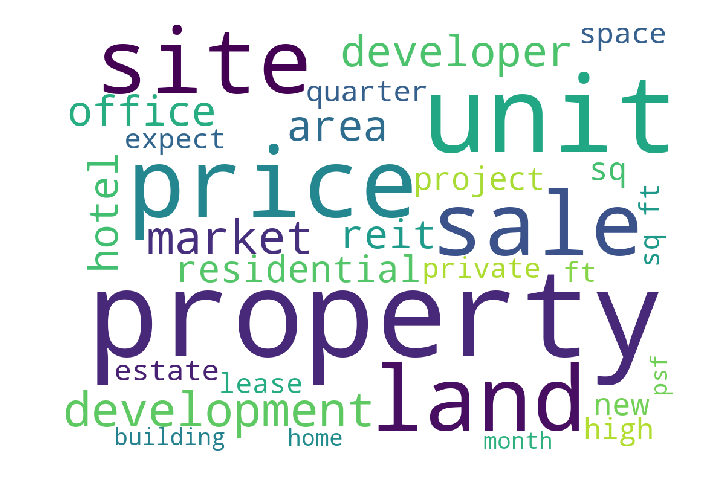



THE TOP 30 WORDS FOR TOPIC #2
['firm', 'sector', 'report', 'increase', 'expect', 'earning', 'bank', 'asset', 'value', 'low', 'rise', 'investment', 'end', 'month', '2017', 'stock', '2016', 'profit', 'high', 'growth', 'revenue', 'net', 'business', 'quarter', 'price', 'billion', 'market', 'group', 'company', 'share']


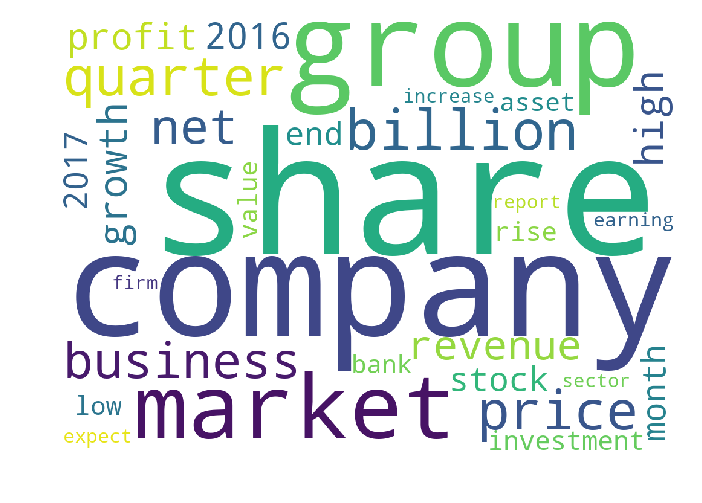



THE TOP 30 WORDS FOR TOPIC #3
['management', 'future', 'programme', 'people', 'solution', 'payment', 'sector', 'change', 'development', 'support', 'datum', 'customer', 'provide', 'innovation', 'system', 'financial', 'time', 'bank', 'digital', 'government', 'help', 'service', 'use', 'industry', 'new', 'work', 'need', 'technology', 'company', 'business']


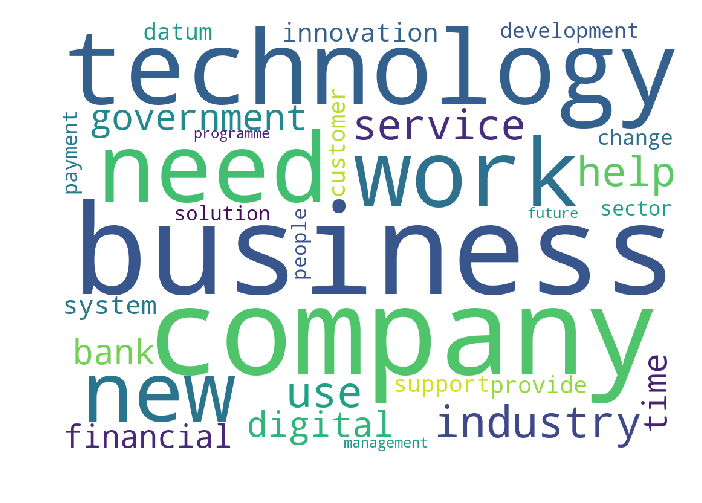



THE TOP 30 WORDS FOR TOPIC #4
['brand', 'use', 'house', 'country', 'need', 'find', 'life', 'include', 'old', 'start', 'play', 'thing', 'big', 'design', 'think', 'look', 'day', 'way', 'know', 'want', 'art', 'business', 'come', 'good', 'world', 'people', 'new', 'work', 'like', 'time']


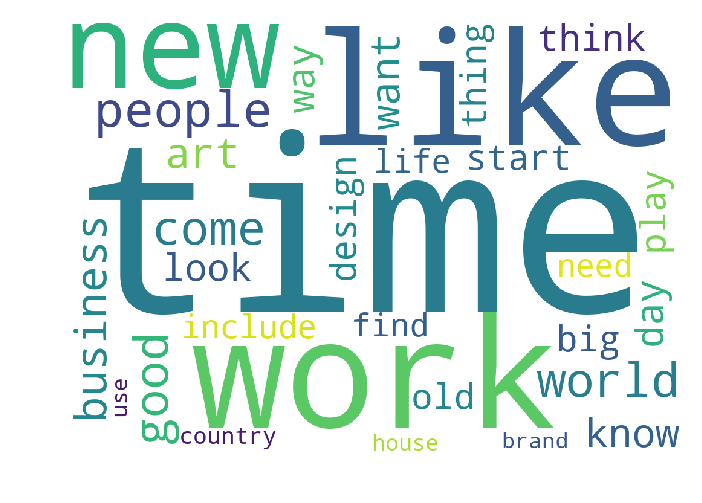



THE TOP 30 WORDS FOR TOPIC #5
['project', 'cat', 'home', 'sale', 'good', 'kmh', 'company', 'agent', 'sell', 'big', 'premium', 'unit', 'second', 'speed', 'drive', 'high', 'investor', 'buyer', 'month', 'sport', 'time', 'model', 'engine', 'vehicle', 'coe', 'price', 'new', 'property', 'market', 'car']


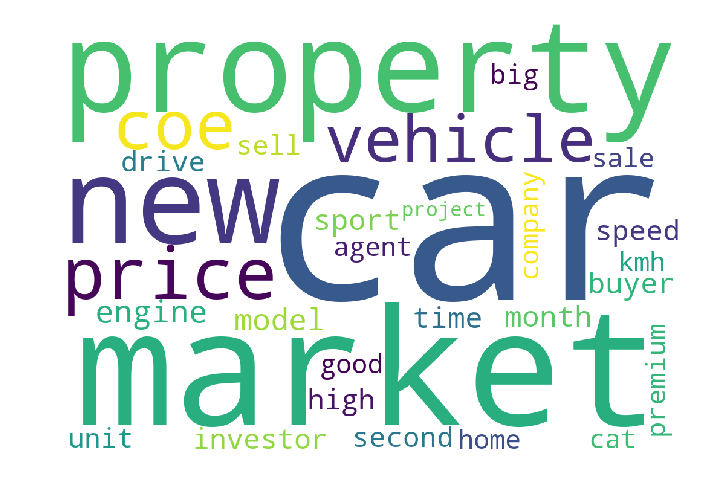



THE TOP 30 WORDS FOR TOPIC #6
['demand', 'come', 'include', 'need', 'technology', 'port', 'increase', 'work', 'country', 'large', 'ship', 'grow', 'world', 'group', 'cost', 'region', 'high', 'energy', 'use', 'add', 'industry', 'global', 'time', 'customer', 'business', 'new', 'company', 'asia', 'service', 'market']


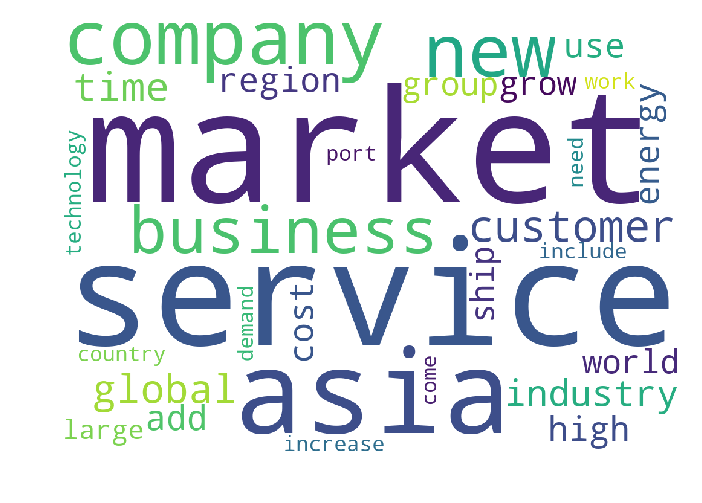



THE TOP 30 WORDS FOR TOPIC #7
['expect', 'index', 'low', 'month', 'point', 'fed', 'come', 'week', 'inflation', 'debt', 'dollar', 'hike', 'interest', 'time', 'like', 'new', 'wine', 'rise', 'interest rate', 'stock', 'good', 'high', 'bond', 'food', 'price', 'chef', 'restaurant', 'bank', 'rate', 'market']


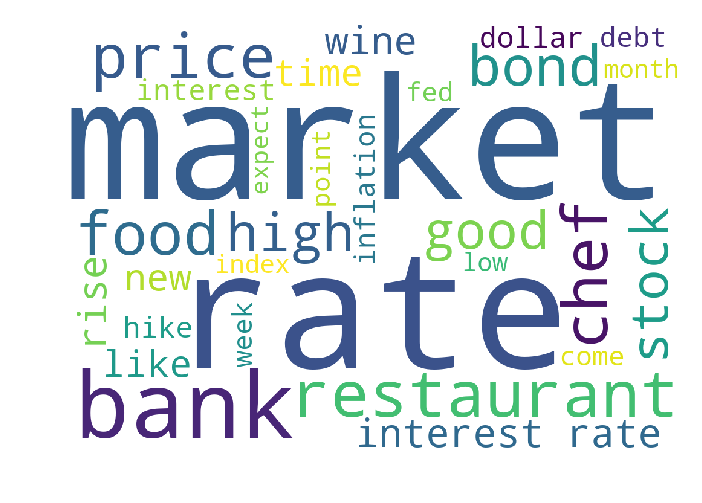



THE TOP 30 WORDS FOR TOPIC #8
['issue', 'note', 'time', 'list', 'capital', 'equity', 'buy', 'financial', 'reit', 'management', 'hold', 'target price', 'close', 'debt', 'information publish', 'publish', 'target', 'fund', 'new', 'trust', 'asset', 'business', 'market', 'information', 'share', 'investment', 'investor', 'price', 'group', 'company']


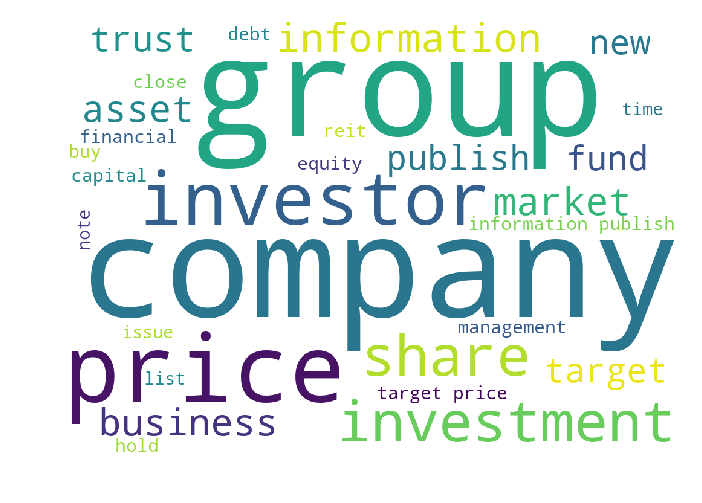



THE TOP 30 WORDS FOR TOPIC #9
['business', 'service', 'tender', 'city', 'team', 'launch', 'court', 'add', 'work', 'club', 'green', 'market', 'line', 'building', 'high', 'use', 'price', 'construction', 'land', 'golf', 'china', 'sale', 'time', 'company', 'development', 'new', 'water', 'watch', 'group', 'project']


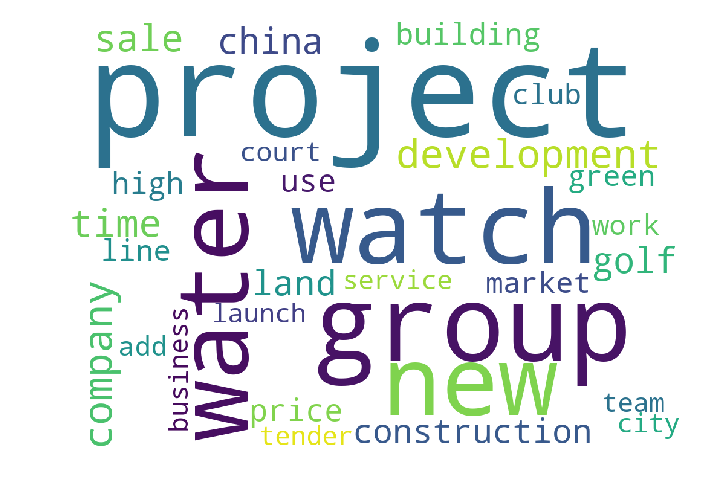



THE TOP 30 WORDS FOR TOPIC #10
['business', 'financial', 'report', 'bank', 'election', 'time', 'world', 'government', 'foreign', 'chinese', 'new', 'investment', 'week', 'minister', 'north', 'korea', 'global', 'growth', 'state', 'asia', 'economy', 'country', 'japan', 'policy', 'president', 'market', 'economic', 'trade', 'trump', 'china']


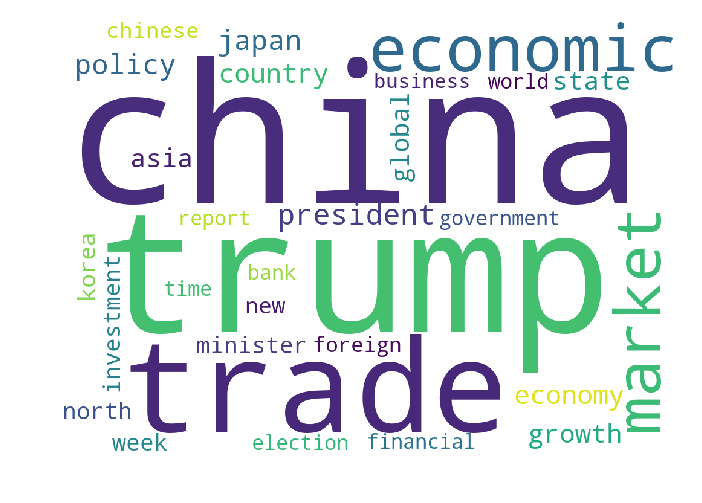





Forming document term matrix for 2018...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2018...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2018 #####


THE TOP 30 WORDS FOR TOPIC #1
['airport', 'launch', 'datum', 'platform', 'firm', 'industry', 'come', 'product', 'airline', 'include', 'cost', 'south east', 'grow', 'south', 'consumer', 'use', 'east', 'payment', 'customer', 'growth', 'add', 'group', 'grab', 'time', 'asia', 'company', 'market', 'new', 'service', 'business']


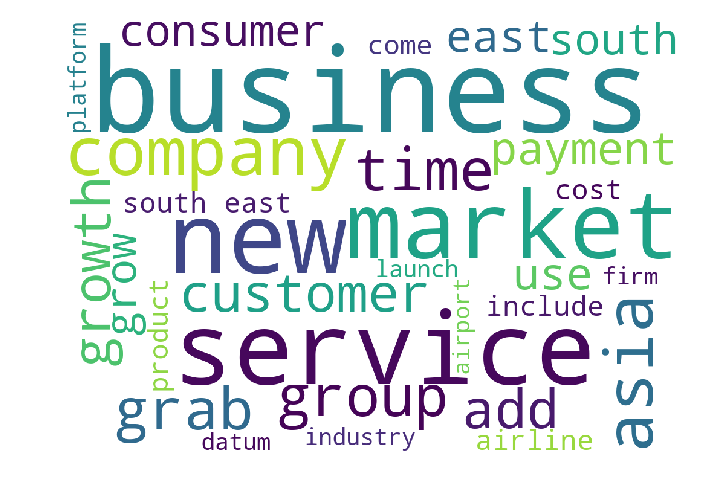



THE TOP 30 WORDS FOR TOPIC #2
['chairman', 'malaysia', 'propose', 'governance', 'plan', 'court', 'restructuring', 'firm', 'issue', 'independent', 'management', 'hold', 'financial', 'corporate', 'executive', 'market', 'time', 'exchange', 'new', 'investor', 'noble', 'sgx', 'list', 'director', 'business', 'share', 'board', 'group', 'shareholder', 'company']


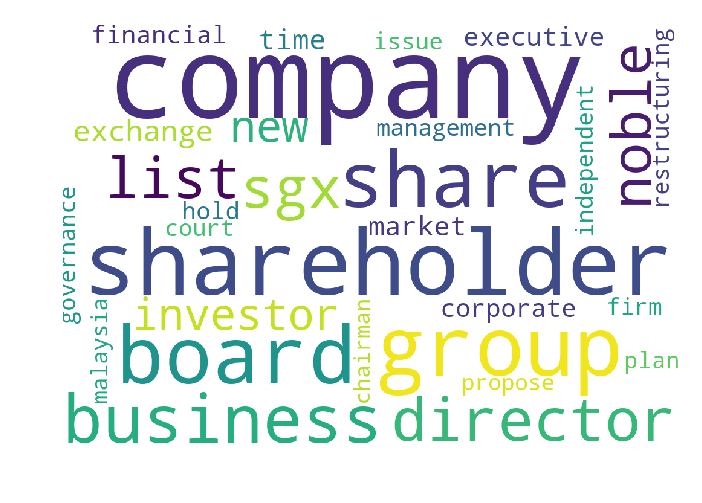



THE TOP 30 WORDS FOR TOPIC #3
['equity', 'capital', 'end', 'economy', 'index', 'note', 'risk', 'business', 'month', 'expect', 'asia', 'time', 'financial', 'rise', 'fund', 'company', 'rate', 'global', 'high', 'price', 'investment', 'investor', 'stock', 'growth', 'billion', 'china', 'share', 'trade', 'bank', 'market']


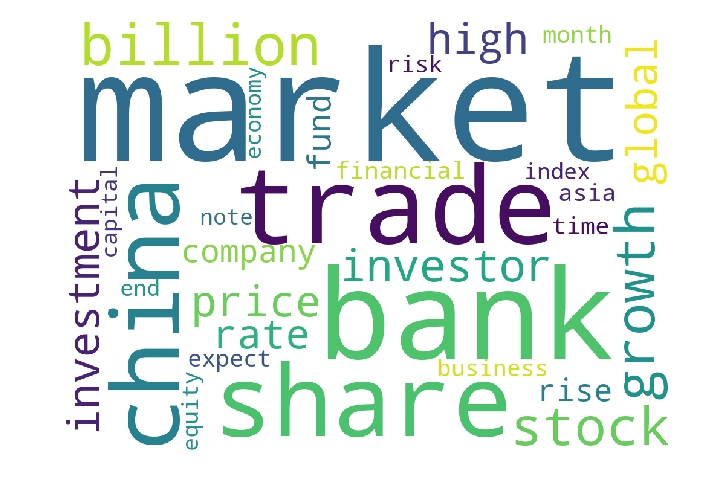



THE TOP 30 WORDS FOR TOPIC #4
['big', 'set', 'thing', 'serve', 'experience', 'think', 'find', 'star', 'start', 'way', 'know', 'old', 'include', 'world', 'work', 'open', 'use', 'china', 'want', 'come', 'people', 'day', 'chinese', 'good', 'new', 'time', 'like', 'chef', 'food', 'restaurant']


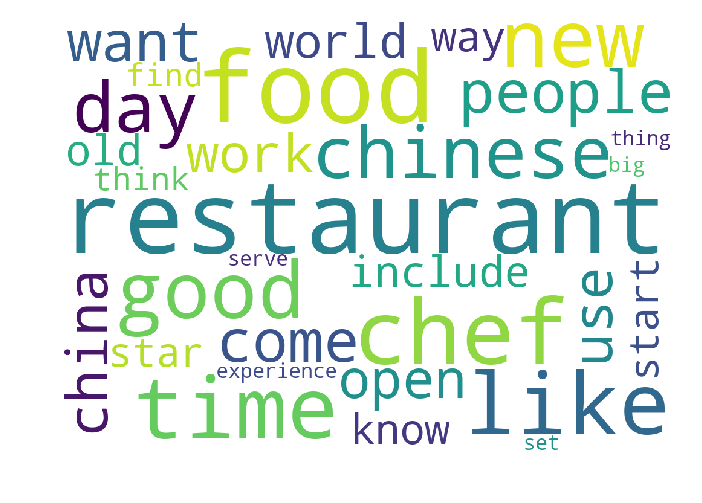



THE TOP 30 WORDS FOR TOPIC #5
['play', 'place', 'find', 'big', 'old', 'include', 'feature', 'feel', 'start', 'day', 'know', 'way', 'create', 'space', 'home', 'want', 'come', 'people', 'look', 'use', 'world', 'brand', 'good', 'art', 'time', 'car', 'new', 'design', 'work', 'like']


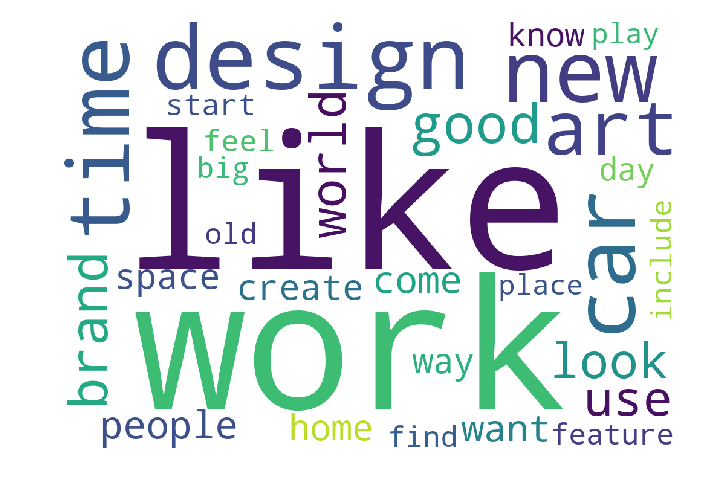



THE TOP 30 WORDS FOR TOPIC #6
['growth', 'white', 'use', 'believe', 'time', 'investment', 'washington', 'new', 'market', 'president trump', 'political', 'high', 'house', 'expect', 'eu', 'car', 'buy', 'china', 'deal', 'american', 'target price', 'information publish', 'close', 'publish', 'target', 'trade', 'president', 'information', 'price', 'trump']


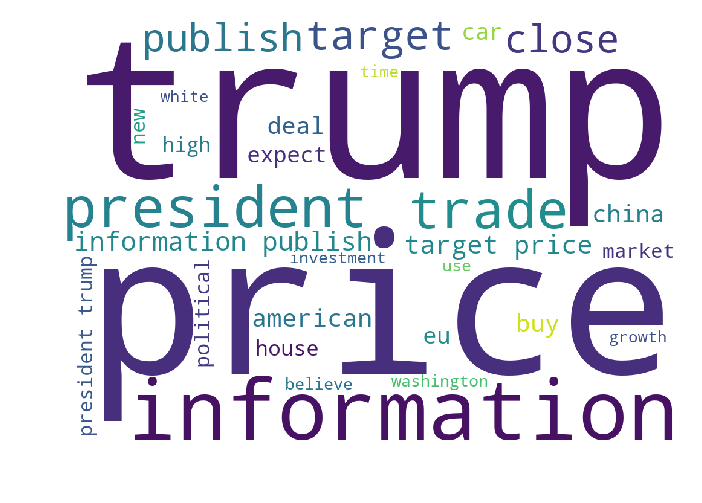



THE TOP 30 WORDS FOR TOPIC #7
['develop', 'include', 'customer', 'provide', 'good', 'china', 'global', 'change', 'asia', 'solution', 'development', 'datum', 'world', 'system', 'time', 'people', 'government', 'firm', 'country', 'digital', 'use', 'help', 'service', 'industry', 'need', 'new', 'work', 'technology', 'business', 'company']


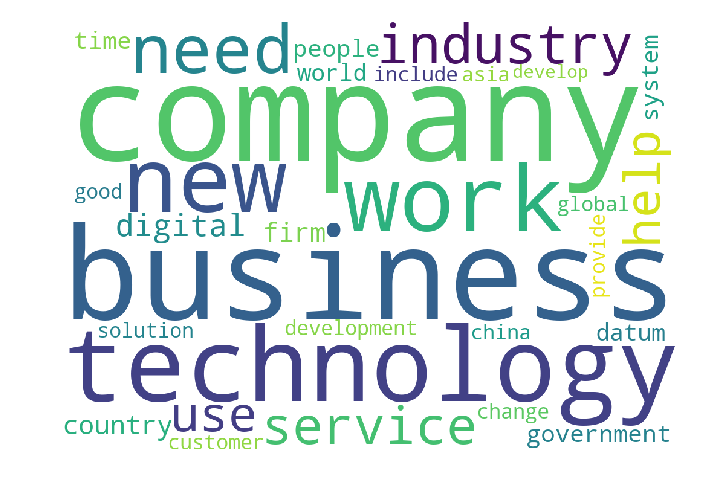



THE TOP 30 WORDS FOR TOPIC #8
['remain', 'private', 'rent', 'rate', 'fall', 'period', 'business', 'office', 'end', 'growth', 'ago', 'sale', 'share', 'low', 'new', '2017', 'unit', 'expect', 'profit', 'market', 'rise', '2018', 'high', 'increase', 'month', 'net', 'revenue', 'property', 'price', 'quarter']


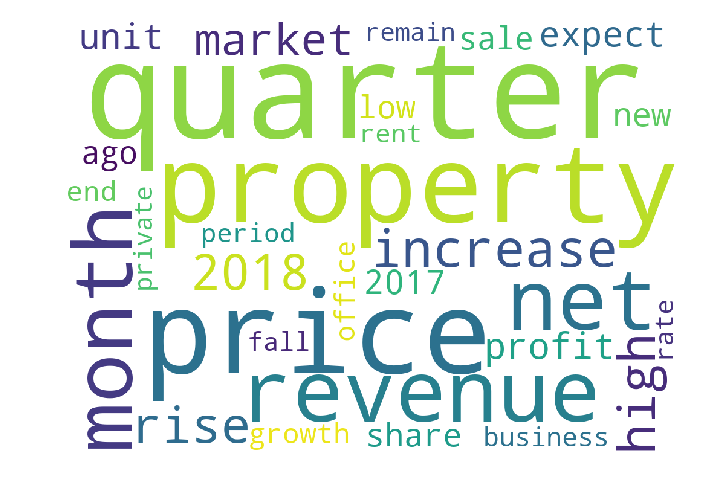



THE TOP 30 WORDS FOR TOPIC #9
['psf', 'expect', 'close', 'acquisition', 'launch', 'real estate', 'road', 'sq ft', 'ft', 'new', 'investment', 'asset', 'hotel', 'high', 'estate', 'sq', 'market', 'area', 'residential', 'reit', 'price', 'developer', 'group', 'project', 'land', 'site', 'sale', 'development', 'unit', 'property']


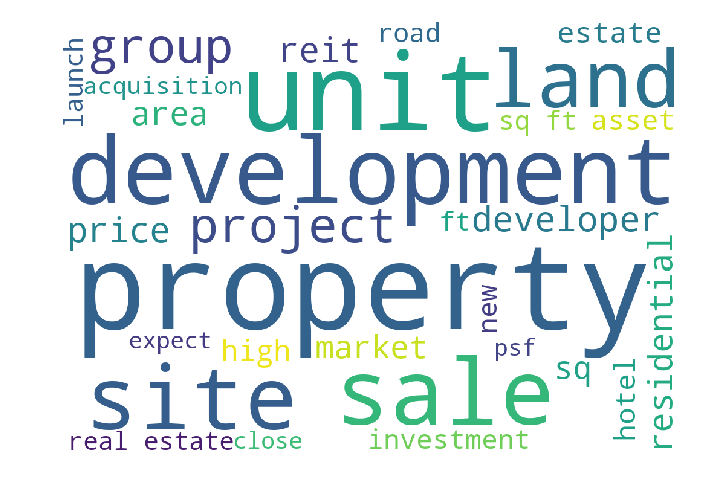



THE TOP 30 WORDS FOR TOPIC #10
['fund', 'include', 'money', 'people', 'work', 'dial', 'day', '2018', 'brand', 'dbs', 'high', 'come', 'event', 'case', 'wealth', 'raise', 'tax', 'child', 'swiss', 'gold', 'movement', 'private', 'charity', 'banking', 'client', 'timepiece', 'time', 'new', 'bank', 'watch']


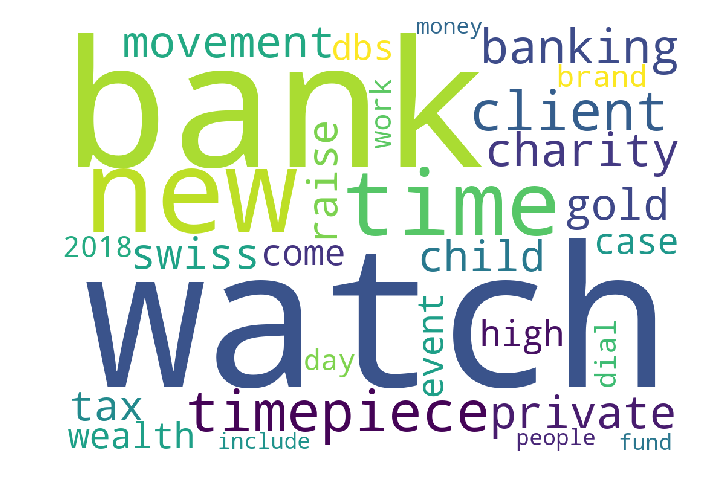





Forming document term matrix for 2019...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2019...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2019 #####


THE TOP 30 WORDS FOR TOPIC #1
['ago', 'net profit', 'result', 'loss', '31', 'acquisition', 'investment', 'end', 'income', '2019', 'close', 'unit', 'growth', 'earning', 'billion', '2018', 'business', 'expect', 'trust', 'asset', 'high', 'price', 'reit', 'profit', 'property', 'quarter', 'revenue', 'group', 'share', 'net']


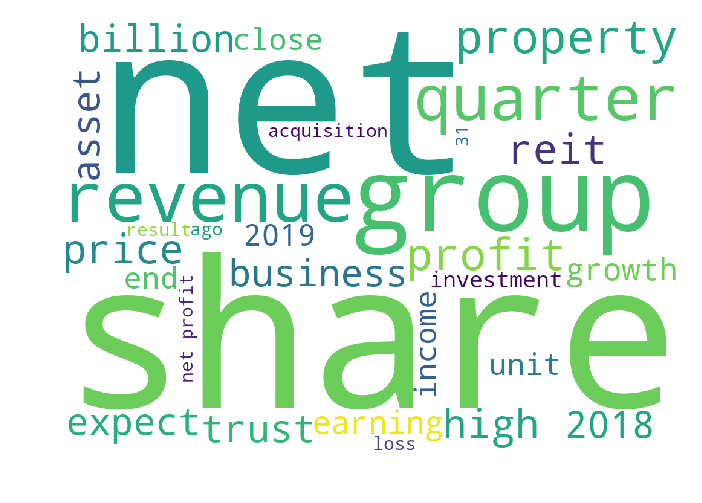



THE TOP 30 WORDS FOR TOPIC #2
['ft', 'director', 'list', 'executive', 'private', 'high', 'launch', 'business', '2018', 'sq', 'buyer', 'new', 'area', 'offer', 'sell', 'residential', 'developer', 'month', 'land', 'group', 'site', 'company', 'development', 'project', 'share', 'market', 'sale', 'unit', 'property', 'price']


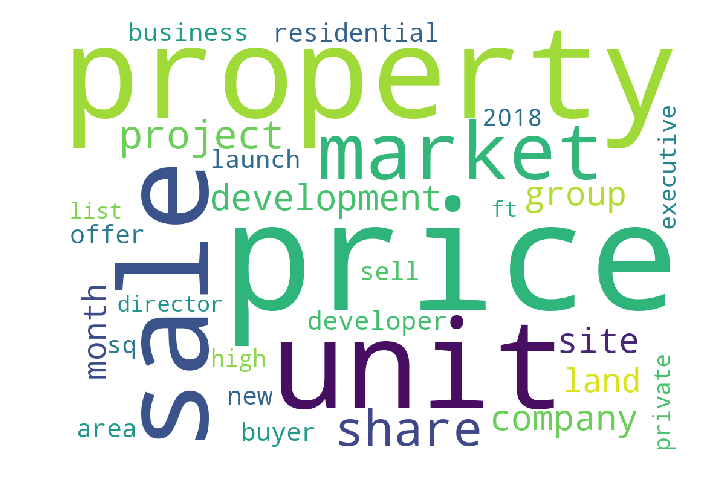



THE TOP 30 WORDS FOR TOPIC #3
['general', 'business', 'film', 'like', 'sgx', 'product', 'plastic', 'director', 'food', 'fair', 'medical', 'look', 'come', 'price', 'dr', 'life', 'day', 'work', 'artist', 'share', 'use', 'include', 'world', 'waste', 'company', 'time', 'good', 'new', 'offer', 'art']


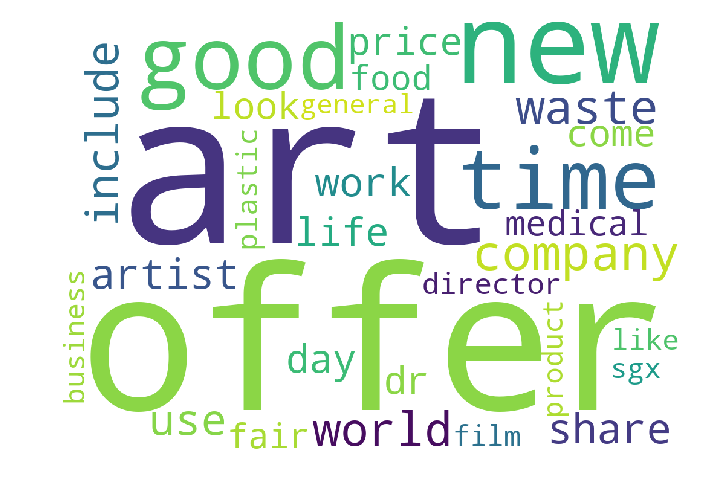



THE TOP 30 WORDS FOR TOPIC #4
['security', 'plan', 'use', 'trade', 'power', 'sgx', 'american', 'include', 'court', 'business', 'political', 'brexit', 'shareholder', 'state', 'uk', 'new', 'eu', 'share', 'agreement', 'financial', 'party', 'investor', 'issue', 'group', 'time', 'trump', 'president', 'hyflux', 'deal', 'company']


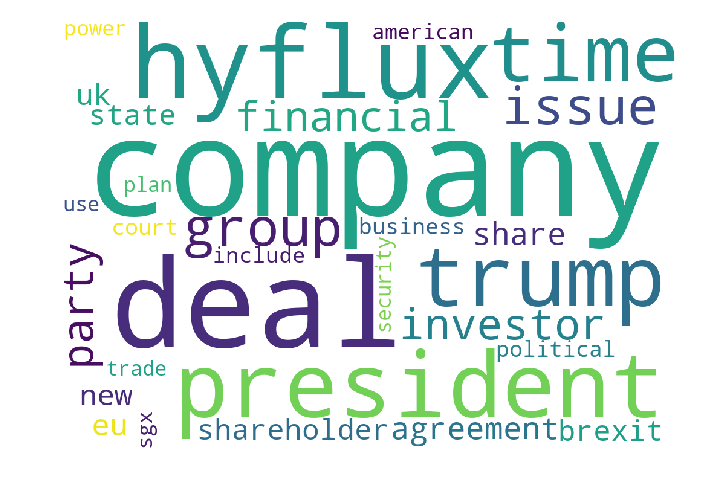



THE TOP 30 WORDS FOR TOPIC #5
['economy', 'point', 'week', 'low', 'end', 'equity', 'asset', 'add', 'share', 'asia', 'reit', 'expect', 'time', 'fund', 'month', 'close', 'index', 'high', 'stock', 'price', 'global', 'rate', 'investment', 'billion', 'bank', 'growth', 'investor', 'china', 'trade', 'market']


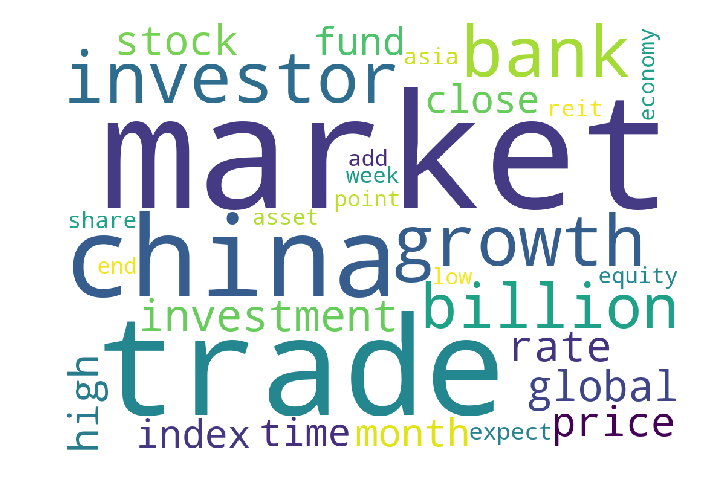



THE TOP 30 WORDS FOR TOPIC #6
['online', 'firm', 'need', 'partner', 'brand', 'investment', 'asia', 'venture', 'financial', 'corporate', 'dbs', 'use', 'banking', 'world', 'consumer', 'product', 'startup', 'platform', 'car', 'digital', 'good', 'time', 'group', 'market', 'new', 'service', 'company', 'business', 'customer', 'bank']


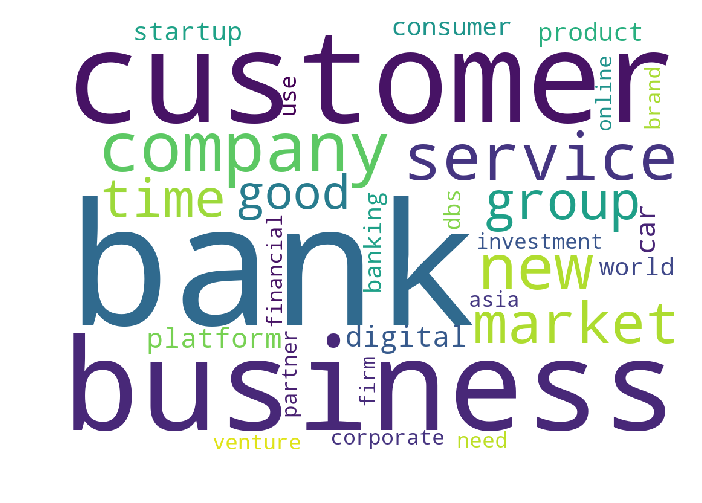



THE TOP 30 WORDS FOR TOPIC #7
['open', 'road', 'dish', 'work', 'kitchen', 'engine', 'home', 'bar', 'menu', 'old', 'feel', 'dining', 'way', 'chinese', 'want', 'time', 'use', 'price', 'look', 'come', 'room', 'flat', 'food', 'car', 'good', 'new', 'like', 'restaurant', 'hotel', 'chef']


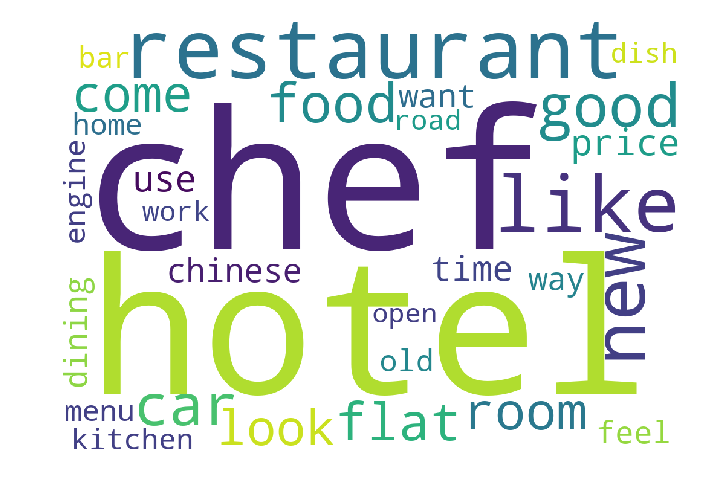



THE TOP 30 WORDS FOR TOPIC #8
['business', 'event', 'run', 'centre', 'find', 'home', 'old', 'play', 'house', 'experience', 'think', 'way', 'include', 'know', 'start', 'space', 'look', 'day', 'come', 'good', 'want', 'open', 'people', 'world', 'like', 'brand', 'design', 'new', 'work', 'time']


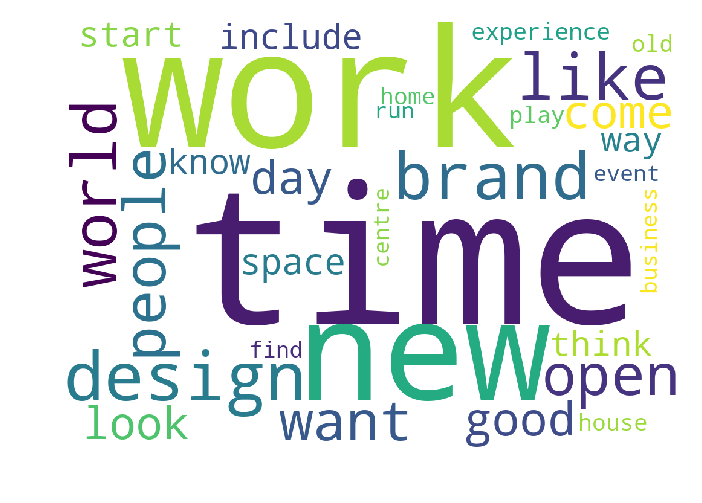



THE TOP 30 WORDS FOR TOPIC #9
['public', 'partner', 'fund', 'provide', 'project', 'people', 'asia', 'country', 'service', 'sector', 'minister', 'support', 'add', 'include', 'tech', 'worker', 'time', 'startup', 'development', 'help', 'firm', 'use', 'industry', 'need', 'government', 'business', 'new', 'work', 'company', 'technology']


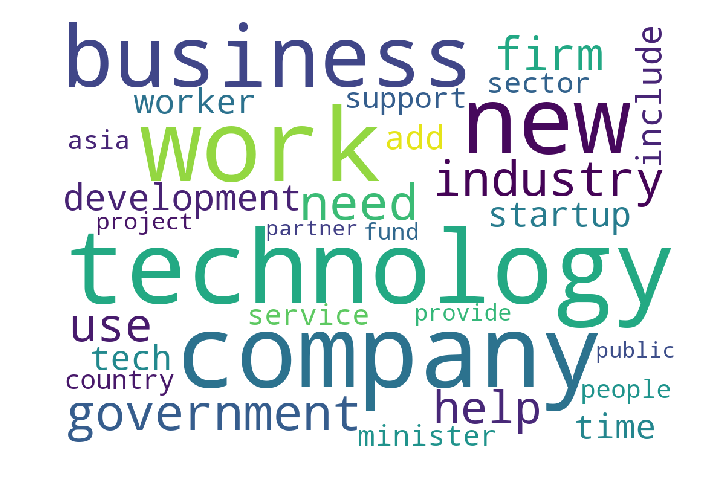



THE TOP 30 WORDS FOR TOPIC #10
['value', 'risk', 'director', 'country', 'culture', 'ceo', 'change', 'good', 'market', 'people', 'growth', 'help', 'economy', 'time', 'industry', 'innovation', 'organisation', 'customer', 'global', 'service', 'datum', 'employee', 'new', 'digital', 'technology', 'asia', 'need', 'work', 'company', 'business']


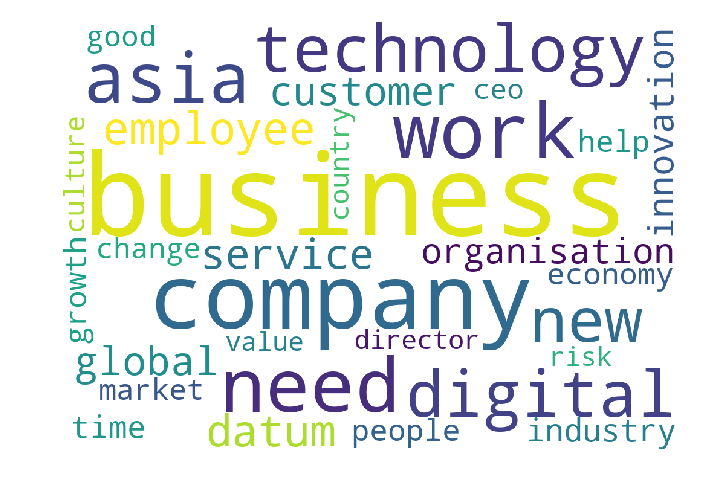

In [110]:
years = [2014, 2015, 2016, 2017, 2018, 2019]
topic_by_year = topic_year(years, 10)

LDA was able to pick out specific topics, such as Donald Trump's election, Brexit, and the 1MDB scandal in 2016, and escalating trade tensions in 2018. There are also perennial topics such as property, investments, food reviews, and car reviews. 

We now have a dictionary of the topics and the top words associated with each topic. Note that the topic numbers make sense only when viewed within the year. For example, 2014 topic 1 is not the same as 2015 topic 1.

In [114]:
print(len(topic_by_year['topics'])) #check if the len is same as number of articles 
topic_by_year['topics'] #this is the topic by year 

49159


array([6., 3., 7., ..., 8., 4., 8.])

In [122]:
bt_df['topic_year'] = topic_by_year['topics'] #form new column for topics 
bt_df['topic_year'] = bt_df['topic_year'].astype(int) #change to int

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [124]:
bt_df.head()

,byline,date,headline,page,text,scores,neg,neu,pos,compound,text_clean,text_lemma,topic_year
0,Helmi Yusof,2014-12-29,Nurturing talent – 10 years and counting,12 - 13,CHILDAID 2104 was a milestone in so many ways....,"{'neg': 0.043, 'neu': 0.821, 'pos': 0.135, 'co...",0.043,0.821,0.135,0.9980,childaid 2104 was a milestone in so many ways ...,childaid 2104 be a milestone in so many way fi...,6
1,R Sivanithy,2014-12-29,Good chance for window-dressing push on STI,7,"STOCKS IN THE near term (that is, this week...","{'neg': 0.092, 'neu': 0.814, 'pos': 0.094, 'co...",0.092,0.814,0.094,0.1046,stocks in the near term that is this week t...,stock in the near term that be this week t...,3
2,Robert Halili,2014-12-29,Directors’ buying down in holiday shortened week,6,INSIDE MARKETS But selling recovers with 12 co...,"{'neg': 0.023, 'neu': 0.842, 'pos': 0.135, 'co...",0.023,0.842,0.135,0.9995,inside markets but selling recovers with 12 co...,inside market but sell recover with 12 company...,7
3,Cai Haoxiang,2014-12-29,Why invest? And how do you do it?,10,MONDAY MULTIPLE Aim for a sustainable stream o...,"{'neg': 0.092, 'neu': 0.81, 'pos': 0.098, 'com...",0.092,0.810,0.098,-0.9206,monday multiple aim for a sustainable stream o...,monday multiple aim for a sustainable stream o...,0
4,Claire Huang,2014-12-29,Correction:,4,IN “Continued smooth sailing a safe bet for no...,"{'neg': 0.062, 'neu': 0.85, 'pos': 0.088, 'com...",0.062,0.850,0.088,0.8446,in continued smooth sailing a safe bet for now...,in continue smooth sail a safe bet for now bt ...,0


#### Save yearly topic words to dataframe and `csv`

In [187]:
{k:v.keys() for k, v in topic_by_year['top_words'].items()} #year as key, topic number as value

{2014: dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 2015: dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 2016: dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 2017: dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 2018: dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 2019: dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])}

In [220]:
tuple_list = []
for item in {k:v.keys() for k, v in topic_by_year['top_words'].items()}.items(): #year as key, topic number as value
    for i in item[1]: #each topic number
        tuple_list.append((item[0], i)) #pair year with topic number as tuple 

len(tuple_list) #check if there are 60 total topics

60

In [229]:
word_list = []
for year in topic_by_year['top_words'].values(): #all topic words with topic number 
    for topic in year.values(): #each topic
        word_list.append(topic)
        
len(word_list)

60

In [256]:
year_word_df = pd.DataFrame.from_dict(dict(zip(tuple_list, word_list)), orient="index")
year_word_df.head()

mobile        board       global          way     director  \
2014 0  1410.232067  1424.729158  1435.356435  1445.736887  1485.425171   
     1          NaN          NaN  1189.099124          NaN          NaN   
     2          NaN          NaN          NaN          NaN          NaN   
     3          NaN          NaN  2341.557512          NaN          NaN   
     4          NaN          NaN          NaN          NaN          NaN   

          financial  development          add      country         good  ...  \
2014 0  1491.016437  1496.321476  1501.203547  1599.102043  1650.161527  ...   
     1          NaN          NaN          NaN  1089.440536          NaN  ...   
     2          NaN          NaN   417.314604   602.902611          NaN  ...   
     3  2333.466880          NaN          NaN  1576.335720          NaN  ...   
     4          NaN   234.144300   175.993241          NaN          NaN  ...   

        bar  menu  dining  room  flat  centre  tech  culture  ceo  employee  
2014 0  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     1  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     2  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     3  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     4  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  

[5 rows x 372 columns]

In [249]:
year_word_df.to_csv(r'../datasets/bt/year_word.csv') #save to csv

In [257]:
year_word_df_test = pd.read_csv('../datasets/bt/year_word.csv', index_col=(0, 1))#test if it loads back properly, use 1st and 2nd column to form multiindex
year_word_df_test.head()

mobile        board       global          way     director  \
2014 0  1410.232067  1424.729158  1435.356435  1445.736887  1485.425171   
     1          NaN          NaN  1189.099124          NaN          NaN   
     2          NaN          NaN          NaN          NaN          NaN   
     3          NaN          NaN  2341.557512          NaN          NaN   
     4          NaN          NaN          NaN          NaN          NaN   

          financial  development          add      country         good  ...  \
2014 0  1491.016437  1496.321476  1501.203547  1599.102043  1650.161527  ...   
     1          NaN          NaN          NaN  1089.440536          NaN  ...   
     2          NaN          NaN   417.314604   602.902611          NaN  ...   
     3  2333.466880          NaN          NaN  1576.335720          NaN  ...   
     4          NaN   234.144300   175.993241          NaN          NaN  ...   

        bar  menu  dining  room  flat  centre  tech  culture  ceo  employee  
2014 0  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     1  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     2  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     3  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  
     4  NaN   NaN     NaN   NaN   NaN     NaN   NaN      NaN  NaN       NaN  

[5 rows x 372 columns]

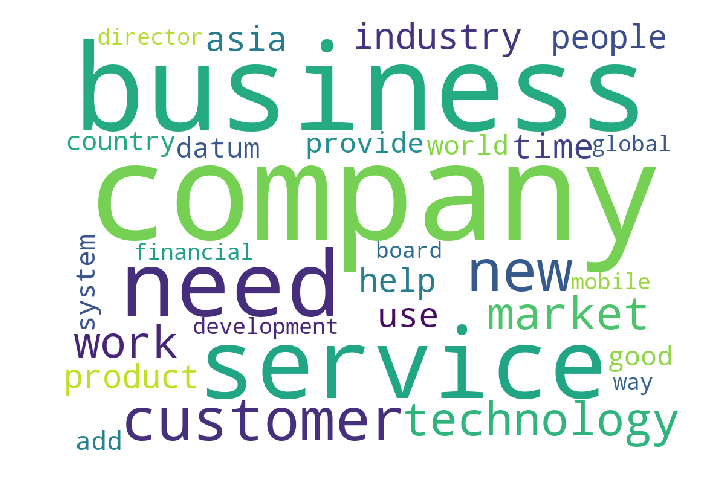

In [258]:
#test making a word cloud from the loaded csv
wc = WordCloud( #instantiate
                background_color="white",
                max_words=2000,
                width=1024,
                height=720)
wc.generate_from_frequencies(year_word_df_test.loc[2014].loc[0].dropna().to_dict()) #make the wordcloud
plt.axis('off')
plt.imshow(wc)#display
plt.show()

#### Save wordclouds

We will now save the wordclouds for display on our Dash dashboard. First, we will create our own custom colour map for the font. 

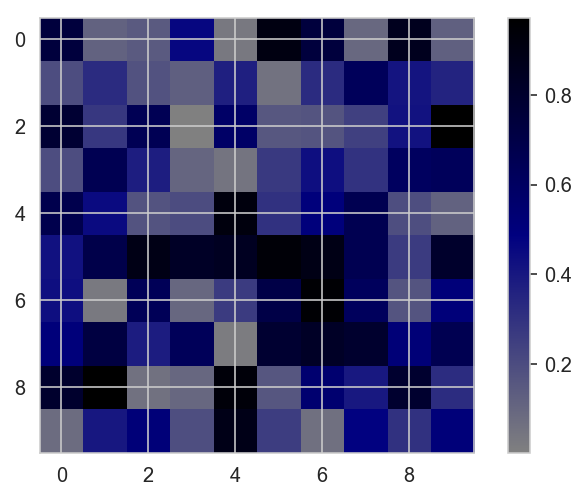

In [224]:
cmap = LinearSegmentedColormap.from_list('mycmap', ['gray', 'navy', 'black']) #enter colours of colourmap here

fig, ax = plt.subplots()
im = ax.imshow(np.random.random((10, 10)), cmap=cmap, interpolation='nearest') #to see how your new colourmap looks
fig.colorbar(im)
plt.show()

In [231]:
#### make a loop to save the word clouds
years = [2014, 2015, 2016, 2017, 2018, 2019]
for year in years: 
    for i in range(10):
        wc = WordCloud( #instantiate
                background_color="white",
                colormap=cmap, #insert custom colour map here
                font_path='../assets/helveticaneue/HelveticaNeue Medium.ttf', #insert custom font
                width=1024,
                height=720)
        wc.generate_from_frequencies(year_word_df_test.loc[year].loc[i].dropna().to_dict()) #make the wordcloud
        wc.to_file("../assets/year_word_cloud/{}-topic-{}.jpg".format(year, i)) #save the wordcloud

In [367]:
#### save the word clouds in a lower-res for web
years = [2014, 2015, 2016, 2017, 2018, 2019]
for year in years: 
    for i in range(10):
        wc = WordCloud( #instantiate
                background_color="white",
                colormap=cmap, #insert custom colour map here
                font_path='../assets/helveticaneue/HelveticaNeue Medium.ttf', #insert custom font
                width=512,
                height=360)
        wc.generate_from_frequencies(year_word_df_test.loc[year].loc[i].dropna().to_dict()) #make the wordcloud
        wc.to_file("../assets/year_word_cloud_low/{}-topic-{}.jpg".format(year, i)) #save the wordcloud

### Quarterly topics

In [100]:
def topic_quarter(quarter_list, n_topics):
    top_words = {} #to store top words of every quarter
    topic_array = np.array([]) #to store topics of every quarter
    for quarter in quarter_list:
        quarter_dict = {} #to store top words of this quarter
        cv = CountVectorizer(max_df=0.95, min_df=2, ngram_range=(1, 2), stop_words=frozenset(nlp.Defaults.stop_words))
        #set max_df so we ignore terms that have a document frequency higher than 95% of documents
        #set min_df so we ignore terms that appear in fewer than 2 documents
        #stop words to ignore common english words
        print(f'Forming document term matrix for {quarter}...')
        dtm = cv.fit_transform(bt_df[bt_df['date'].dt.to_period('Q') == quarter]['text_lemma'])
        #form doc term matrix of text by quarter
        print(f'Modelling topics for {quarter}...')
        LDA = LatentDirichletAllocation(n_components=n_topics, random_state=42, verbose=1) #set n topics, 
        #verbose so we know it's still running as can take a while 
        LDA.fit(dtm)
        topic_proba = LDA.transform(dtm) #to get topic probability for this quarter
        topic_results = topic_proba.argmax(axis=1) #to get index position of the highest value in each article 
        topic_array = np.concatenate((topic_array, topic_results)) #add to the array of topics
        print('\n')
        print(f'##### TOPICS FOR {quarter} #####')
        print('\n')
        for index, topic in enumerate(LDA.components_): #returns 5 rows representing 5 topics, each row containing probabilities associated with all words in our dtm, probabilities show how likely the word is associated with that topic
            print(f'THE TOP 30 WORDS FOR TOPIC #{index+1}') #index+1 because index starts at zero
            words = [cv.get_feature_names()[i] for i in topic.argsort()[-30:]] #save the top 30 words in a list
            print(words)
            probs = [topic[i] for i in topic.argsort()[-30:]] #save associated probabilities
            weights = dict(zip(words, probs)) #zip into dictionary
            quarter_dict[index] = weights #storing weights into quarter dict, using just index instead of index+1 so this matches the topic number stored in the array
            wc = WordCloud( #instantiate
                background_color="white",
                max_words=2000,
                width=1024,
                height=720)
            wc.generate_from_frequencies(weights) #make the wordcloud
            plt.axis('off')
            plt.imshow(wc)#display
            plt.show()
            print('\n')
        top_words[quarter] = quarter_dict #storing top words of each topic for the quarter
        print('='*60)
        print('\n')
    return {'topics': topic_array, 'top_words': top_words}

Forming document term matrix for 2014Q1...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2014Q1...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2014Q1 #####


THE TOP 30 WORDS FOR TOPIC #1
['open', 'minister', 'food', 'china', 'home', 'know', 'chinese', 'look', 'restaurant', 'need', 'include', 'play', 'life', 'use', 'government', 'japan', 'want', 'day', 'way', 'world', 'old', 'country', 'come', 'people', 'like', 'good', 'art', 'time', 'new', 'work']


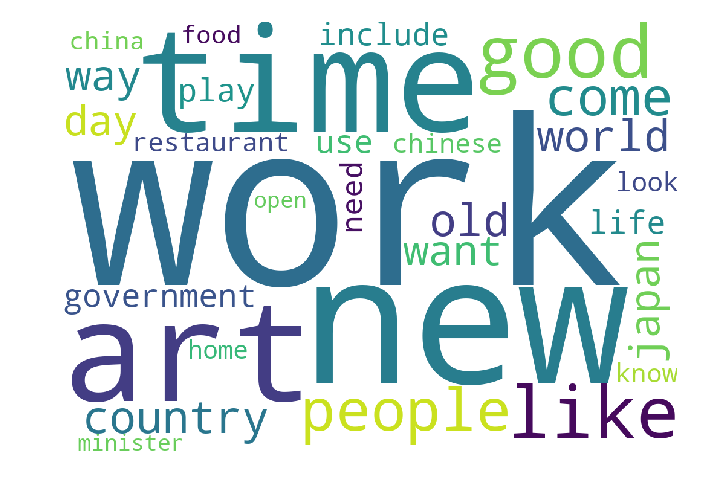



THE TOP 30 WORDS FOR TOPIC #2
['government', 'firm', 'world', 'cost', 'global', 'start', 'include', 'come', 'investment', 'work', 'help', 'design', 'add', 'good', 'product', 'technology', 'financial', 'people', 'service', 'asia', 'customer', 'industry', 'use', 'time', 'need', 'new', 'bank', 'market', 'business', 'company']


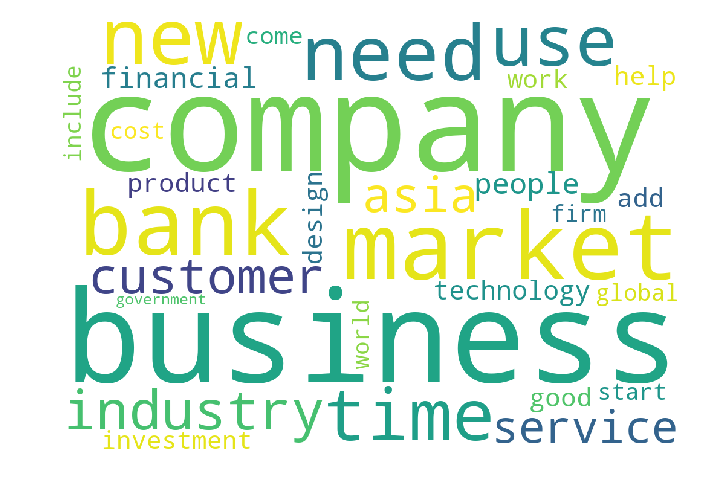



THE TOP 30 WORDS FOR TOPIC #3
['income', 'yesterday', 'cost', 'earning', 'share', 'asset', 'continue', 'end', 'stock', 'revenue', 'business', 'profit', 'low', 'month', 'company', 'bank', 'group', 'net', 'quarter', '2013', 'increase', 'china', 'price', 'rate', 'billion', 'expect', 'rise', 'high', 'growth', 'market']


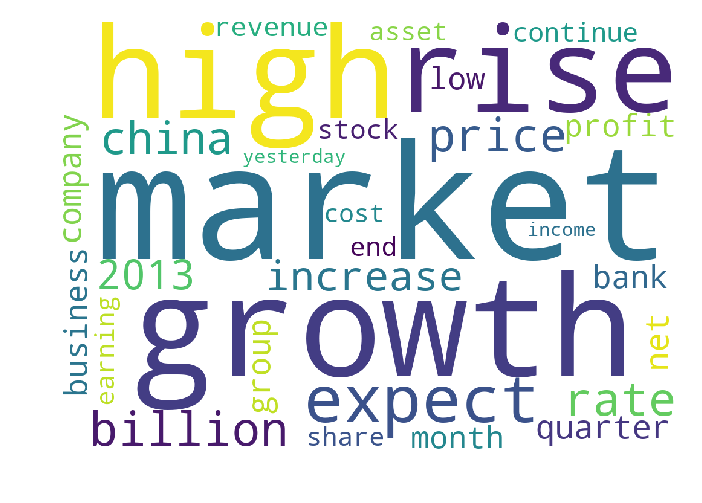



THE TOP 30 WORDS FOR TOPIC #4
['march', 'counter', 'share price', 'director', 'offer', 'exchange', 'profit', 'list', 'acquire', 'week', 'new', 'market', 'firm', 'unit', 'close', 'yesterday', 'trading', 'purchase', 'shareholder', 'average', 'stock', 'issue', 'bitcoin', 'holding', 'trade', 'group', '2013', 'company', 'price', 'share']


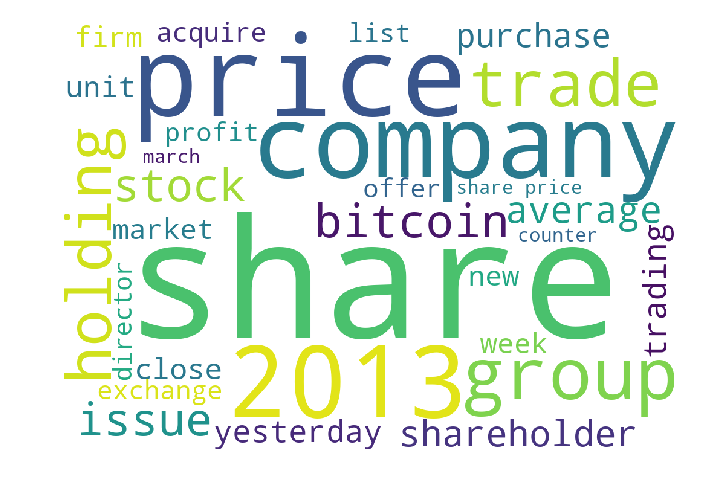



THE TOP 30 WORDS FOR TOPIC #5
['yesterday', 'executive', 'offer', 'home', 'launch', 'bank', 'time', 'developer', 'sq', 'group', 'include', 'area', 'billion', 'high', 'sale', 'expect', 'investment', 'service', 'land', 'site', 'business', 'asia', 'development', 'project', 'new', 'company', 'market', 'unit', 'price', 'property']


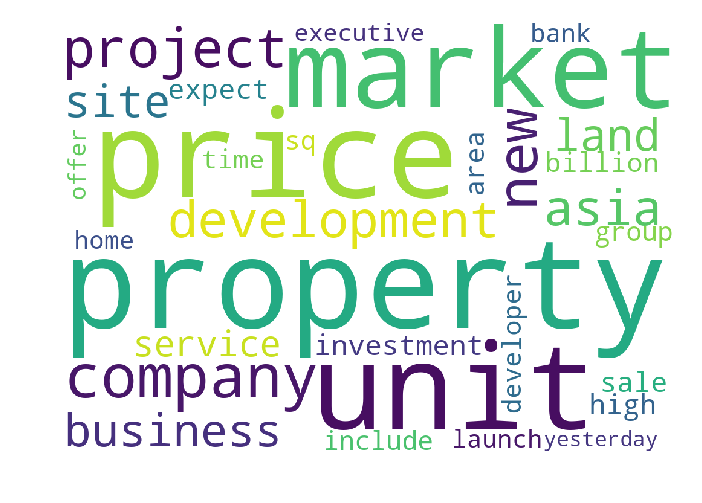





Forming document term matrix for 2014Q2...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2014Q2...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2014Q2 #####


THE TOP 30 WORDS FOR TOPIC #1
['cost', 'cma', 'offshore', 'add', 'information', 'large', 'oil', 'cloud', 'need', 'datum', 'yesterday', 'vessel', 'investment', 'customer', 'high', 'wine', 'china', 'value', 'service', 'use', 'new', 'time', 'group', 'billion', 'business', 'price', 'market', 'share', 'company', 'offer']


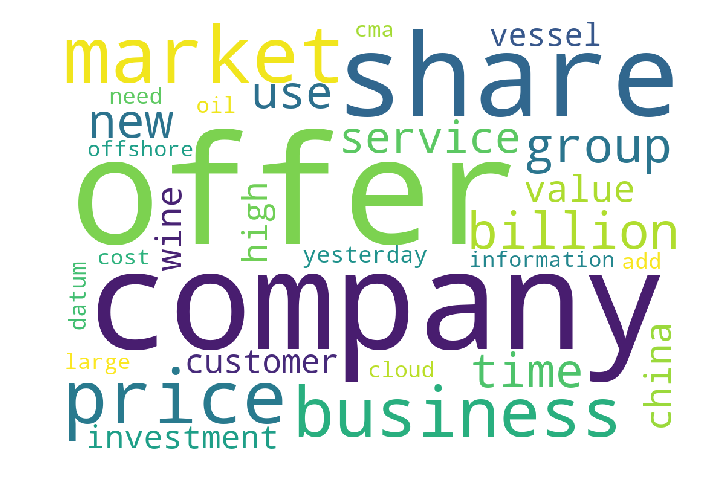



THE TOP 30 WORDS FOR TOPIC #2
['group', 'market', 'like', 'industry', 'director', 'help', 'high', 'add', 'good', 'technology', 'firm', 'economic', 'development', 'need', 'asia', 'global', 'people', 'minister', 'work', 'international', 'come', 'include', 'government', 'use', 'country', 'company', 'time', 'business', 'new', 'world']


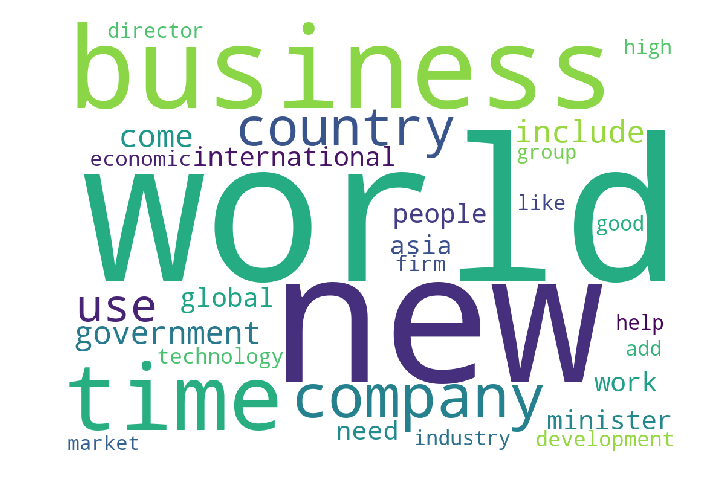



THE TOP 30 WORDS FOR TOPIC #3
['trade', 'continue', 'asset', 'low', 'end', 'new', 'profit', 'report', 'investment', 'rate', 'increase', 'net', 'yesterday', 'business', 'revenue', 'stock', 'expect', 'month', 'billion', 'china', 'group', 'bank', 'rise', 'price', 'quarter', 'company', 'high', 'growth', 'share', 'market']


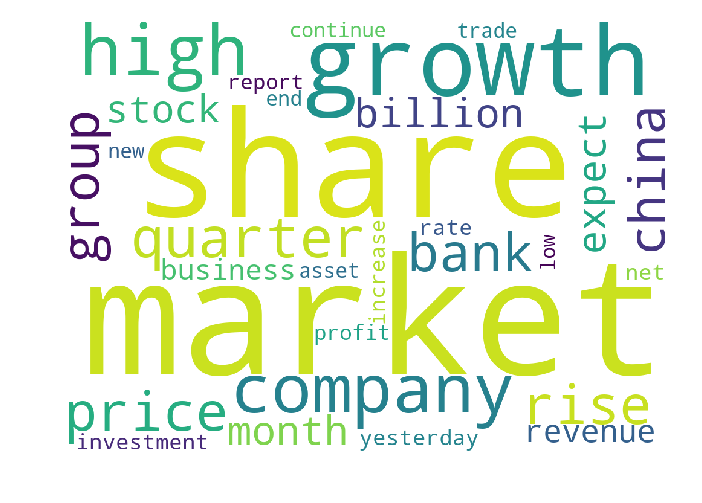



THE TOP 30 WORDS FOR TOPIC #4
['home', 'psf', 'group', 'private', 'board', 'month', 'time', 'china', 'area', 'japan', 'sell', 'sq', 'investment', 'government', 'expect', 'buyer', 'high', 'director', 'launch', 'developer', 'site', 'sale', 'land', 'development', 'new', 'market', 'property', 'price', 'project', 'unit']


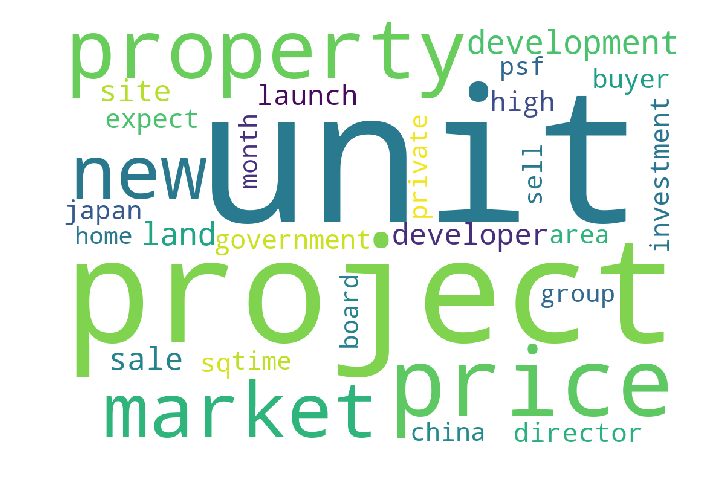



THE TOP 30 WORDS FOR TOPIC #5
['include', 'know', 'day', 'restaurant', 'add', 'director', 'financial', 'world', 'way', 'help', 'share', 'look', 'start', 'art', 'want', 'use', 'asia', 'come', 'like', 'need', 'bank', 'service', 'people', 'good', 'new', 'time', 'customer', 'work', 'company', 'business']


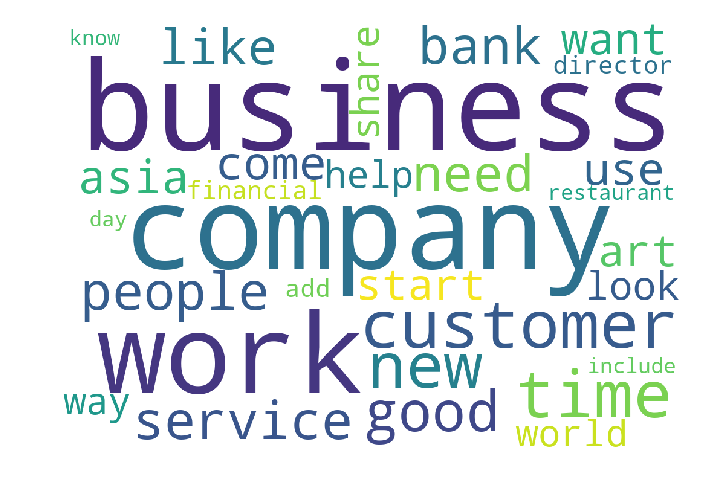





Forming document term matrix for 2014Q3...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2014Q3...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2014Q3 #####


THE TOP 30 WORDS FOR TOPIC #1
['high', 'good', 'come', 'area', 'public', 'state', 'development', 'country', 'plan', 'member', 'board', 'world', 'provide', 'people', 'project', 'minister', 'director', 'include', 'company', 'work', 'fund', 'business', 'japan', 'use', 'customer', 'service', 'government', 'time', 'need', 'new']


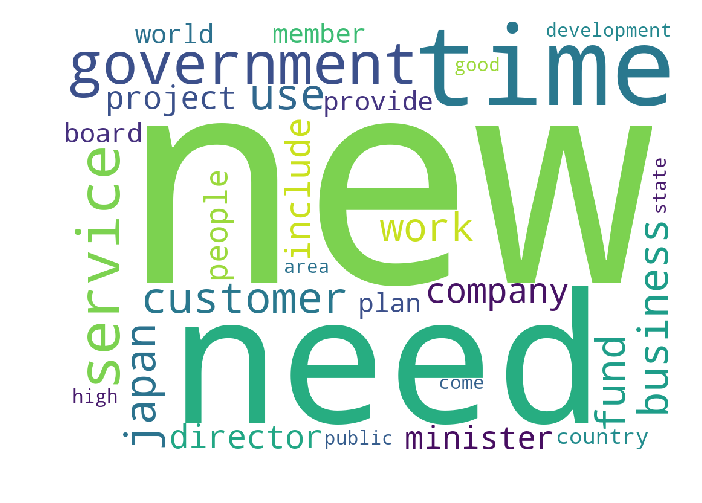



THE TOP 30 WORDS FOR TOPIC #2
['old', 'space', 'create', 'group', 'include', 'way', 'day', 'know', 'local', 'team', 'play', 'use', 'award', 'event', 'start', 'brand', 'want', 'look', 'people', 'design', 'come', 'world', 'business', 'company', 'good', 'like', 'art', 'time', 'new', 'work']


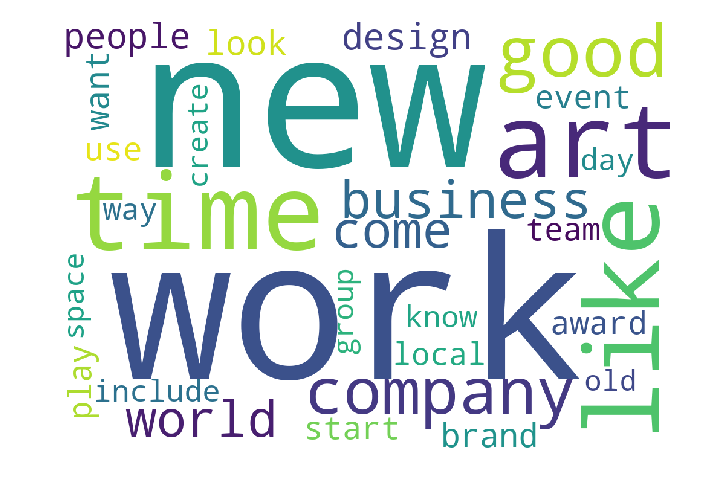



THE TOP 30 WORDS FOR TOPIC #3
['people', 'growth', 'include', 'government', 'billion', 'large', 'technology', 'grow', 'world', 'come', 'work', 'add', 'datum', 'high', 'investment', 'investor', 'global', 'firm', 'country', 'use', 'industry', 'need', 'service', 'time', 'asia', 'china', 'new', 'business', 'market', 'company']


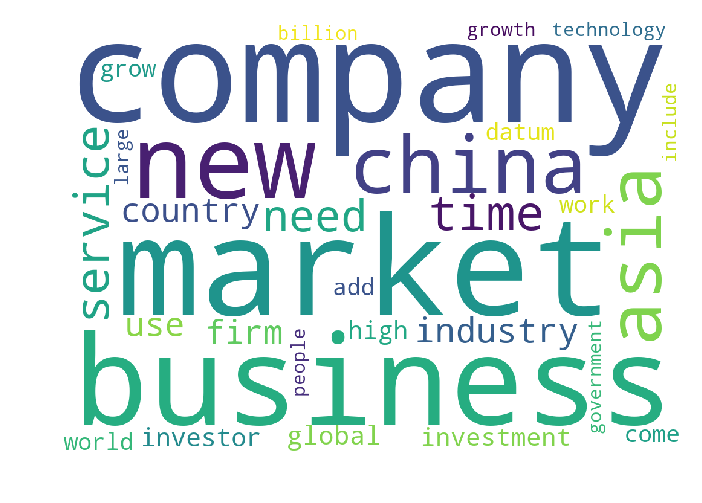



THE TOP 30 WORDS FOR TOPIC #4
['unit', 'value', 'investment', 'second', 'new', 'june', '2014', 'sale', 'earning', 'rise', 'asset', 'business', 'end', 'expect', 'increase', 'profit', 'company', 'growth', 'month', 'property', 'billion', 'revenue', 'net', 'high', 'market', 'price', 'quarter', 'group', 'bank', 'share']


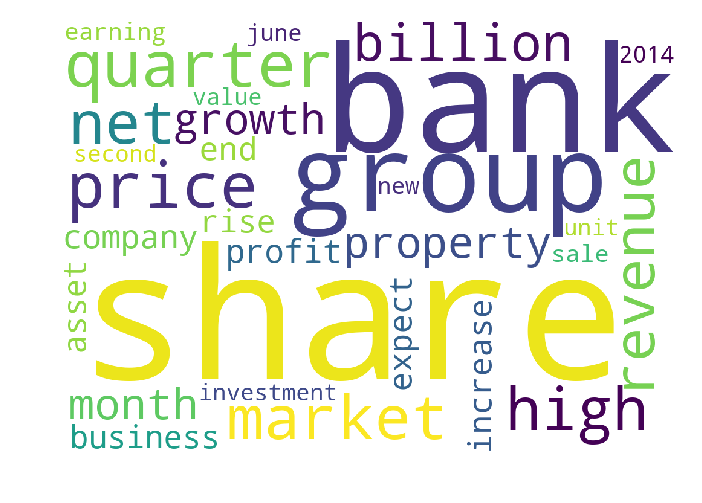



THE TOP 30 WORDS FOR TOPIC #5
['development', 'continue', 'fall', 'report', 'new', 'government', 'policy', 'sale', 'developer', 'low', 'inflation', 'property', 'wine', 'time', 'good', 'site', 'bank', 'japan', 'project', 'high', 'economic', 'rise', 'month', 'unit', 'expect', 'rate', 'growth', 'economy', 'price', 'market']


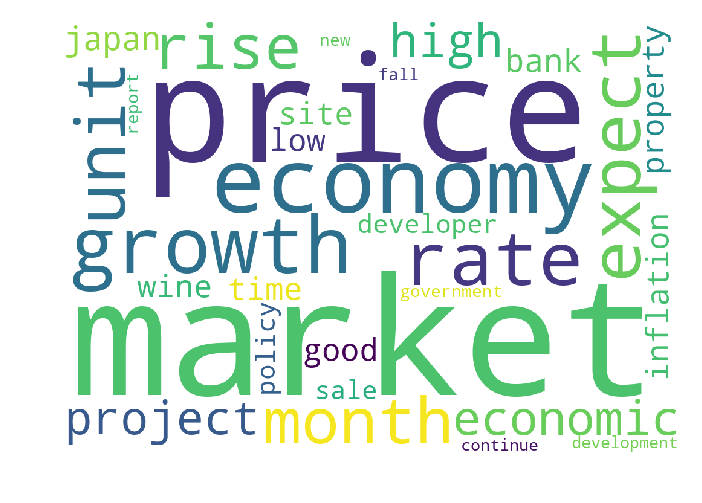





Forming document term matrix for 2014Q4...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2014Q4...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2014Q4 #####


THE TOP 30 WORDS FOR TOPIC #1
['government', 'development', 'sgx', 'include', 'customer', 'high', 'management', 'group', 'people', 'investor', 'help', 'global', 'system', 'firm', 'technology', 'corporate', 'director', 'china', 'good', 'work', 'country', 'time', 'service', 'asia', 'need', 'industry', 'new', 'market', 'business', 'company']


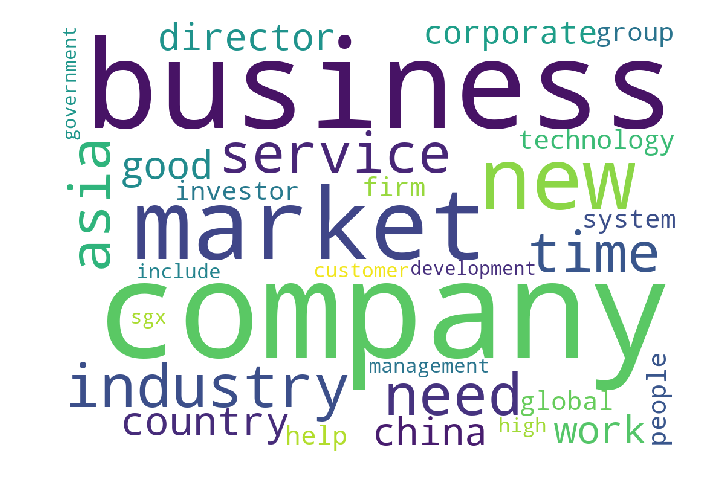



THE TOP 30 WORDS FOR TOPIC #2
['bond', 'financial', 'quarter', 'continue', 'report', 'fund', 'interest', 'policy', 'investment', 'fall', 'month', 'expect', 'investor', 'japan', 'china', 'time', 'high', 'economic', 'rise', 'global', 'low', 'stock', 'billion', 'economy', 'oil', 'rate', 'growth', 'price', 'bank', 'market']


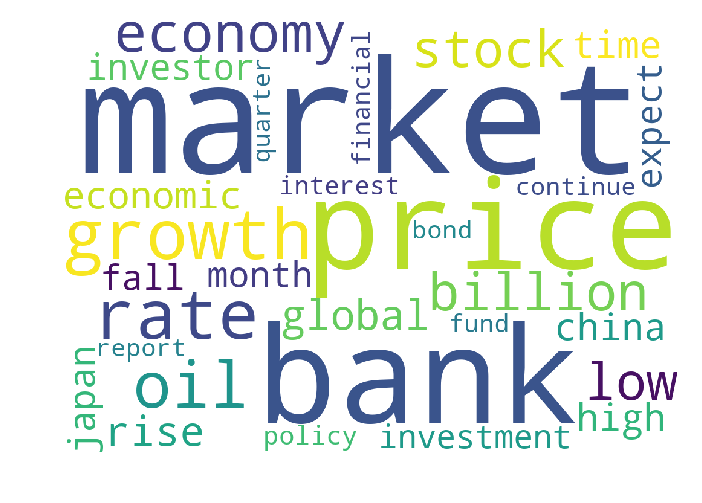



THE TOP 30 WORDS FOR TOPIC #3
['cost', 'buy', 'value', 'energy', 'business', 'close', 'billion', 'fall', 'investment', 'increase', 'earning', 'company', '2014', 'property', 'expect', 'oil', 'sale', 'end', 'low', 'net', 'group', 'profit', 'market', 'new', 'month', 'revenue', 'high', 'share', 'quarter', 'price']


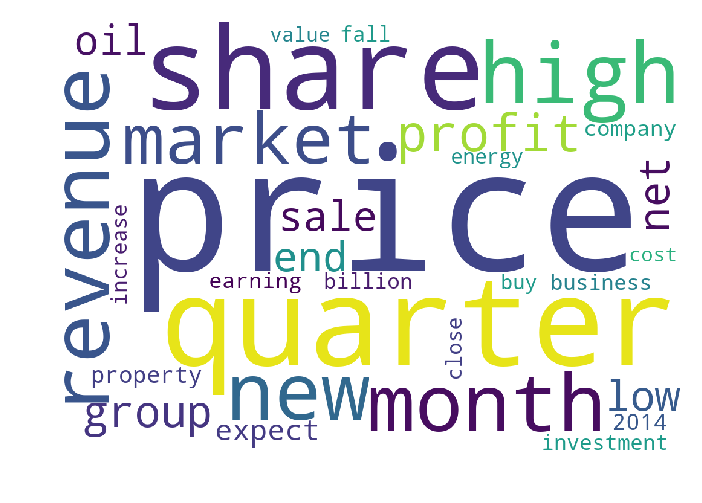



THE TOP 30 WORDS FOR TOPIC #4
['space', 'investment', 'end', 'wine', 'expect', 'work', 'share', 'residential', 'sell', 'developer', 'use', 'hotel', 'building', 'price', 'high', 'company', 'area', 'office', 'sale', 'land', 'construction', 'site', 'new', 'business', 'market', 'development', 'property', 'unit', 'project', 'group']


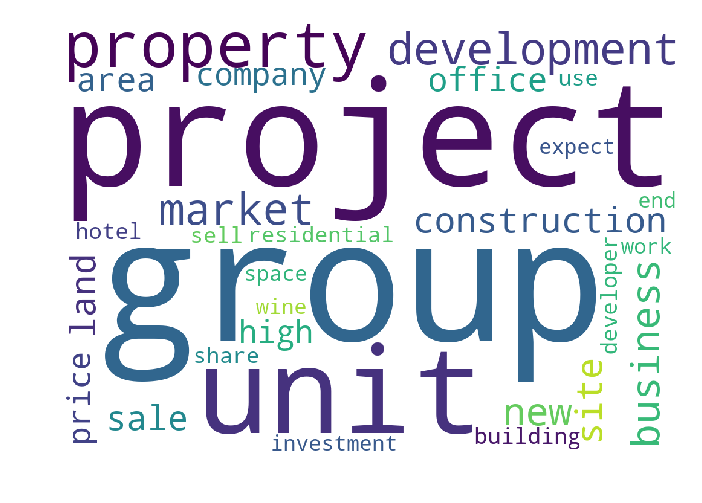



THE TOP 30 WORDS FOR TOPIC #5
['set', 'price', 'brand', 'way', 'know', 'start', 'open', 'director', 'play', 'include', 'day', 'bank', 'food', 'look', 'old', 'group', 'asia', 'design', 'world', 'use', 'want', 'come', 'people', 'good', 'work', 'like', 'art', 'time', 'new', 'share']


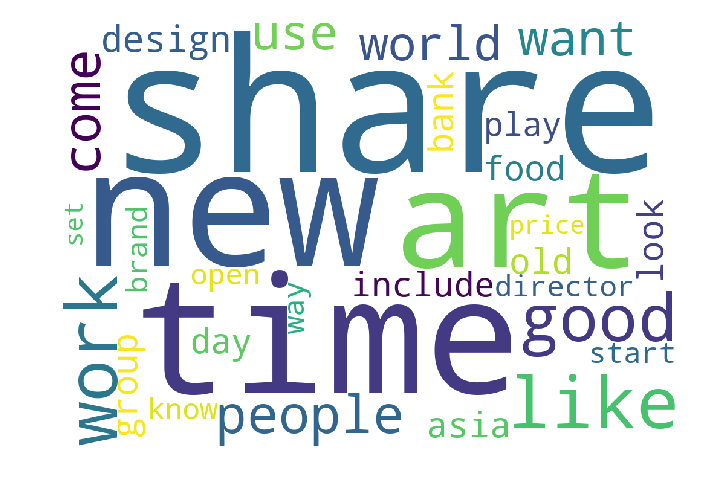





Forming document term matrix for 2015Q1...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2015Q1...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2015Q1 #####


THE TOP 30 WORDS FOR TOPIC #1
['policy', 'trade', 'investment', 'bond', 'increase', 'company', 'interest', 'investor', 'china', '2014', 'global', 'point', '2015', 'report', 'time', 'high', 'billion', 'economy', 'fall', 'month', 'stock', 'rise', 'low', 'expect', 'oil', 'growth', 'rate', 'bank', 'price', 'market']


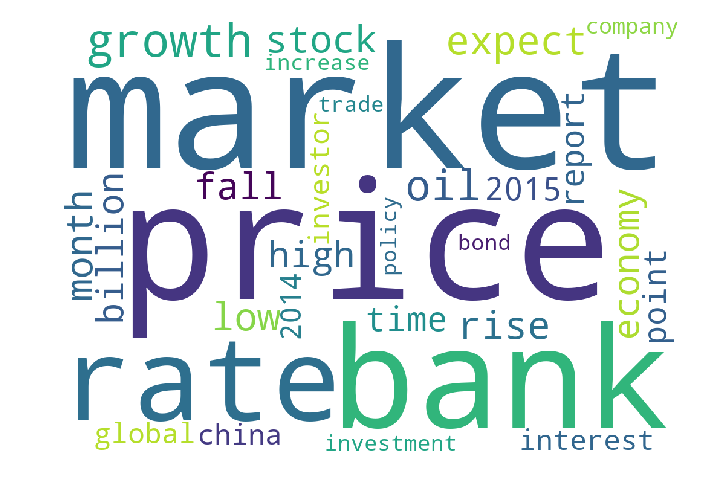



THE TOP 30 WORDS FOR TOPIC #2
['growth', 'wine', 'region', 'build', 'provide', 'add', 'customer', 'high', 'grow', 'world', 'development', 'offer', 'include', 'help', 'management', 'security', 'international', 'global', 'work', 'need', 'good', 'market', 'time', 'group', 'industry', 'service', 'asia', 'new', 'company', 'business']


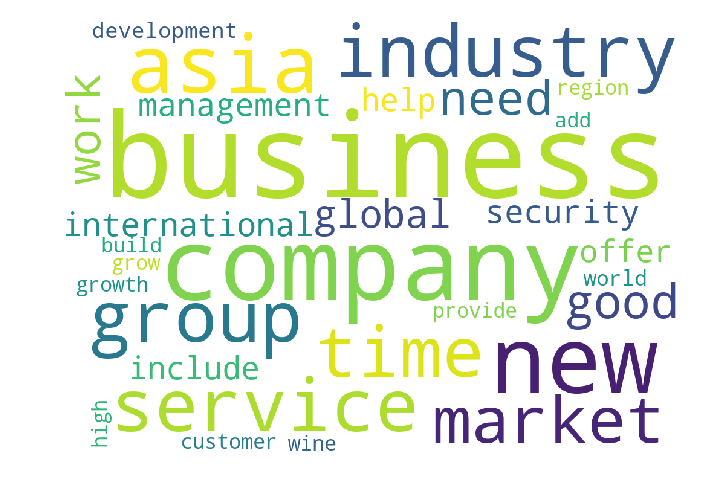



THE TOP 30 WORDS FOR TOPIC #3
['think', 'thing', 'city', 'life', 'start', 'play', 'local', 'place', 'know', 'include', 'open', 'way', 'food', 'look', 'want', 'restaurant', 'world', 'day', 'chef', 'use', 'design', 'people', 'come', 'art', 'lee', 'like', 'good', 'new', 'time', 'work']


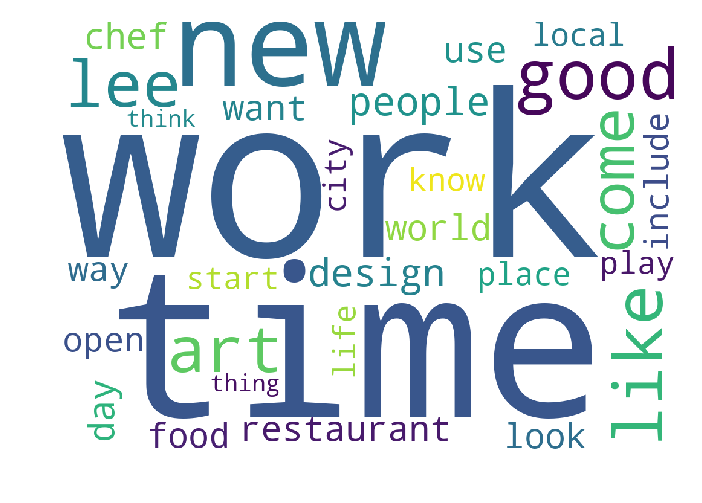



THE TOP 30 WORDS FOR TOPIC #4
['month', 'business', 'total', 'expect', 'rise', 'sell', 'investment', 'billion', 'average', 'reit', 'increase', 'close', 'land', 'keppel', 'company', 'end', 'project', 'sale', 'quarter', 'high', 'market', 'profit', 'revenue', 'net', 'group', 'unit', 'price', '2014', 'property', 'share']


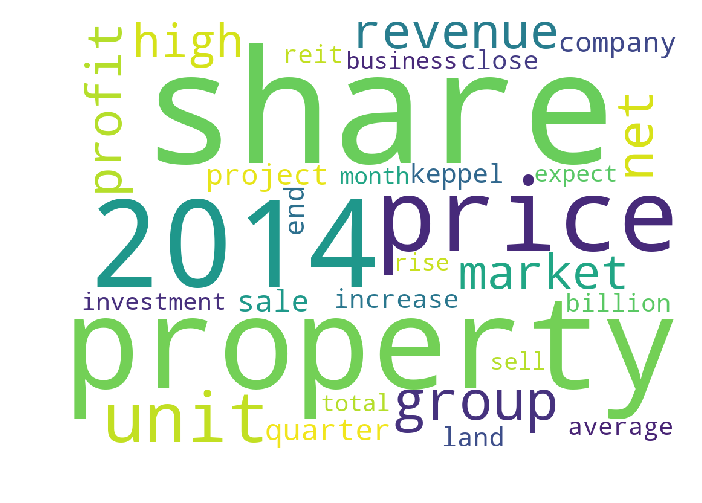



THE TOP 30 WORDS FOR TOPIC #5
['term', 'group', 'people', 'technology', 'growth', 'add', 'industry', 'high', 'budget', 'include', 'continue', 'provide', 'state', 'development', 'help', 'information', 'service', 'support', 'asia', 'country', 'time', 'minister', 'use', 'investment', 'market', 'need', 'new', 'government', 'business', 'company']


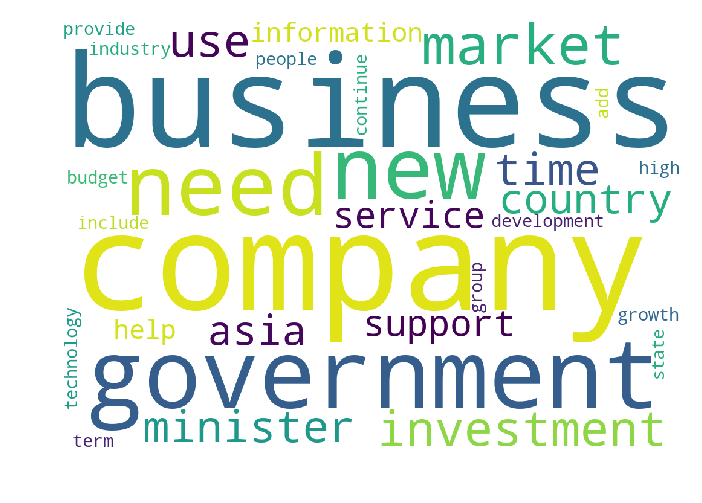





Forming document term matrix for 2015Q2...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2015Q2...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2015Q2 #####


THE TOP 30 WORDS FOR TOPIC #1
['market', 'customer', 'home', 'world', 'brand', 'day', 'chef', 'start', 'old', 'open', 'include', 'project', 'add', 'design', 'restaurant', 'company', 'want', 'look', 'food', 'people', 'unit', 'art', 'business', 'come', 'use', 'good', 'like', 'time', 'work', 'new']


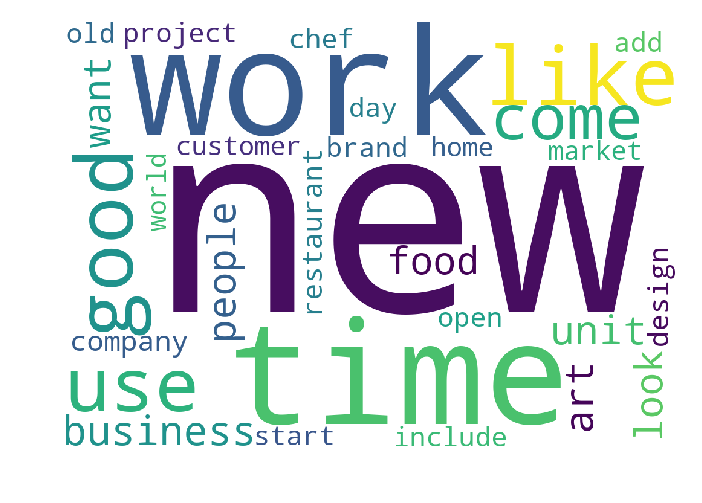



THE TOP 30 WORDS FOR TOPIC #2
['minister', 'help', 'trade', 'good', 'sector', 'high', 'economy', 'include', 'international', 'work', 'development', 'growth', 'investment', 'economic', 'industry', 'service', 'financial', 'global', 'government', 'world', 'time', 'company', 'market', 'new', 'need', 'bank', 'country', 'china', 'asia', 'business']


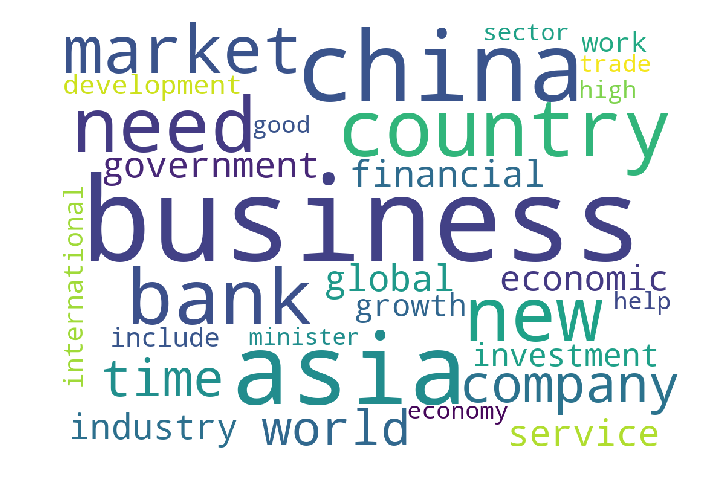



THE TOP 30 WORDS FOR TOPIC #3
['april', 'capital', 'quarter', 'investor', 'ocbc', 'time', 'report', 'dbs', 'fund', '2015', 'service', 'company', 'financial', 'expect', 'information publish', 'target price', 'publish', 'japan', 'asset', 'billion', 'loan', 'target', 'growth', 'investment', 'bond', 'market', 'information', 'business', 'price', 'bank']


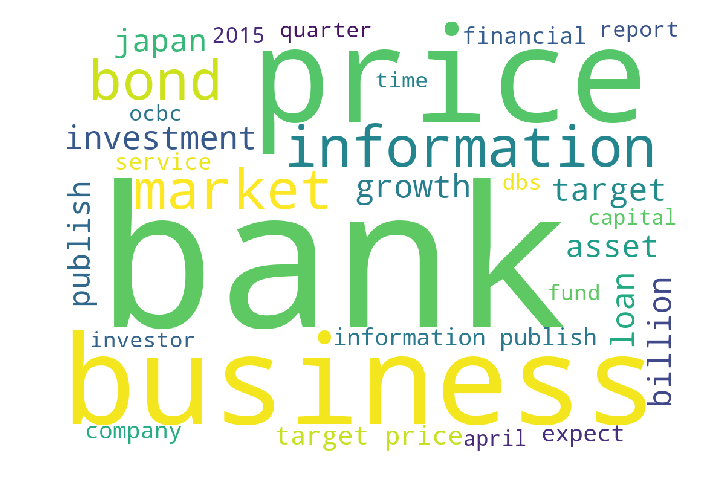



THE TOP 30 WORDS FOR TOPIC #4
['noble', '2015', 'fall', 'growth', 'earning', 'value', 'interest', 'time', 'business', 'asset', 'profit', 'rise', 'month', 'rate', 'low', 'shareholder', 'revenue', 'end', 'billion', 'report', 'net', 'quarter', 'investor', 'high', 'price', 'group', 'stock', 'company', 'share', 'market']


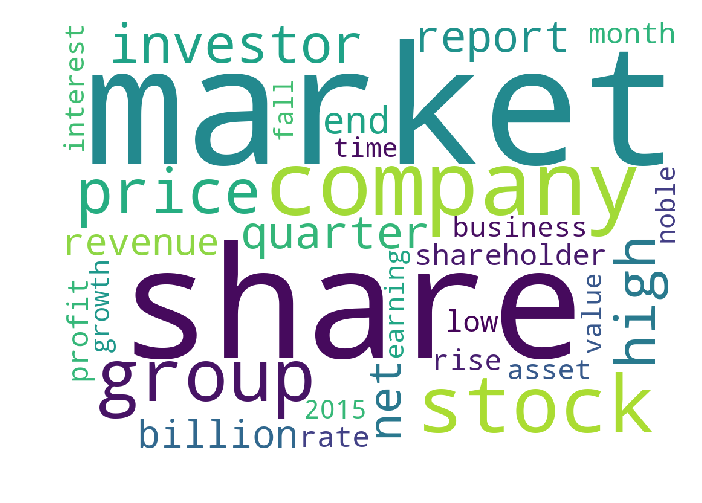



THE TOP 30 WORDS FOR TOPIC #5
['china', 'billion', 'government', 'company', 'reit', 'remain', 'new', '2015', 'end', 'april', 'increase', 'project', 'average', 'rise', 'low', 'unit', 'high', 'march', 'month', 'rate', 'fall', '2014', 'group', 'expect', 'growth', 'property', 'quarter', 'market', 'share', 'price']


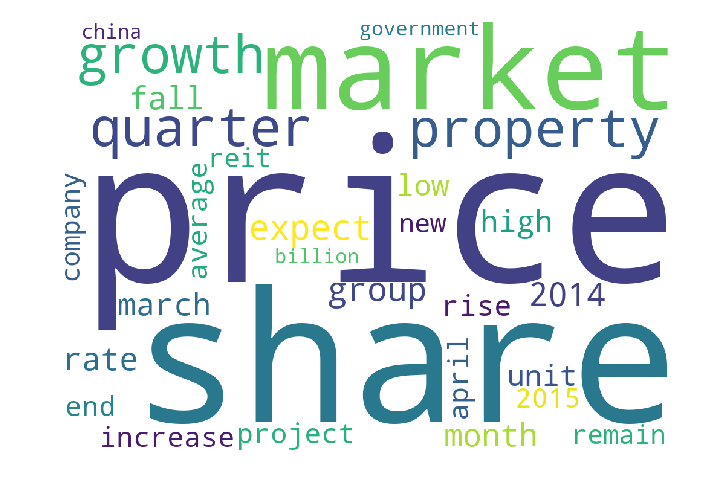





Forming document term matrix for 2015Q3...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2015Q3...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2015Q3 #####


THE TOP 30 WORDS FOR TOPIC #1
['increase', 'profit', '2015', 'sell', 'project', 'revenue', 'rate', 'investment', 'rise', 'fall', 'close', 'company', 'end', 'net', 'june', 'expect', 'low', 'new', 'sale', 'billion', 'unit', 'month', 'high', 'quarter', 'stock', 'property', 'group', 'price', 'share', 'market']


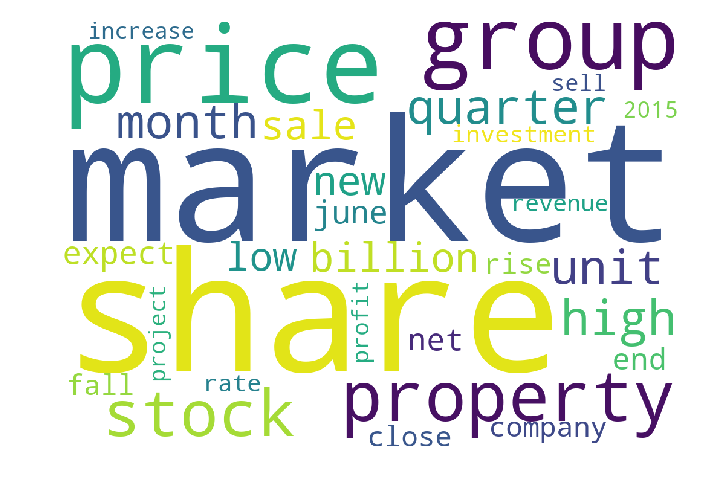



THE TOP 30 WORDS FOR TOPIC #2
['know', 'watch', 'car', 'local', 'big', 'include', 'old', 'play', 'service', 'product', 'add', 'team', 'want', 'start', 'look', 'world', 'come', 'customer', 'people', 'use', 'design', 'brand', 'company', 'good', 'business', 'like', 'art', 'work', 'time', 'new']


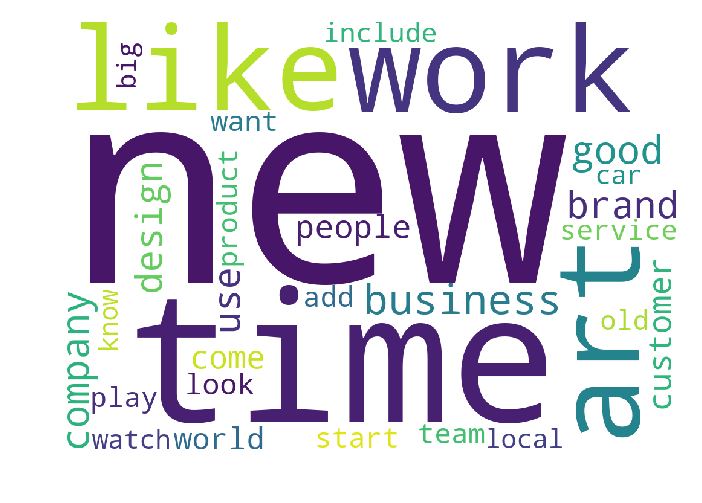



THE TOP 30 WORDS FOR TOPIC #3
['good', 'use', 'investment', 'executive', 'development', 'help', 'add', 'noble', 'provide', 'investor', 'report', 'include', 'technology', 'firm', 'management', 'need', 'government', 'work', 'bank', 'corporate', 'new', 'board', 'director', 'industry', 'time', 'group', 'market', 'financial', 'business', 'company']


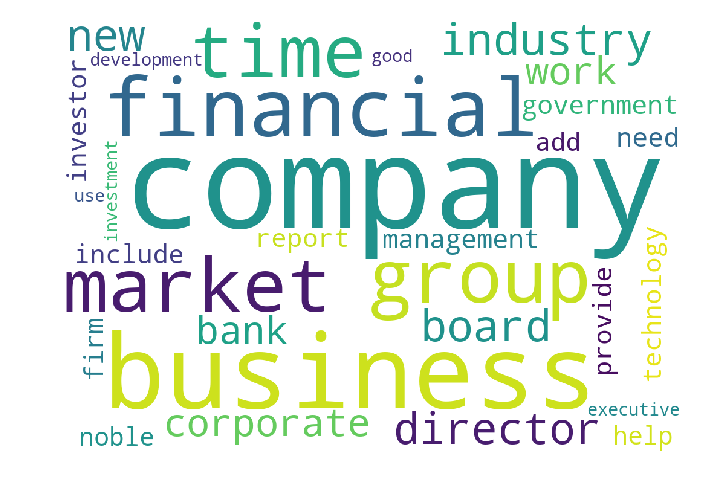



THE TOP 30 WORDS FOR TOPIC #4
['fall', 'expect', 'government', 'month', 'trade', 'continue', 'report', 'policy', 'rise', 'price', 'sector', 'chinese', 'dollar', 'investment', 'financial', 'time', 'business', 'japan', 'world', 'currency', 'country', 'economic', 'global', 'asia', 'rate', 'bank', 'growth', 'economy', 'china', 'market']


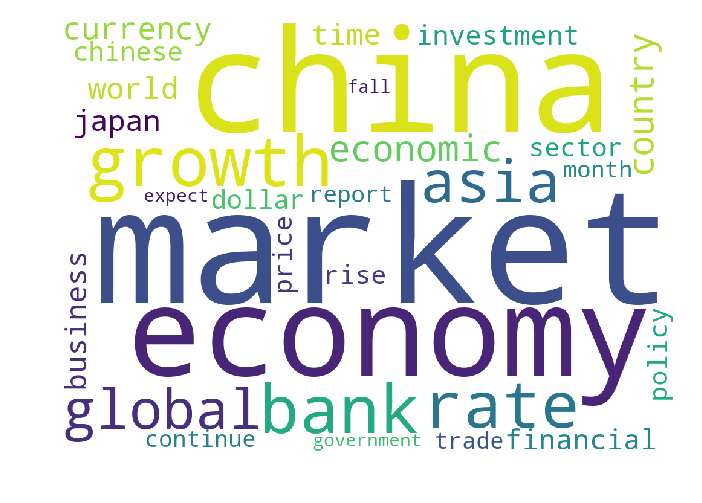



THE TOP 30 WORDS FOR TOPIC #5
['add', 'east', 'lim', 'support', 'service', 'worker', '2011', 'constituency', 'good', 'need', 'wp', 'day', 'member', 'national', 'general', 'work', 'new', 'time', 'government', 'vote', 'team', 'lee', 'candidate', 'singaporean', 'grc', 'election', 'people', 'minister', 'pap', 'party']


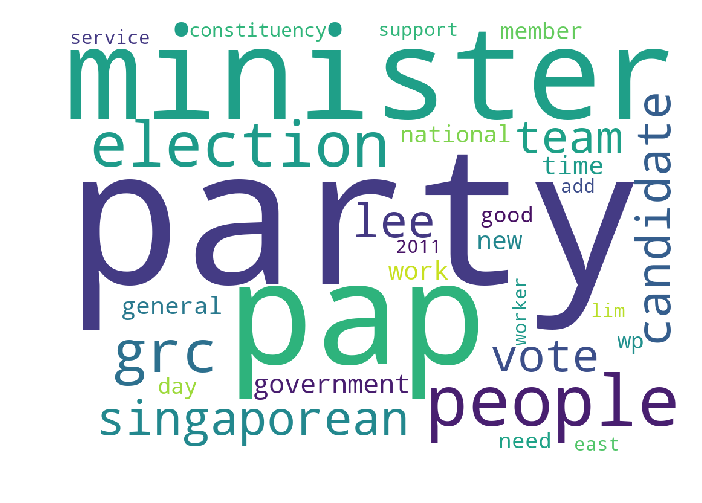





Forming document term matrix for 2015Q4...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2015Q4...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2015Q4 #####


THE TOP 30 WORDS FOR TOPIC #1
['oil', 'increase', 'economy', 'new', 'net', 'share', 'sale', 'business', 'time', 'stock', 'end', 'group', 'fall', 'investment', 'unit', '2015', 'china', 'rise', 'property', 'bank', 'billion', 'low', 'high', 'expect', 'month', 'quarter', 'growth', 'rate', 'price', 'market']


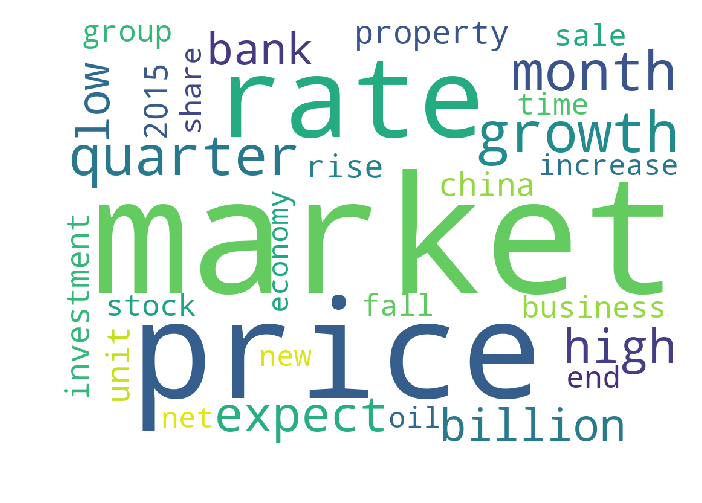



THE TOP 30 WORDS FOR TOPIC #2
['brand', 'fund', 'use', 'want', 'look', 'work', 'dish', 'japanese', 'corporate', 'room', 'business', 'offer', 'board', 'include', 'add', 'japan', 'director', 'open', 'time', 'shareholder', 'come', 'good', 'like', 'company', 'new', 'food', 'group', 'chef', 'restaurant', 'hotel']


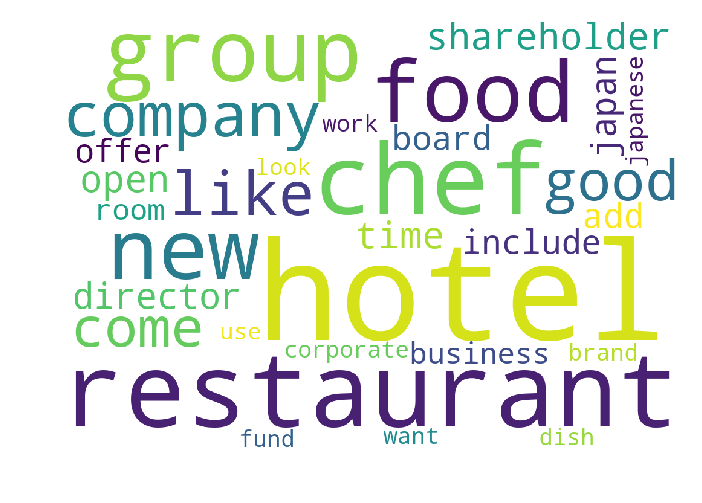



THE TOP 30 WORDS FOR TOPIC #3
['add', 'sector', 'come', 'product', 'financial', 'system', 'growth', 'government', 'good', 'customer', 'help', 'energy', 'china', 'people', 'use', 'world', 'work', 'industry', 'global', 'time', 'country', 'technology', 'need', 'market', 'bank', 'service', 'asia', 'new', 'company', 'business']


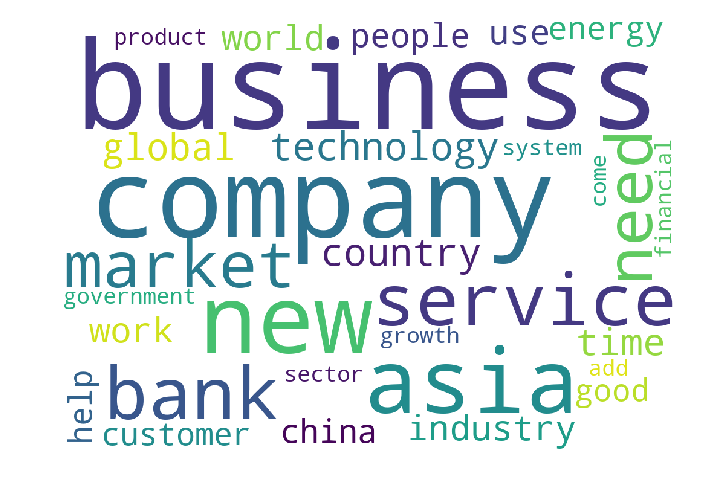



THE TOP 30 WORDS FOR TOPIC #4
['look', 'national', 'add', 'music', 'member', 'design', 'way', 'want', 'know', 'president', 'american', 'artist', 'event', 'lee', 'good', 'film', 'day', 'people', 'state', 'come', 'country', 'include', 'like', 'play', 'china', 'world', 'new', 'work', 'time', 'art']


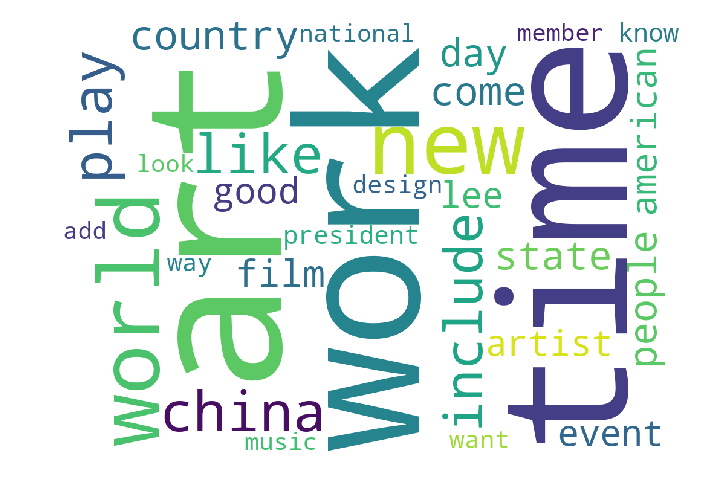



THE TOP 30 WORDS FOR TOPIC #5
['acquire', 'service', 'land', 'buy', 'business', 'holding', 'firm', 'singpost', 'stock', '2014', 'investor', 'development', 'good', 'time', 'issue', 'sgx', 'average', 'purchase', 'director', 'trade', 'project', 'new', 'list', 'wine', 'group', 'china', 'price', 'market', 'company', 'share']


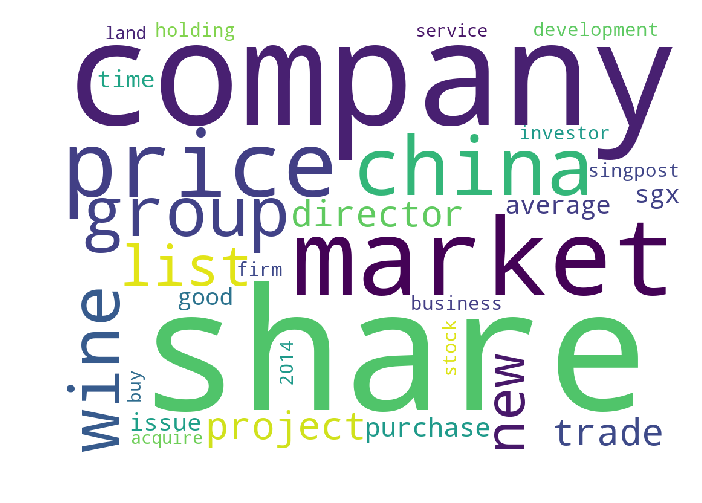





Forming document term matrix for 2016Q1...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2016Q1...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2016Q1 #####


THE TOP 30 WORDS FOR TOPIC #1
['growth', 'plan', 'property', 'price', 'management', 'include', 'capital', 'financial', 'time', 'investor', 'loan', 'rate', 'share', 'offer', '2015', 'asia', 'bond', 'service', 'fund', 'asset', 'high', 'business', 'investment', 'group', 'china', 'company', 'new', 'billion', 'market', 'bank']


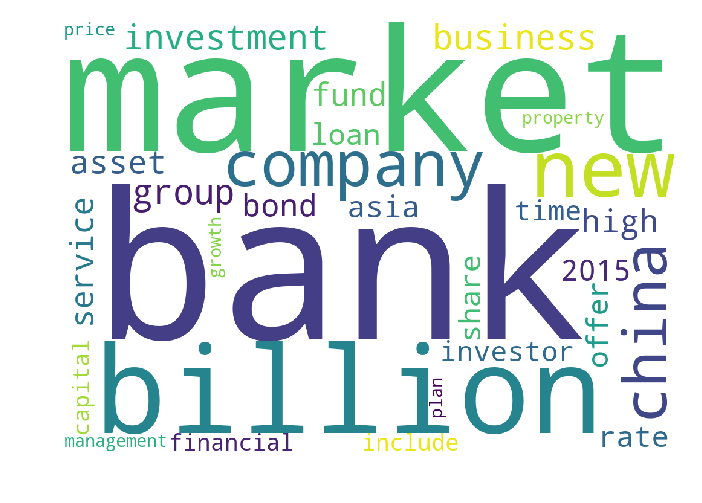



THE TOP 30 WORDS FOR TOPIC #2
['trade', 'sale', 'loss', 'oil', 'expect', 'time', 'rise', 'month', 'buy', 'value', 'business', 'low', 'close', 'average', 'fall', 'unit', 'revenue', 'quarter', 'high', 'end', 'profit', 'net', 'stock', 'property', 'group', '2015', 'company', 'market', 'price', 'share']


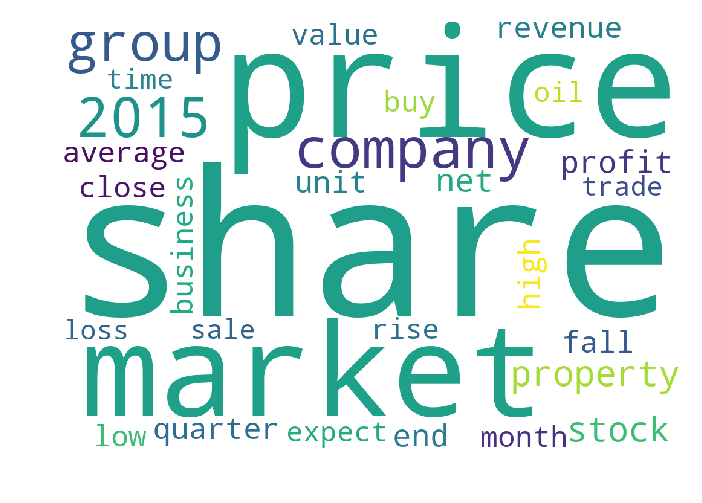



THE TOP 30 WORDS FOR TOPIC #3
['life', 'place', 'design', 'play', 'day', 'add', 'way', 'think', 'old', 'project', 'unit', 'food', 'world', 'wine', 'use', 'look', 'business', 'come', 'start', 'include', 'know', 'want', 'company', 'people', 'good', 'art', 'like', 'time', 'new', 'work']


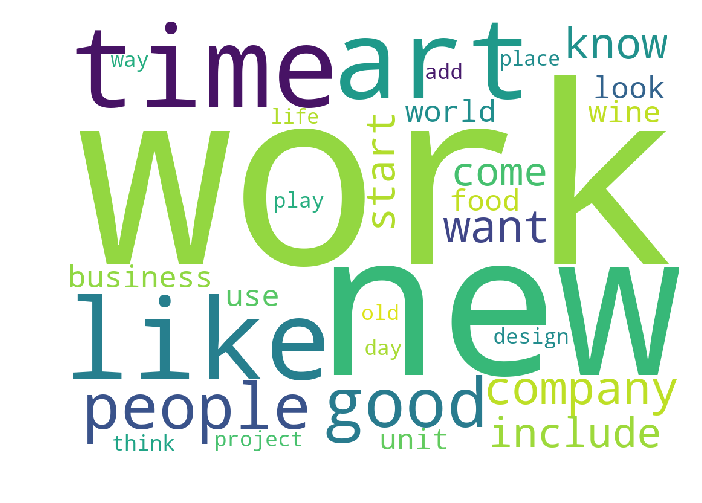



THE TOP 30 WORDS FOR TOPIC #4
['low', 'development', 'month', 'come', 'help', 'need', 'government', 'noble', 'project', 'support', 'price', 'iran', 'share', 'large', 'service', 'work', 'base', 'time', 'group', 'oil', 'firm', 'stock', 'new', 'sme', 'industry', 'sector', 'company', 'china', 'market', 'business']


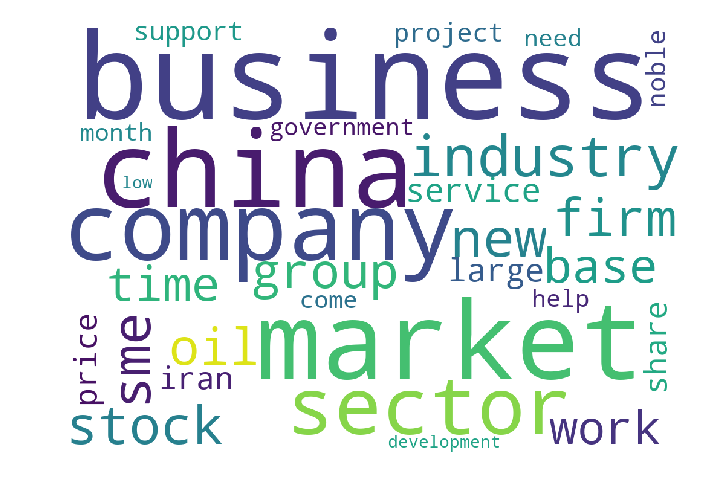



THE TOP 30 WORDS FOR TOPIC #5
['add', 'low', 'investment', 'sector', 'need', 'country', 'continue', 'world', 'financial', 'japan', 'come', 'expect', 'asia', 'service', 'price', 'high', 'policy', 'china', 'government', 'rate', 'time', 'global', 'company', 'economic', 'new', 'economy', 'bank', 'growth', 'business', 'market']


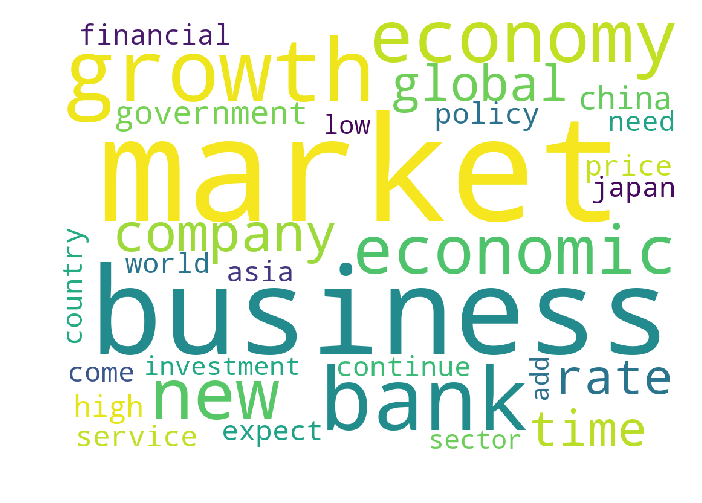





Forming document term matrix for 2016Q2...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2016Q2...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2016Q2 #####


THE TOP 30 WORDS FOR TOPIC #1
['director', 'rise', 'interest', 'management', 'group', 'rate', 'high', 'holding', 'financial', 'capital', 'average', 'fund', 'billion', 'asia', 'investment', 'shareholder', 'month', 'investor', 'firm', 'trade', 'time', 'week', '2015', 'report', 'price', 'stock', 'company', 'bank', 'market', 'share']


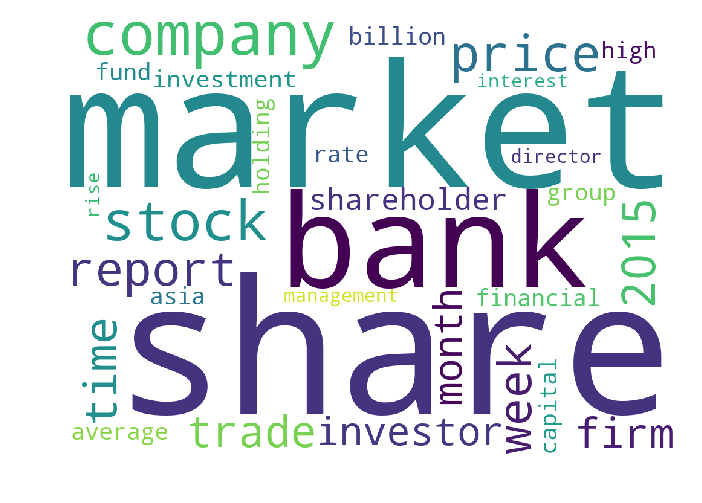



THE TOP 30 WORDS FOR TOPIC #2
['trump', 'minister', 'come', 'high', 'central', 'global', 'remain', 'property', 'state', 'fall', 'time', 'country', 'trade', 'china', 'new', 'expect', 'oil', 'rate', 'bank', 'government', 'project', 'growth', 'month', 'economic', 'policy', 'japan', 'unit', 'economy', 'market', 'price']


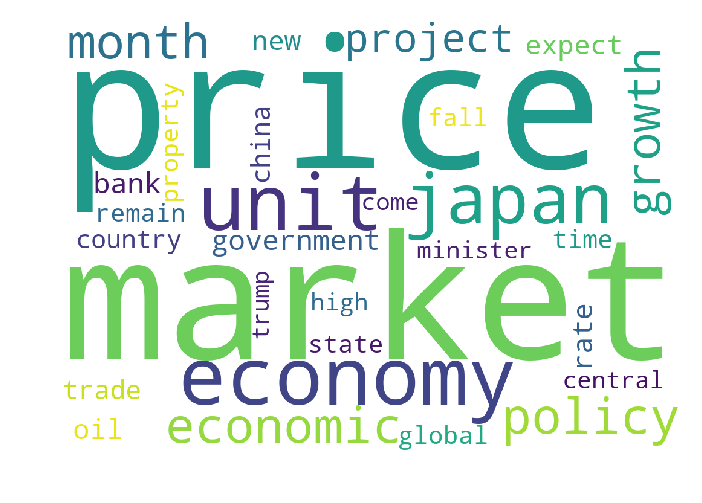



THE TOP 30 WORDS FOR TOPIC #3
['help', 'space', 'big', 'grow', 'look', 'way', 'centre', 'good', 'system', 'global', 'come', 'world', 'high', 'add', 'datum', 'car', 'customer', 'group', 'need', 'work', 'industry', 'use', 'time', 'asia', 'market', 'technology', 'service', 'company', 'new', 'business']


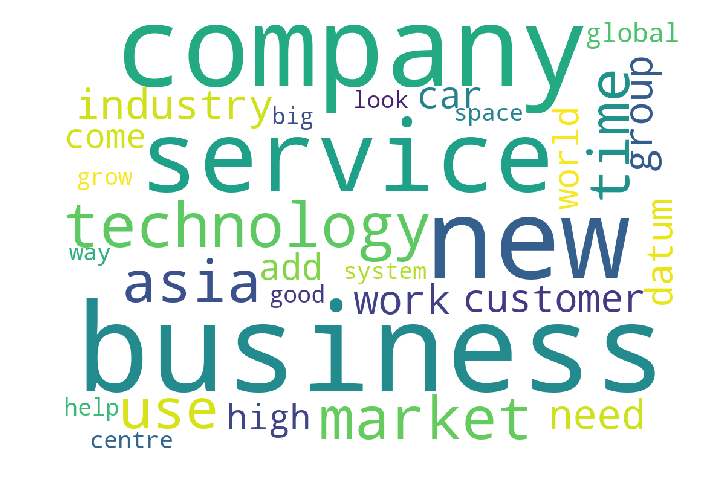



THE TOP 30 WORDS FOR TOPIC #4
['low', 'revenue', 'development', 'time', 'expect', 'bank', 'value', 'trust', 'quarter', 'new', 'report', 'fund', '2016', 'high', 'net', 'financial', 'growth', 'reit', 'billion', 'investor', 'china', 'share', 'price', 'asset', 'property', 'business', 'investment', 'market', 'group', 'company']


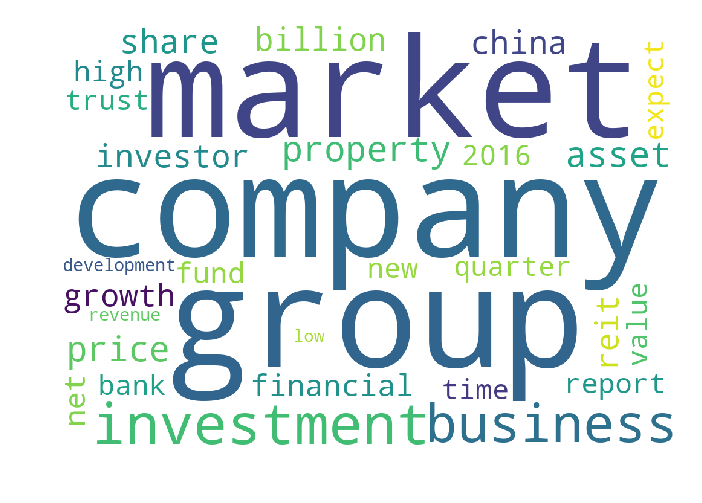



THE TOP 30 WORDS FOR TOPIC #5
['think', 'course', 'local', 'way', 'design', 'team', 'chinese', 'event', 'open', 'look', 'include', 'world', 'know', 'start', 'use', 'art', 'come', 'play', 'day', 'chef', 'old', 'restaurant', 'want', 'food', 'people', 'good', 'new', 'work', 'time', 'like']


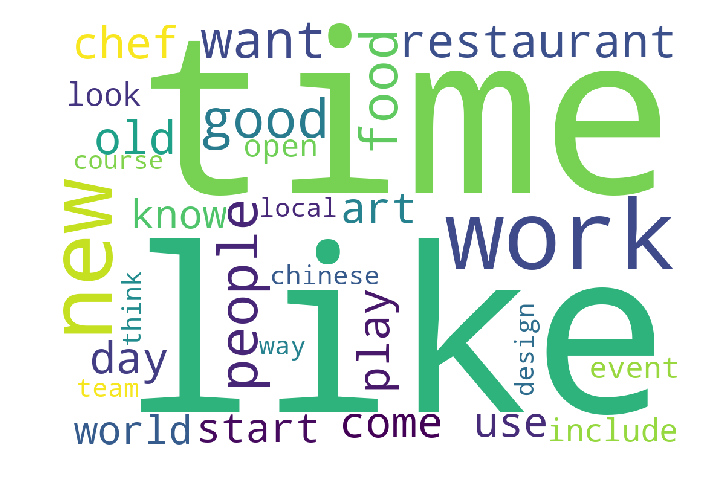





Forming document term matrix for 2016Q3...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2016Q3...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2016Q3 #####


THE TOP 30 WORDS FOR TOPIC #1
['city', 'watch', 'know', 'way', 'play', 'wine', 'old', 'lee', 'open', 'include', 'add', 'restaurant', 'country', 'want', 'world', 'business', 'people', 'art', 'water', 'chef', 'day', 'come', 'work', 'use', 'food', 'good', 'china', 'like', 'time', 'new']


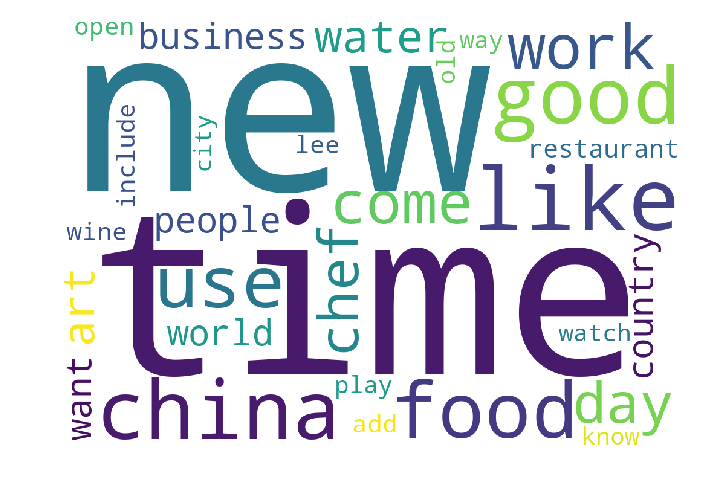



THE TOP 30 WORDS FOR TOPIC #2
['security', 'look', 'start', 'government', 'datum', 'provide', 'way', 'high', 'include', 'people', 'add', 'firm', 'market', 'project', 'system', 'director', 'product', 'group', 'industry', 'need', 'customer', 'use', 'technology', 'time', 'work', 'new', 'service', 'business', 'share', 'company']


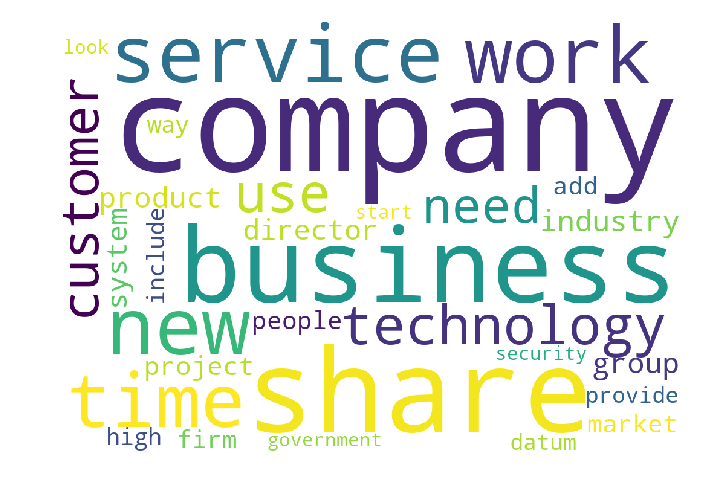



THE TOP 30 WORDS FOR TOPIC #3
['china', 'index', 'note', 'report', 'investor', 'government', 'policy', 'point', 'japan', 'economic', 'interest', 'rise', 'expect', 'share', 'sector', 'high', 'month', 'time', 'global', 'trade', 'economy', 'low', 'billion', 'stock', 'investment', 'rate', 'growth', 'price', 'bank', 'market']


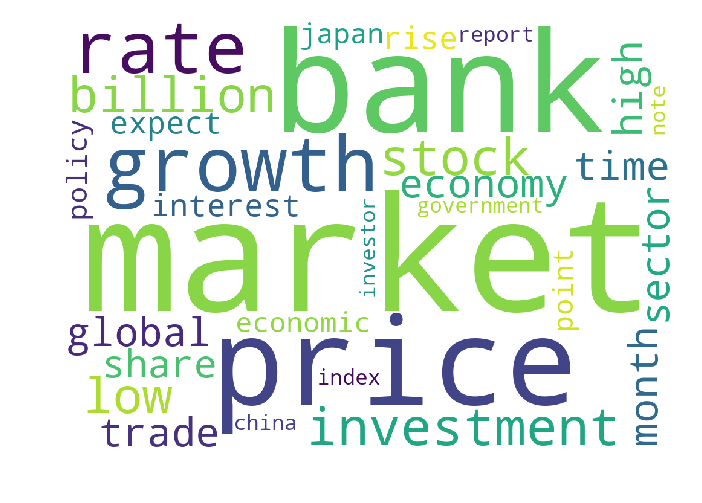



THE TOP 30 WORDS FOR TOPIC #4
['term', 'president', 'economic', 'report', 'board', 'service', 'director', 'share', 'industry', 'country', 'people', 'help', 'include', 'come', 'work', 'group', 'global', 'corporate', 'investor', 'world', 'financial', 'asia', 'change', 'need', 'good', 'time', 'market', 'new', 'company', 'business']


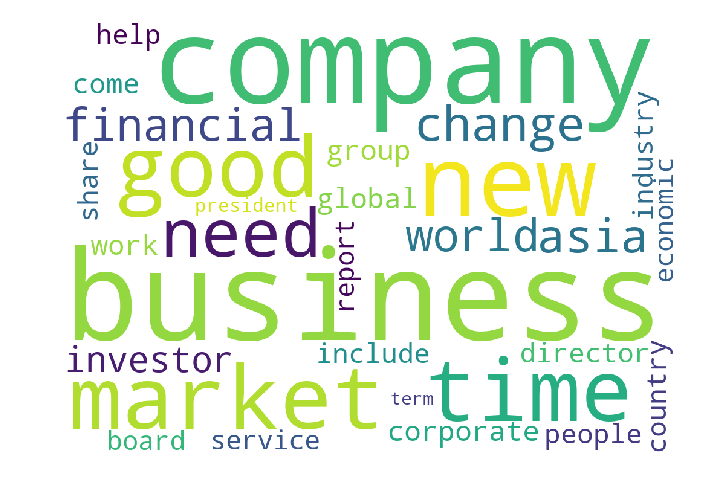



THE TOP 30 WORDS FOR TOPIC #5
['low', 'land', 'billion', 'office', 'month', 'expect', 'profit', '2016', 'investment', 'end', 'asset', 'development', 'june', 'reit', 'share', 'new', 'swiber', 'net', 'quarter', 'company', 'sale', 'business', 'revenue', 'high', 'price', 'market', 'project', 'unit', 'group', 'property']


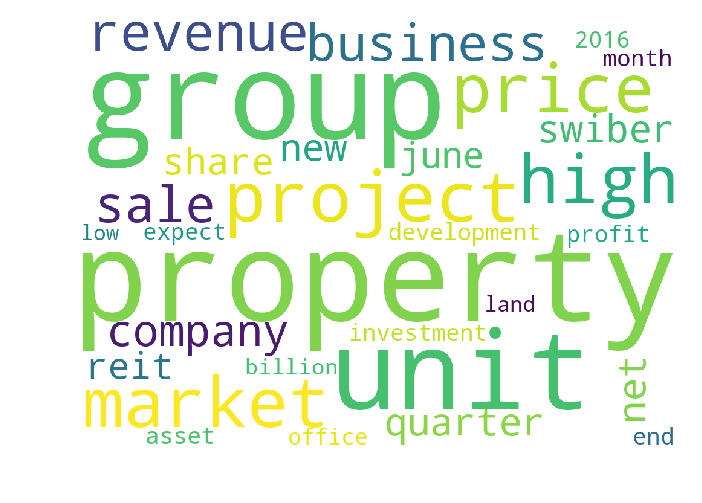





Forming document term matrix for 2016Q4...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2016Q4...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2016Q4 #####


THE TOP 30 WORDS FOR TOPIC #1
['trade', 'low', 'note', 'profit', 'holding', 'capital', 'china', 'rise', 'unit', 'value', 'end', 'revenue', 'expect', 'asset', 'reit', '2016', 'bank', 'investment', 'stock', 'month', 'net', 'quarter', 'property', 'high', 'billion', 'company', 'group', 'market', 'price', 'share']


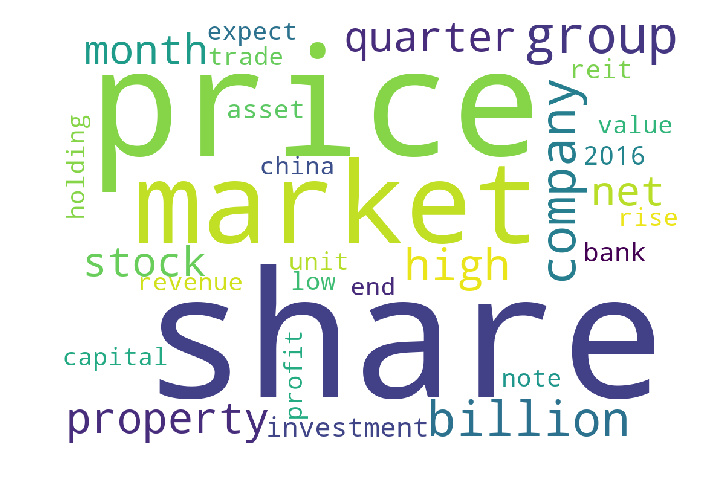



THE TOP 30 WORDS FOR TOPIC #2
['build', 'good', 'grow', 'add', 'world', 'group', 'change', 'use', 'cost', 'include', 'development', 'government', 'project', 'sector', 'country', 'help', 'global', 'technology', 'work', 'time', 'asia', 'market', 'service', 'energy', 'need', 'growth', 'new', 'industry', 'business', 'company']


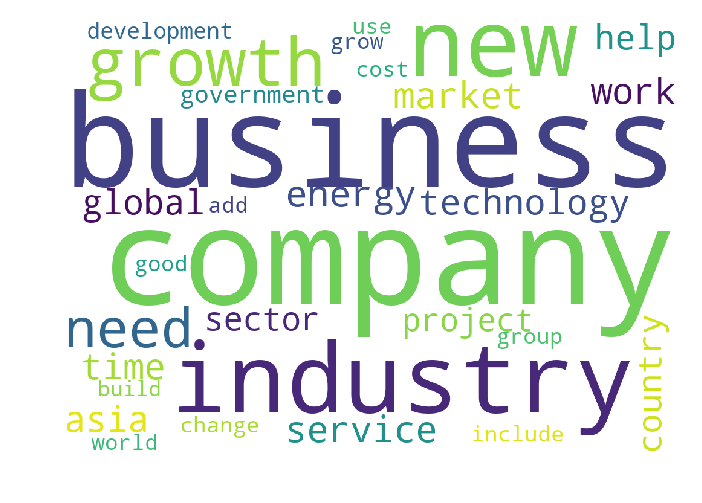



THE TOP 30 WORDS FOR TOPIC #3
['life', 'place', 'wine', 'family', 'business', 'thing', 'find', 'start', 'brand', 'food', 'open', 'home', 'way', 'company', 'use', 'old', 'world', 'restaurant', 'look', 'art', 'day', 'want', 'know', 'people', 'come', 'new', 'good', 'like', 'time', 'work']


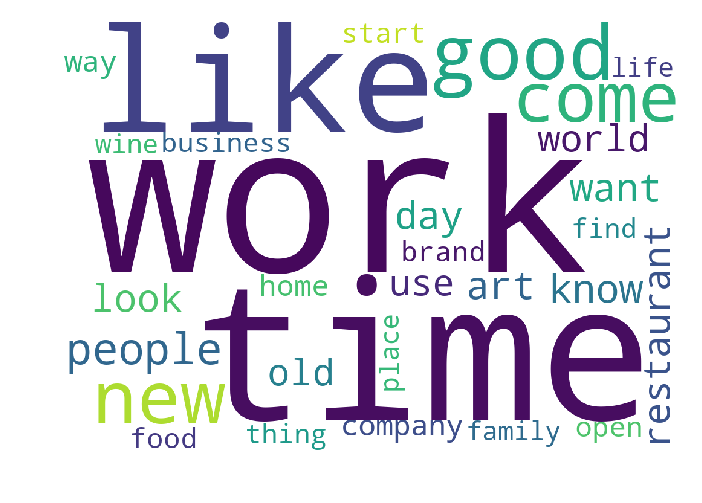



THE TOP 30 WORDS FOR TOPIC #4
['datum', 'development', 'launch', 'fund', 'group', 'project', 'land', 'office', 'car', 'site', 'use', 'add', 'month', 'investment', 'offer', 'company', 'customer', 'asia', 'time', 'sale', 'property', 'service', 'high', 'private', 'unit', 'price', 'bank', 'business', 'market', 'new']


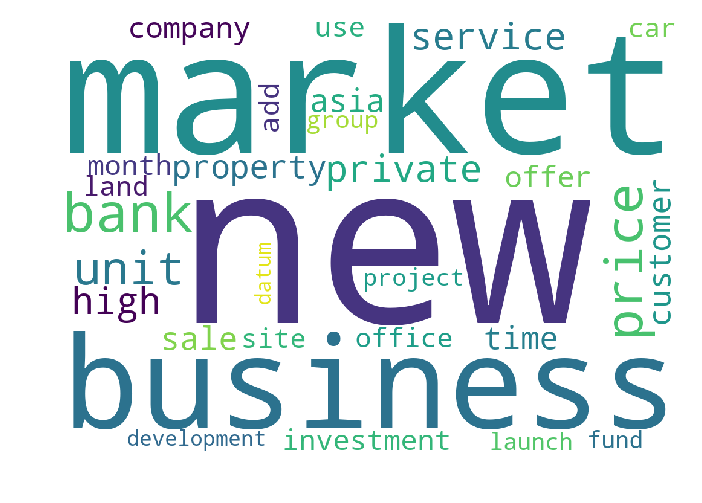



THE TOP 30 WORDS FOR TOPIC #5
['growth', 'high', 'presidential', 'political', 'come', 'dollar', 'day', 'american', 'rise', 'government', 'interest', 'state', 'new', 'week', 'global', 'country', 'world', 'japan', 'economy', 'economic', 'bank', 'election', 'time', 'trade', 'rate', 'china', 'president', 'policy', 'market', 'trump']


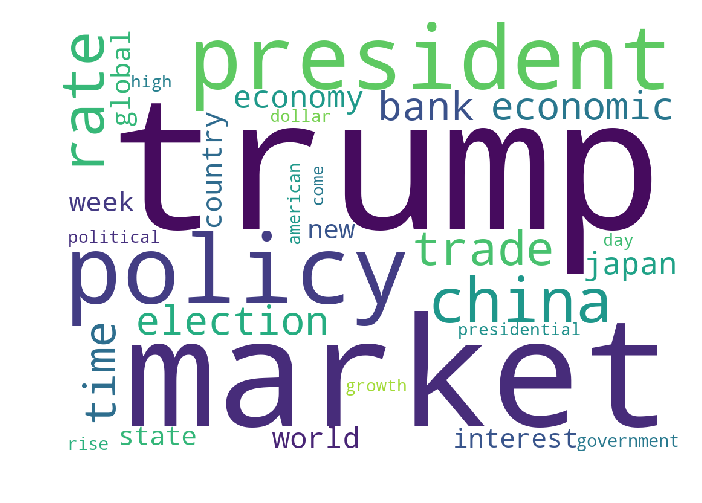





Forming document term matrix for 2017Q1...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2017Q1...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2017Q1 #####


THE TOP 30 WORDS FOR TOPIC #1
['capital', 'issue', 'month', 'customer', 'low', 'shareholder', 'firm', 'cost', 'base', 'include', 'high', 'use', 'payment', 'group', 'government', 'add', 'need', 'service', 'board', 'financial', 'investment', 'investor', 'director', 'time', 'bank', 'fund', 'business', 'new', 'market', 'company']


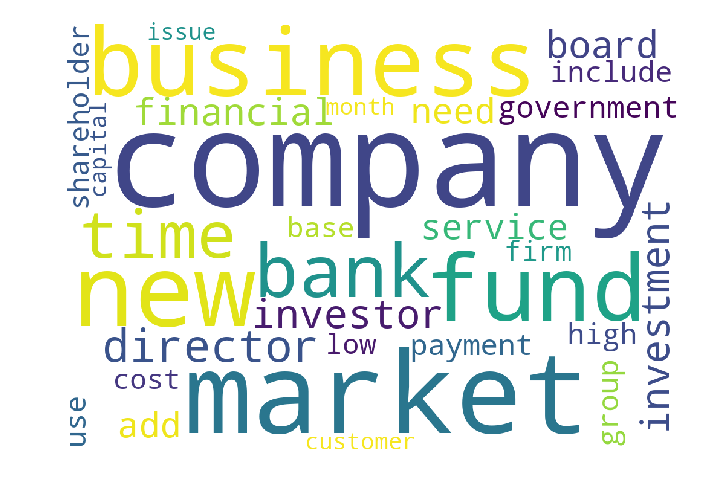



THE TOP 30 WORDS FOR TOPIC #2
['start', 'include', 'support', 'job', 'country', 'art', 'china', 'want', 'industry', 'look', 'technology', 'hong kong', 'way', 'kong', 'hong', 'asia', 'use', 'government', 'help', 'come', 'world', 'like', 'people', 'good', 'need', 'company', 'new', 'time', 'work', 'business']


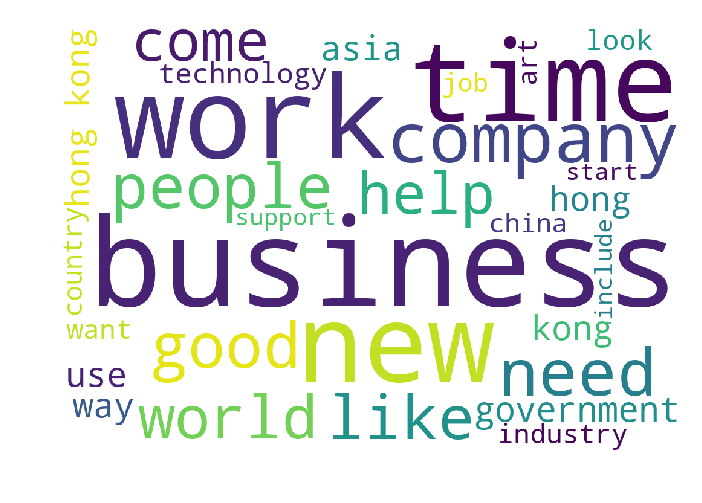



THE TOP 30 WORDS FOR TOPIC #3
['asset', '2015', 'sale', 'financial', 'march', 'expect', 'trade', 'earning', 'value', 'low', 'loss', 'average', 'holding', 'end', 'billion', 'investment', 'close', 'stock', 'quarter', 'market', 'high', 'business', 'profit', 'revenue', 'net', 'company', 'price', '2016', 'group', 'share']


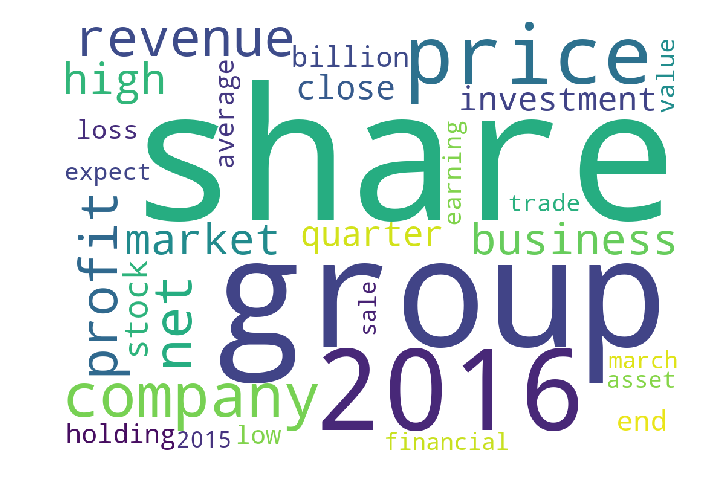



THE TOP 30 WORDS FOR TOPIC #4
['city', 'include', 'housing', 'sell', 'site', 'business', 'government', 'company', 'high', 'expect', '2016', 'industrial', 'building', 'estate', 'area', 'use', 'residential', 'space', 'office', 'group', 'developer', 'sale', 'land', 'new', 'market', 'price', 'development', 'project', 'unit', 'property']


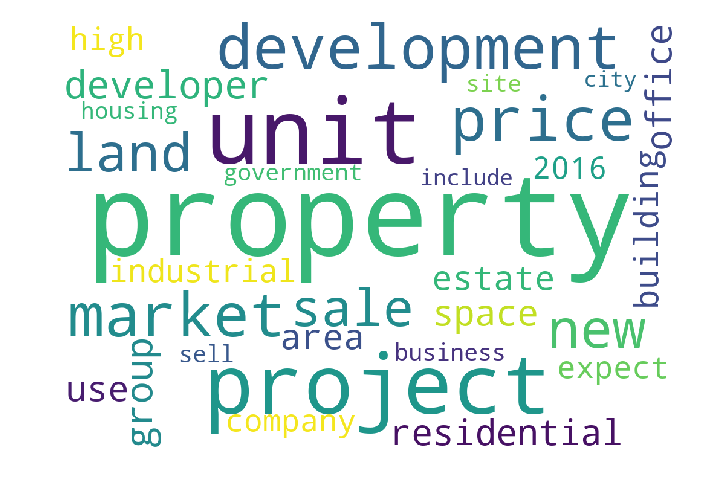



THE TOP 30 WORDS FOR TOPIC #5
['month', 'oil', 'point', 'good', 'report', '2017', 'sector', 'week', 'expect', 'tax', 'come', 'japan', 'time', 'global', 'billion', 'economic', 'price', 'policy', 'economy', 'high', 'president', 'new', 'china', 'rise', 'bank', 'rate', 'growth', 'trade', 'market', 'trump']


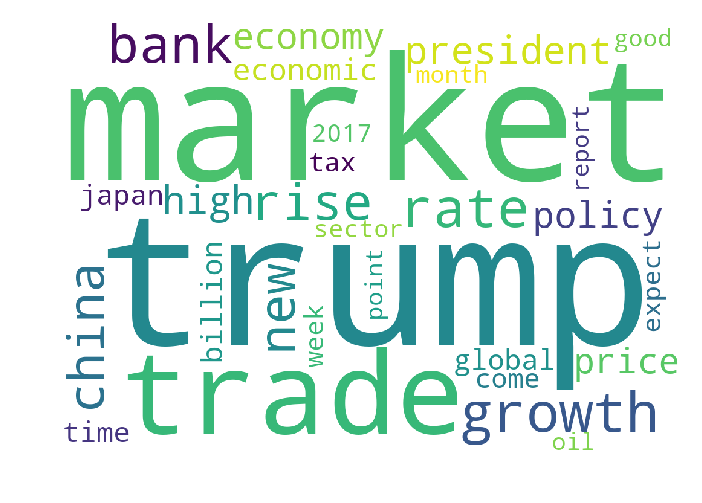





Forming document term matrix for 2017Q2...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2017Q2...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2017Q2 #####


THE TOP 30 WORDS FOR TOPIC #1
['future', 'change', 'programme', 'lng', 'way', 'provide', 'include', 'support', 'management', 'add', 'development', 'director', 'sme', 'good', 'customer', 'market', 'sector', 'help', 'board', 'maritime', 'service', 'use', 'need', 'new', 'time', 'technology', 'work', 'industry', 'business', 'company']


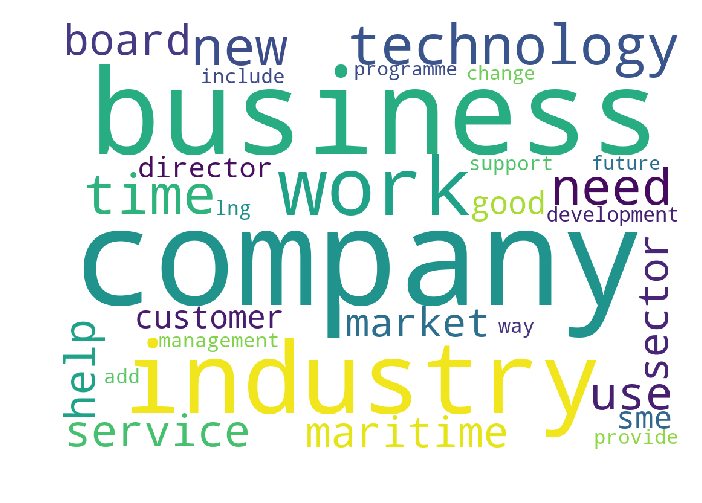



THE TOP 30 WORDS FOR TOPIC #2
['hotel', 'billion', 'reit', 'area', 'office', 'expect', '2017', 'business', 'end', 'sell', 'month', 'march', 'private', 'group', 'residential', 'high', 'site', 'income', 'new', 'net', 'developer', 'development', 'quarter', 'land', 'price', 'sale', 'project', 'market', 'unit', 'property']


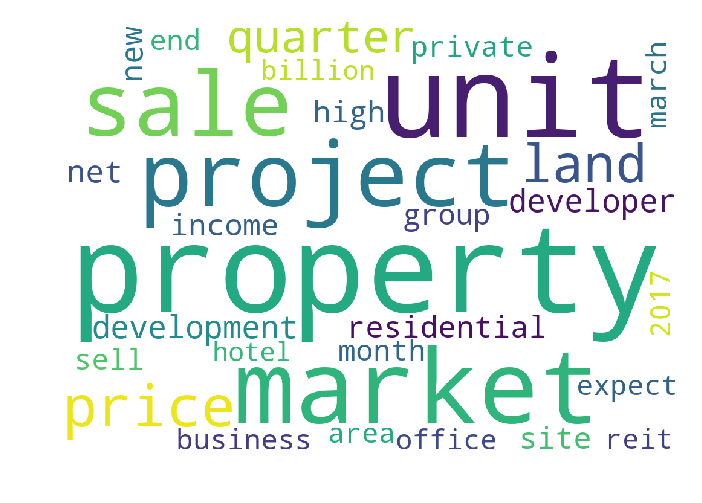



THE TOP 30 WORDS FOR TOPIC #3
['oil', 'ago', 'fall', 'billion', 'trade', 'close', 'earning', 'end', 'low', 'increase', 'rise', 'april', 'expect', 'business', 'stock', 'month', 'growth', 'march', 'profit', '2016', 'net', 'company', 'high', '2017', 'revenue', 'market', 'quarter', 'group', 'price', 'share']


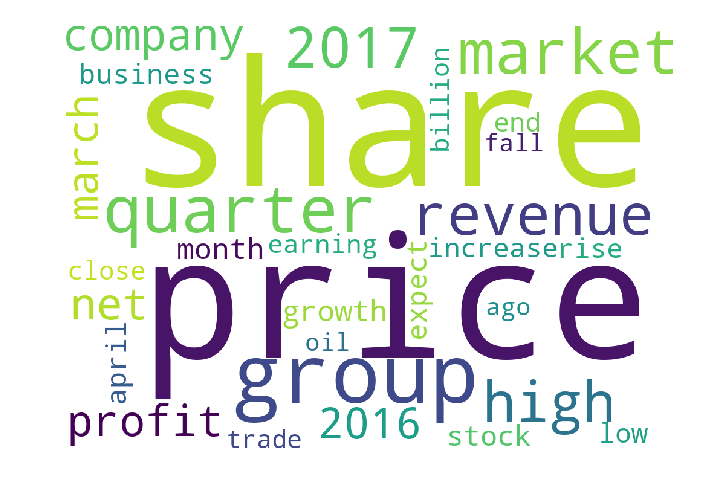



THE TOP 30 WORDS FOR TOPIC #4
['government', 'hong kong', 'include', 'come', 'fund', 'world', 'country', 'economy', 'state', 'japan', 'high', 'billion', 'investor', 'policy', 'business', 'company', 'new', 'investment', 'time', 'economic', 'growth', 'global', 'financial', 'bank', 'asia', 'president', 'trade', 'trump', 'china', 'market']


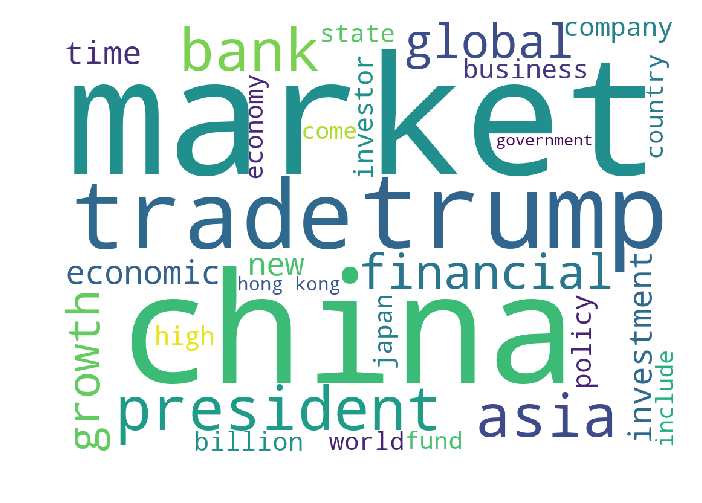



THE TOP 30 WORDS FOR TOPIC #5
['start', 'help', 'country', 'add', 'product', 'look', 'life', 'technology', 'include', 'old', 'service', 'day', 'find', 'company', 'grow', 'asia', 'want', 'way', 'food', 'come', 'need', 'world', 'people', 'business', 'use', 'good', 'like', 'time', 'work', 'new']


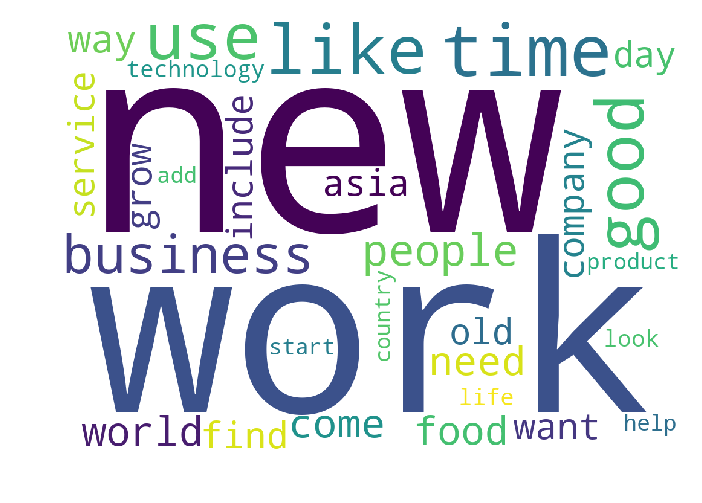





Forming document term matrix for 2017Q3...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2017Q3...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2017Q3 #####


THE TOP 30 WORDS FOR TOPIC #1
['revenue', 'net', 'time', 'low', 'project', 'end', 'stock', 'development', 'sector', 'new', 'rate', 'unit', 'rise', 'expect', 'investment', 'sale', '2017', 'month', 'business', 'quarter', 'company', 'property', 'bank', 'billion', 'group', 'share', 'growth', 'high', 'price', 'market']


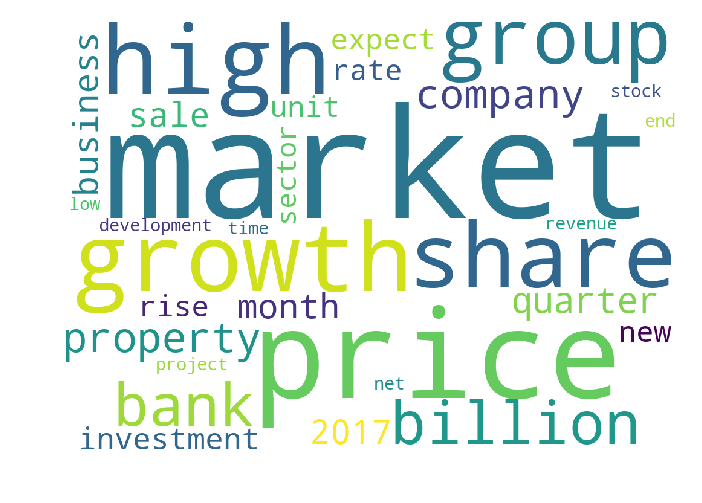



THE TOP 30 WORDS FOR TOPIC #2
['create', 'start', 'change', 'country', 'add', 'customer', 'car', 'include', 'digital', 'day', 'design', 'want', 'service', 'look', 'industry', 'way', 'help', 'technology', 'come', 'good', 'world', 'need', 'use', 'like', 'people', 'time', 'company', 'work', 'new', 'business']


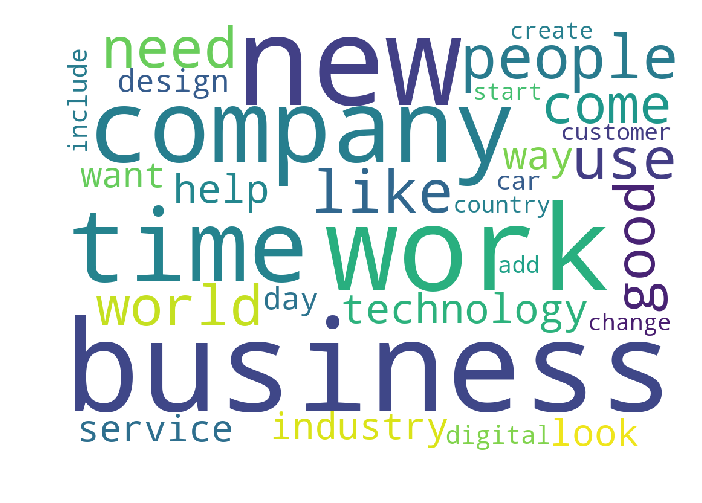



THE TOP 30 WORDS FOR TOPIC #3
['noble', 'asia', 'hong', 'airline', 'airport', 'wine', 'road', 'market', 'trade', 'bank', 'point', 'include', 'international', 'financial', 'cash', 'payment', 'award', 'vessel', 'time', 'india', 'country', 'good', 'new', 'team', 'chinese', 'service', 'business', 'company', 'group', 'china']


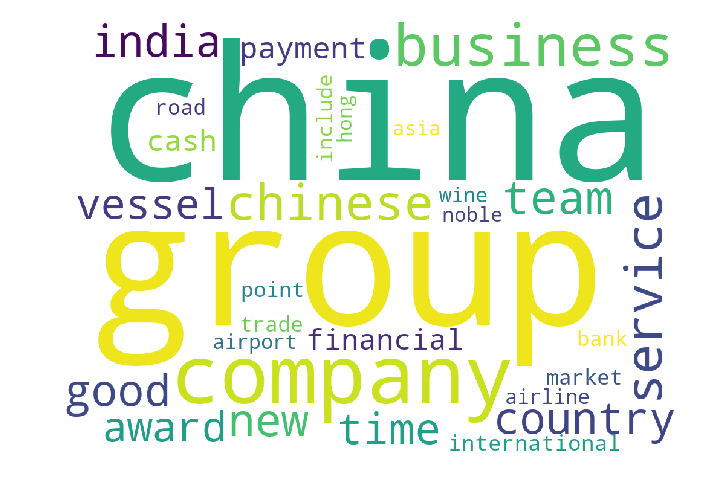



THE TOP 30 WORDS FOR TOPIC #4
['report', 'group', 'financial', 'foreign', 'high', 'world', 'market', 'north korea', 'economic', 'investment', 'asia', 'target', 'company', 'policy', 'country', 'political', 'information', 'state', 'time', 'government', 'price', 'business', 'new', 'korea', 'trade', 'president', 'japan', 'north', 'trump', 'china']


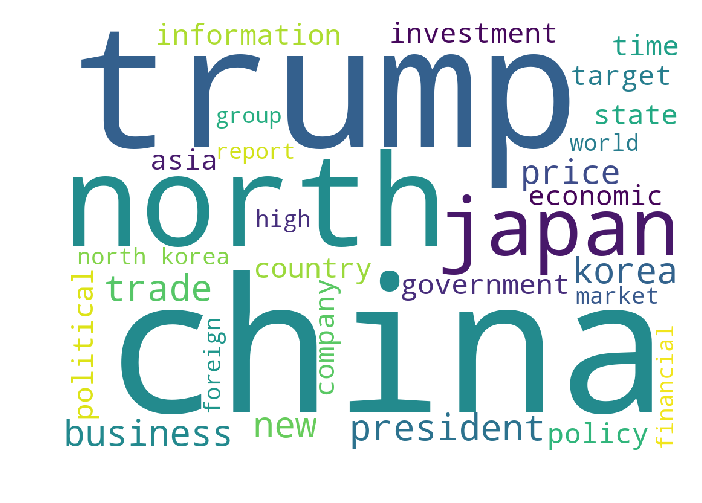



THE TOP 30 WORDS FOR TOPIC #5
['organisation', 'contract', 'exchange', 'asset', 'term', 'risk', 'share', 'financial', 'employee', 'sgx', 'market', 'executive', 'group', 'report', 'list', 'ceo', 'corporate governance', 'trust', 'reit', 'value', 'management', 'investor', 'director', 'good', 'shareholder', 'board', 'business', 'governance', 'corporate', 'company']


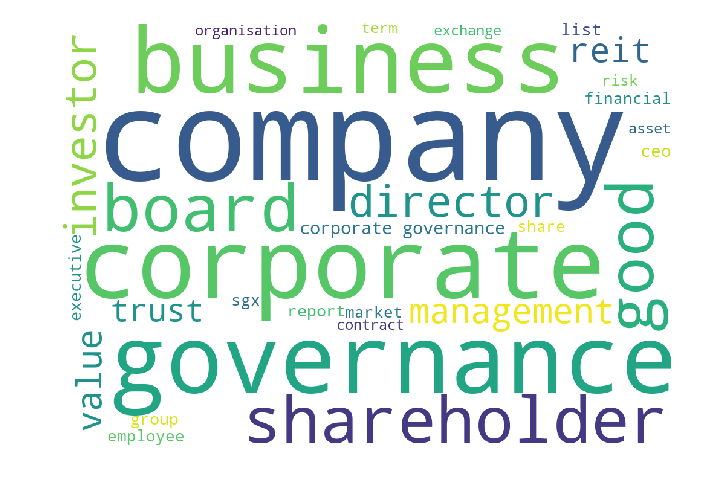





Forming document term matrix for 2017Q4...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2017Q4...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2017Q4 #####


THE TOP 30 WORDS FOR TOPIC #1
['revenue', '2017', 'developer', 'close', 'development', 'land', 'asset', 'time', 'new', 'investment', 'bank', 'net', 'end', 'billion', 'expect', 'rise', 'month', 'site', 'growth', 'quarter', 'stock', 'rate', 'group', 'share', 'unit', 'sale', 'high', 'property', 'price', 'market']


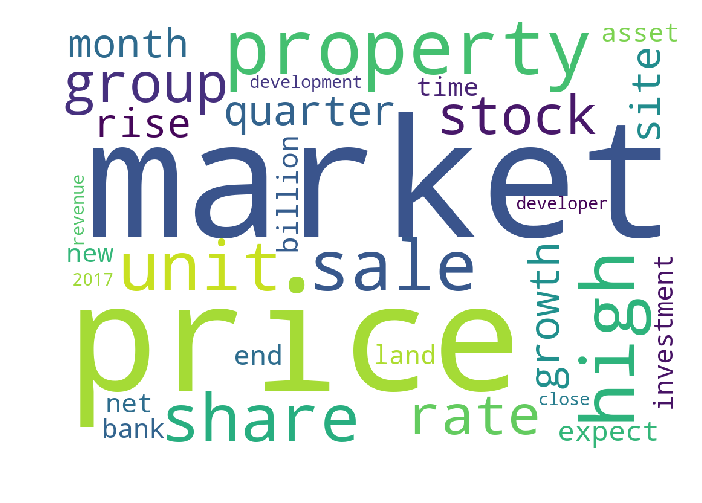



THE TOP 30 WORDS FOR TOPIC #2
['provide', 'high', 'solution', 'firm', 'include', 'system', 'asia', 'add', 'product', 'datum', 'digital', 'project', 'market', 'energy', 'group', 'management', 'help', 'need', 'sector', 'bank', 'time', 'use', 'industry', 'work', 'customer', 'technology', 'new', 'service', 'company', 'business']


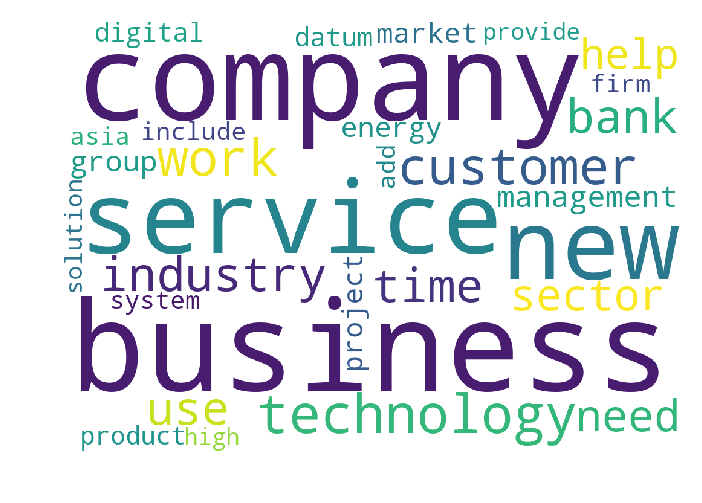



THE TOP 30 WORDS FOR TOPIC #3
['family', 'market', 'home', 'open', 'want', 'use', 'people', 'brand', 'director', 'restaurant', 'look', 'design', 'list', 'hotel', 'car', 'day', 'include', 'come', 'shareholder', 'price', 'good', 'work', 'offer', 'business', 'like', 'time', 'group', 'new', 'share', 'company']


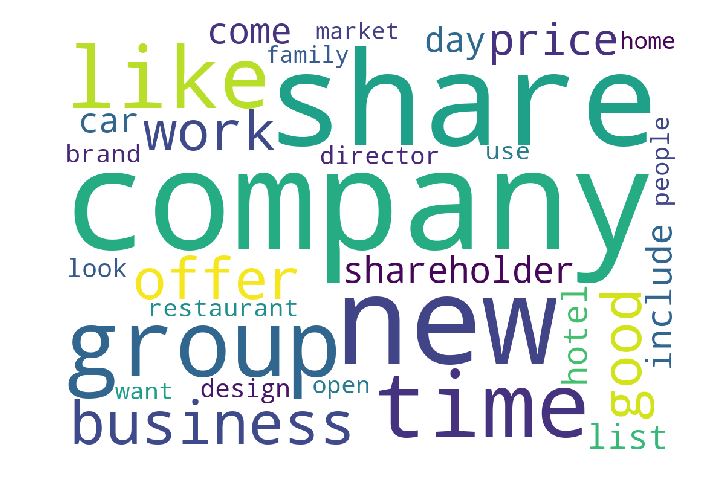



THE TOP 30 WORDS FOR TOPIC #4
['number', 'gst', 'big', 'service', '2018', 'grow', 'rise', 'deal', 'rate', 'economist', 'good', 'quarter', '2017', 'world', 'price', 'increase', 'business', 'government', 'new', 'game', 'bitcoin', 'tax', 'come', 'expect', 'time', 'market', 'high', 'month', 'billion', 'growth']


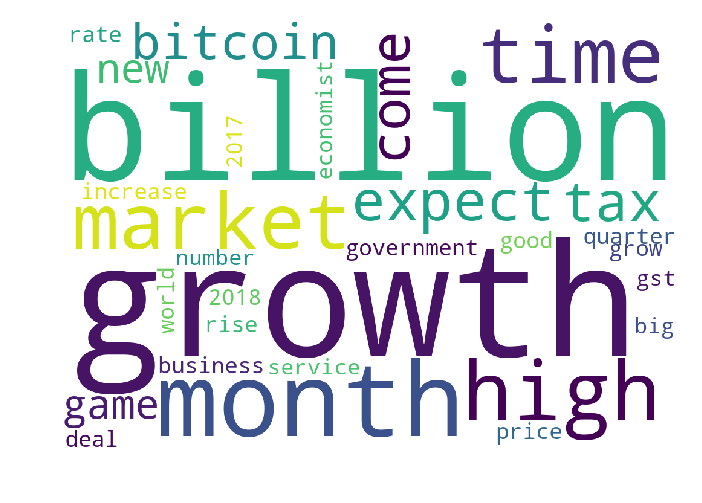



THE TOP 30 WORDS FOR TOPIC #5
['investment', 'include', 'government', 'economy', 'international', 'state', 'region', 'work', 'industry', 'asean', 'fintech', 'service', 'president', 'bank', 'trump', 'economic', 'need', 'technology', 'time', 'company', 'asia', 'country', 'global', 'new', 'world', 'trade', 'market', 'financial', 'business', 'china']


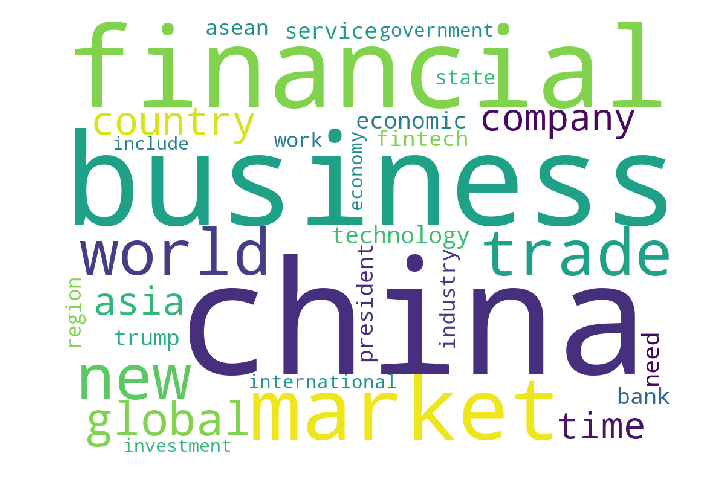





Forming document term matrix for 2018Q1...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2018Q1...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2018Q1 #####


THE TOP 30 WORDS FOR TOPIC #1
['investor', 'plan', 'financial', 'firm', 'use', 'service', 'rate', 'board', 'developer', 'high', 'share', 'shareholder', 'director', 'bank', 'government', 'time', 'project', 'unit', 'land', 'property', 'site', 'group', 'tax', 'development', 'sale', 'new', 'business', 'price', 'market', 'company']


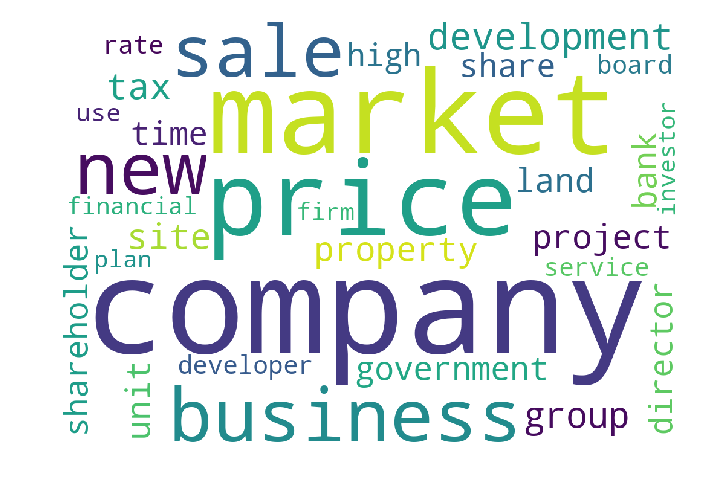



THE TOP 30 WORDS FOR TOPIC #2
['north', 'big', 'high', 'home', 'city', 'large', 'watch', 'good', 'house', 'company', 'art', 'open', 'brand', 'service', 'look', 'offer', 'world', 'event', 'asia', 'day', 'work', 'include', 'group', 'use', 'like', 'come', 'design', 'car', 'time', 'new']


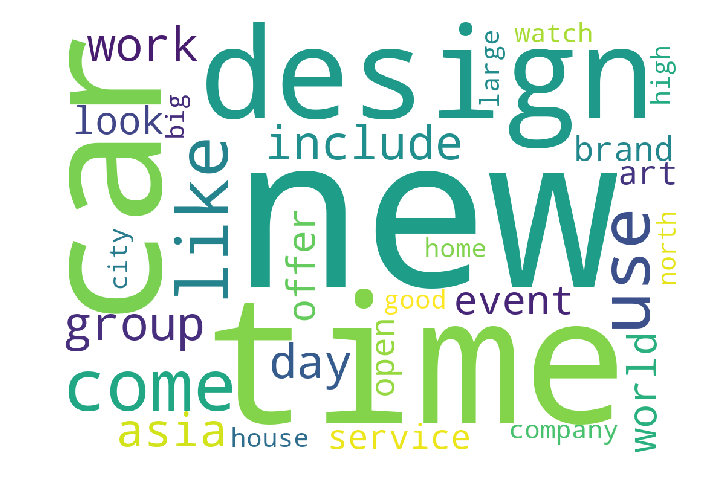



THE TOP 30 WORDS FOR TOPIC #3
['investor', 'trade', 'unit', 'business', 'earning', '2018', 'month', 'end', 'company', 'rate', 'asset', 'profit', 'close', 'reit', 'revenue', 'growth', 'investment', 'rise', 'quarter', 'expect', 'net', 'stock', 'property', 'billion', 'high', '2017', 'group', 'price', 'share', 'market']


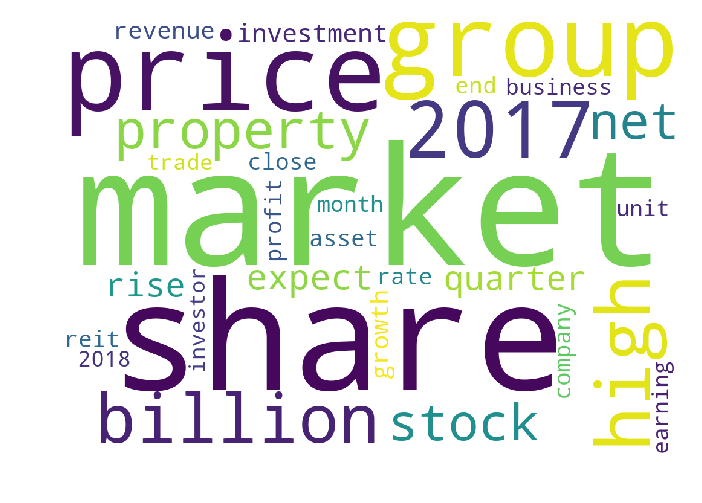



THE TOP 30 WORDS FOR TOPIC #4
['digital', 'look', 'bank', 'firm', 'come', 'include', 'use', 'help', 'government', 'economy', 'like', 'people', 'economic', 'asia', 'need', 'market', 'work', 'good', 'world', 'country', 'global', 'growth', 'time', 'industry', 'technology', 'china', 'trade', 'new', 'company', 'business']


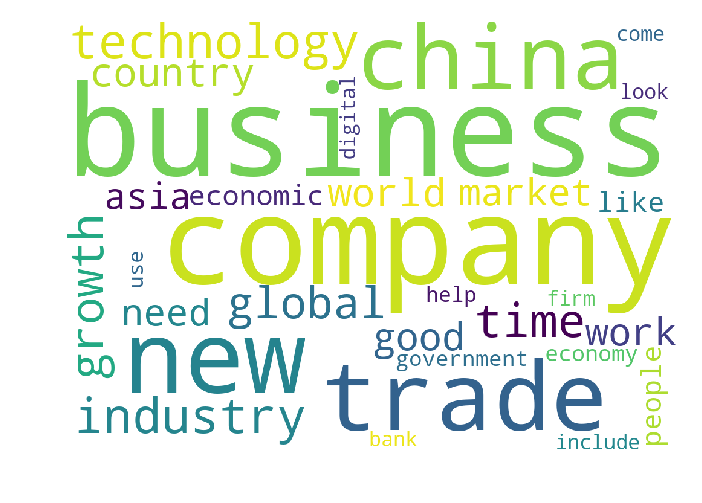



THE TOP 30 WORDS FOR TOPIC #5
['datum', 'life', 'job', 'plan', 'healthcare', 'high', 'day', 'start', 'people', 'cost', 'help', 'product', 'use', 'come', 'news', 'online', 'group', 'customer', 'need', 'good', 'add', 'service', 'include', 'industry', 'market', 'work', 'company', 'time', 'business', 'new']


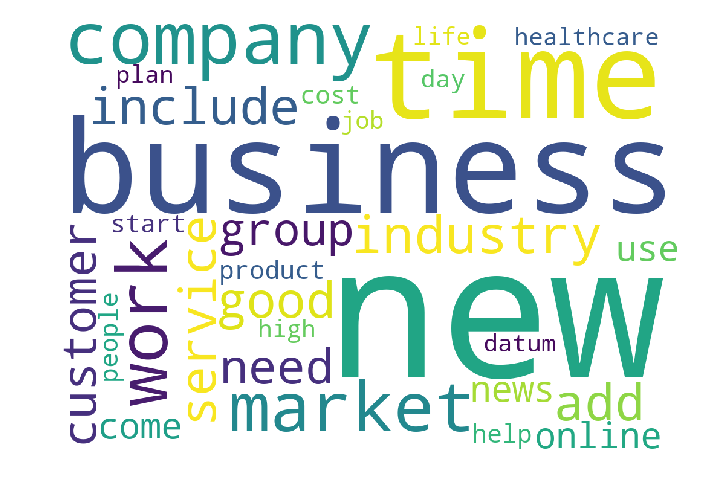





Forming document term matrix for 2018Q2...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2018Q2...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2018Q2 #####


THE TOP 30 WORDS FOR TOPIC #1
['like', 'price', 'include', 'datum', 'cost', 'asia', 'good', 'work', 'add', 'need', 'technology', 'come', 'group', 'share', 'digital', 'high', 'firm', 'use', 'payment', 'shareholder', 'offer', 'car', 'service', 'customer', 'time', 'new', 'bank', 'market', 'business', 'company']


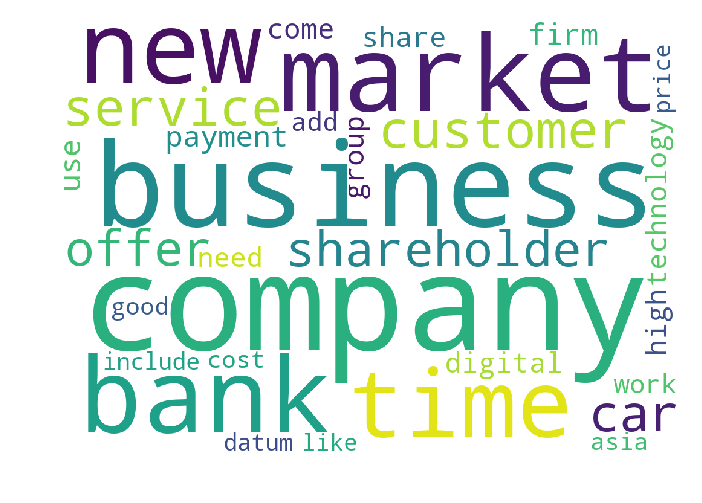



THE TOP 30 WORDS FOR TOPIC #2
['march', 'increase', 'end', 'project', 'investment', 'earning', 'close', 'rate', 'profit', 'new', 'revenue', 'stock', 'billion', 'china', 'trade', 'month', 'sale', 'net', '2018', 'rise', 'growth', 'expect', 'unit', 'group', 'high', 'quarter', 'property', 'share', 'market', 'price']


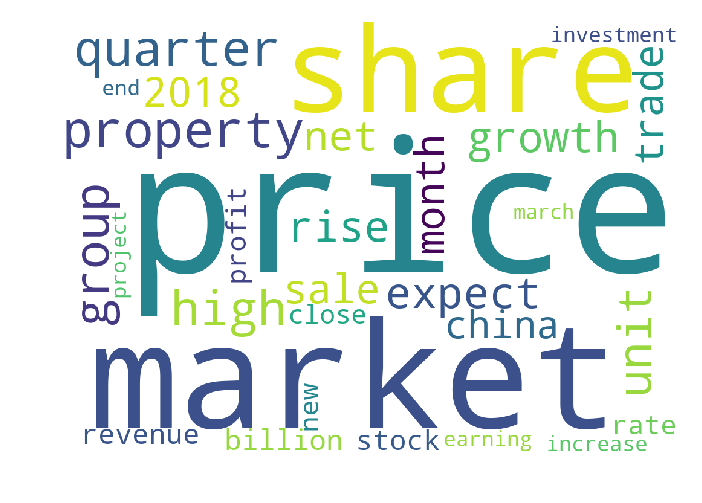



THE TOP 30 WORDS FOR TOPIC #3
['american', 'north', 'create', 'need', 'know', 'company', 'open', 'noble', 'include', 'president', 'brand', 'art', 'design', 'day', 'start', 'way', 'look', 'food', 'restaurant', 'use', 'trump', 'people', 'come', 'world', 'want', 'good', 'new', 'like', 'time', 'work']


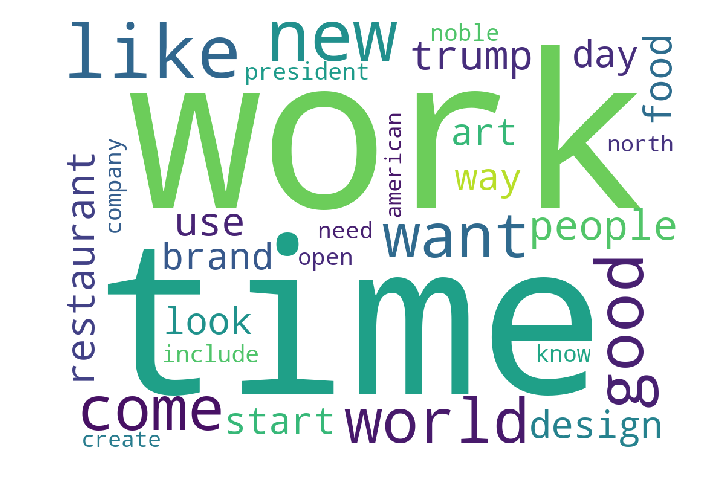



THE TOP 30 WORDS FOR TOPIC #4
['firm', 'include', 'employee', 'growth', 'add', 'development', 'economy', 'economic', 'good', 'minister', 'service', 'use', 'global', 'help', 'time', 'asia', 'people', 'government', 'world', 'need', 'datum', 'country', 'industry', 'technology', 'china', 'work', 'trade', 'new', 'company', 'business']


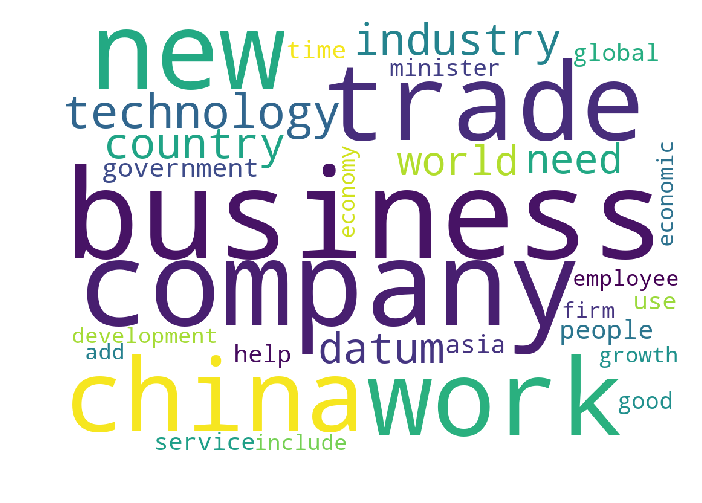



THE TOP 30 WORDS FOR TOPIC #5
['asset', 'management', 'executive', 'price', 'firm', 'base', 'director', 'include', 'capital', 'billion', 'asia', 'exchange', 'development', 'time', 'fund', 'share', 'service', 'site', 'bank', 'investment', 'sale', 'sgx', 'group', 'list', 'financial', 'investor', 'new', 'business', 'market', 'company']


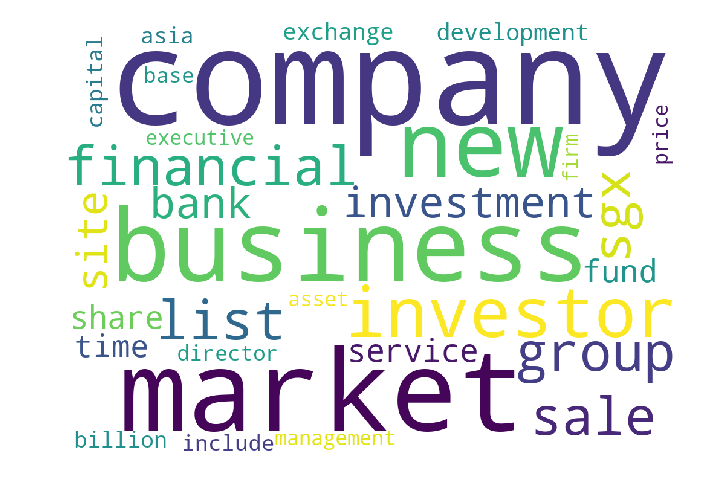





Forming document term matrix for 2018Q3...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2018Q3...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2018Q3 #####


THE TOP 30 WORDS FOR TOPIC #1
['time', 'second', 'increase', 'development', 'economy', 'share', 'low', 'new', 'end', 'july', 'investment', 'stock', 'close', 'measure', 'expect', 'quarter', 'rate', 'sale', 'month', 'billion', 'unit', 'rise', 'bank', 'high', 'growth', 'china', 'trade', 'property', 'price', 'market']


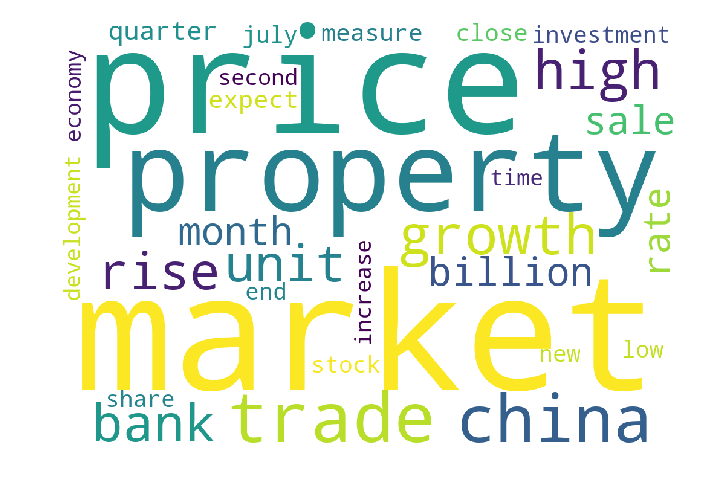



THE TOP 30 WORDS FOR TOPIC #2
['trade', 'asia', 'cost', 'digital', 'sector', 'minister', 'government', 'firm', 'datum', 'need', 'time', 'project', 'energy', 'work', 'company', 'global', 'water', 'asean', 'add', 'financial', 'include', 'market', 'system', 'technology', 'industry', 'business', 'use', 'bank', 'service', 'new']


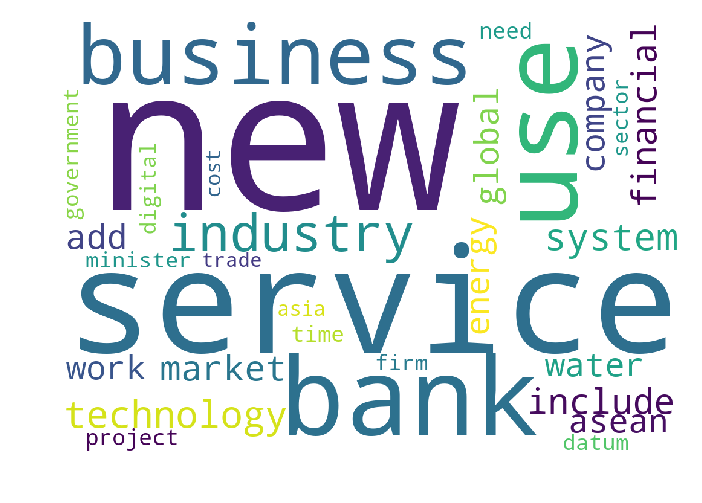



THE TOP 30 WORDS FOR TOPIC #3
['china', 'office', 'acquisition', 'fund', 'management', 'revenue', 'financial', 'end', 'sgx', 'net', 'close', 'reit', 'capital', 'property', 'list', 'high', 'billion', 'exchange', 'price', 'new', 'investment', 'asset', 'offer', 'business', 'investor', 'shareholder', 'group', 'market', 'company', 'share']


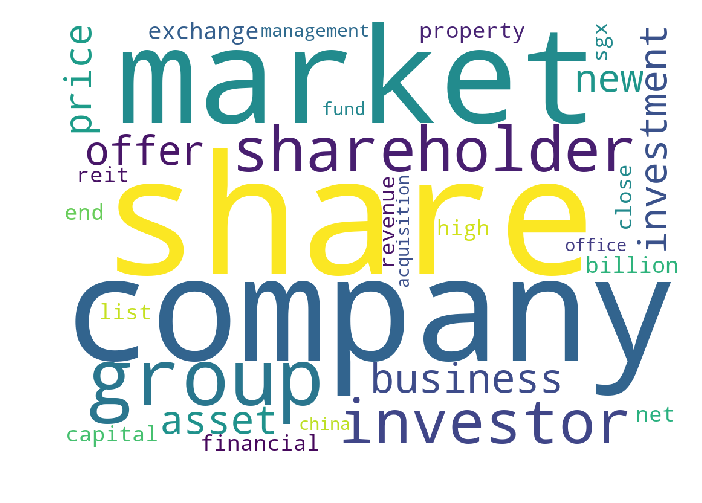



THE TOP 30 WORDS FOR TOPIC #4
['community', 'ceo', 'regional', 'economy', 'management', 'new', 'include', 'trust', 'award', 'long', 'market', 'region', 'investor', 'asia', 'diversity', 'time', 'world', 'economic', 'china', 'director', 'country', 'corporate governance', 'asean', 'corporate', 'governance', 'trade', 'board', 'good', 'business', 'company']


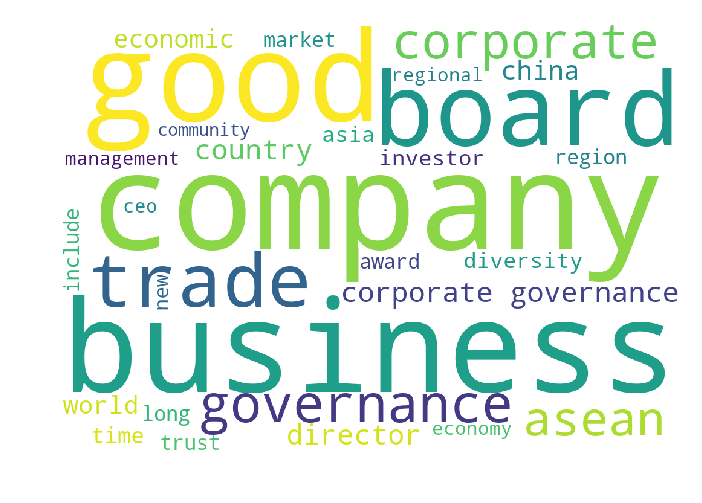



THE TOP 30 WORDS FOR TOPIC #5
['add', 'digital', 'design', 'industry', 'group', 'customer', 'want', 'look', 'way', 'asia', 'firm', 'create', 'come', 'team', 'include', 'market', 'good', 'help', 'service', 'world', 'people', 'like', 'need', 'technology', 'use', 'time', 'new', 'work', 'company', 'business']


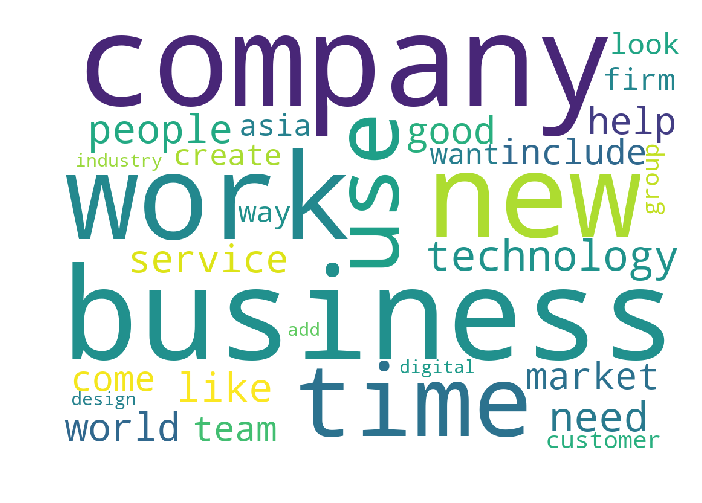





Forming document term matrix for 2018Q4...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2018Q4...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2018Q4 #####


THE TOP 30 WORDS FOR TOPIC #1
['billion', 'investor', 'trump', 'rise', 'economy', 'president', 'site', 'index', 'chinese', 'end', 'high', 'deal', 'close', 'economic', 'new', 'sale', 'time', 'week', 'global', 'expect', 'stock', 'development', 'month', 'growth', 'property', 'unit', 'price', 'trade', 'china', 'market']


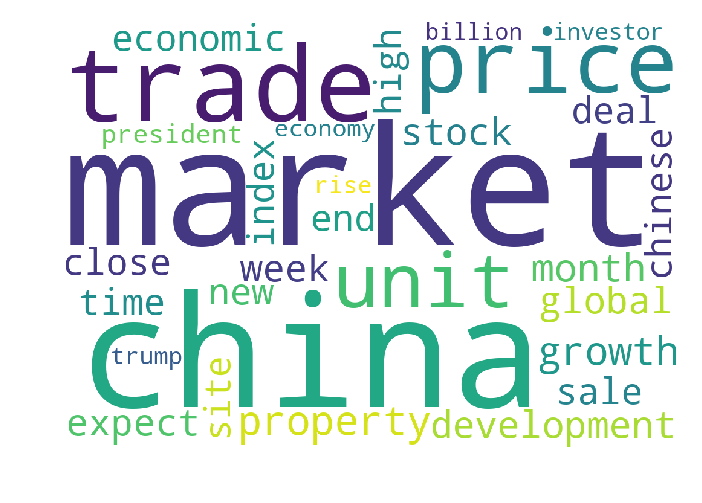



THE TOP 30 WORDS FOR TOPIC #2
['base', 'app', 'product', 'point', 'retail', 'risk', 'grab', 'global', 'fuel', 'investment', 'need', 'firm', 'good', 'country', 'add', 'work', 'car', 'offer', 'high', 'investor', 'bond', 'new', 'use', 'company', 'time', 'business', 'asia', 'service', 'market', 'payment']


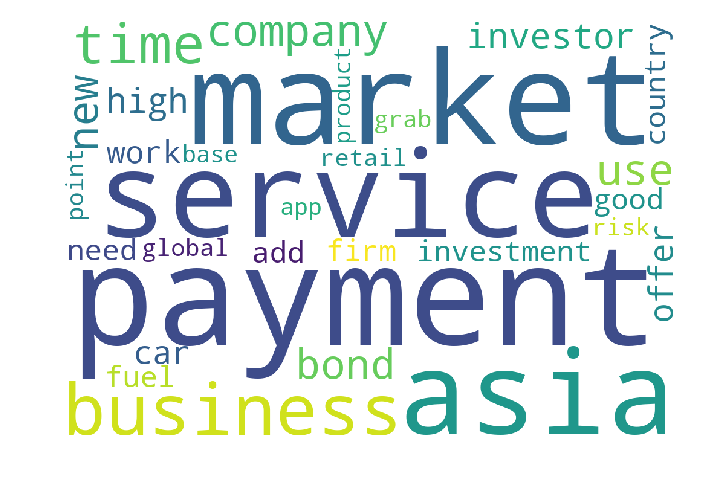



THE TOP 30 WORDS FOR TOPIC #3
['value', 'rise', 'capital', 'management', '30', 'fund', 'low', 'month', 'end', 'asset', 'reit', 'project', 'profit', '2018', 'property', 'expect', 'investment', 'billion', 'energy', 'new', 'net', 'quarter', 'revenue', 'high', 'price', 'business', 'market', 'group', 'company', 'share']


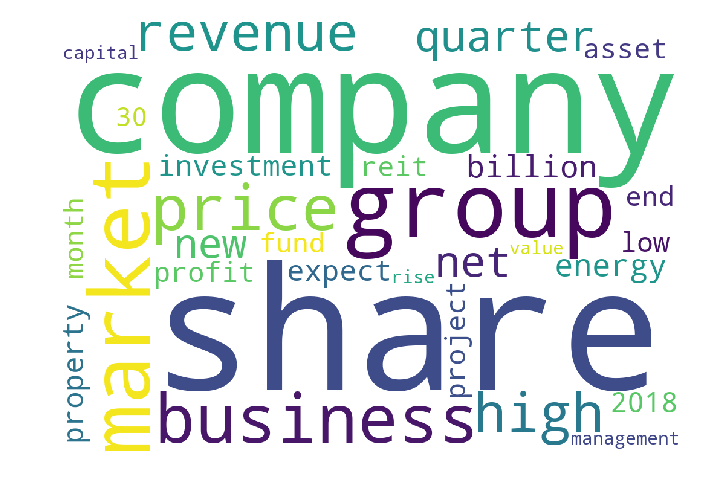



THE TOP 30 WORDS FOR TOPIC #4
['country', 'investment', 'add', 'fintech', 'development', 'innovation', 'solution', 'system', 'growth', 'global', 'work', 'customer', 'time', 'asean', 'firm', 'help', 'datum', 'use', 'need', 'asia', 'financial', 'industry', 'new', 'digital', 'market', 'service', 'bank', 'technology', 'company', 'business']


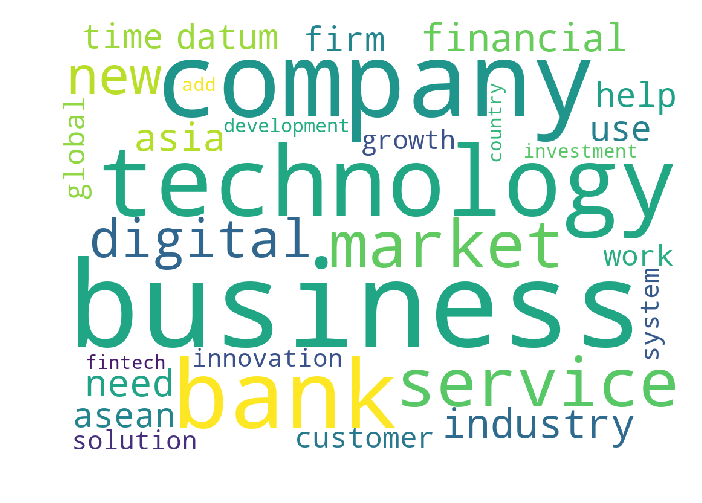



THE TOP 30 WORDS FOR TOPIC #5
['live', 'director', 'start', 'chef', 'restaurant', 'help', 'know', 'create', 'design', 'include', 'day', 'use', 'life', 'brand', 'art', 'look', 'way', 'food', 'come', 'want', 'business', 'need', 'company', 'world', 'people', 'good', 'like', 'time', 'work', 'new']


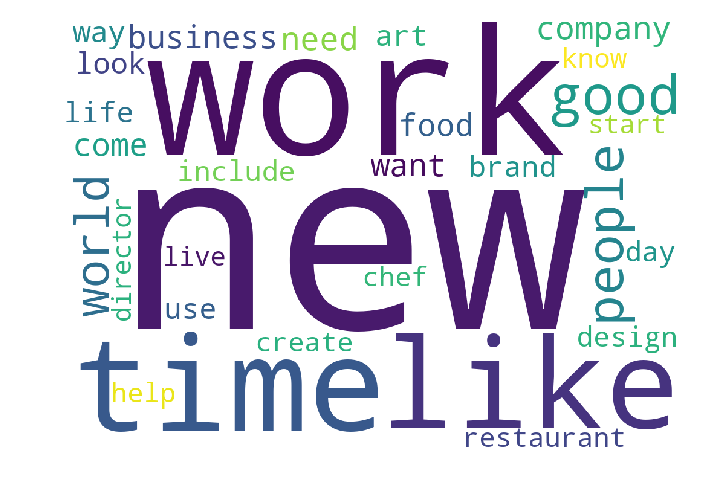





Forming document term matrix for 2019Q1...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2019Q1...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2019Q1 #####


THE TOP 30 WORDS FOR TOPIC #1
['business', 'rise', 'quarter', 'increase', 'brexit', 'time', 'office', 'real', 'area', 'group', 'estate', 'rate', 'month', 'development', 'unit', 'new', 'deal', 'china', '2019', 'high', 'sale', 'investment', 'asset', 'expect', '2018', 'reit', 'growth', 'price', 'market', 'property']


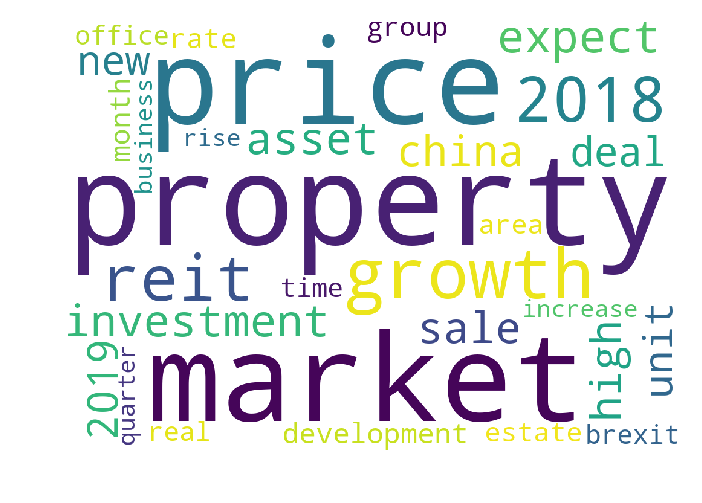



THE TOP 30 WORDS FOR TOPIC #2
['note', 'new', 'analyst', 'low', 'gain', 'trading', 'deal', 'billion', 'global', 'add', 'expect', 'point', 'investor', 'growth', 'month', 'time', 'unit', 'bank', 'week', 'index', 'high', 'day', 'end', 'stock', 'close', 'share', 'price', 'china', 'trade', 'market']


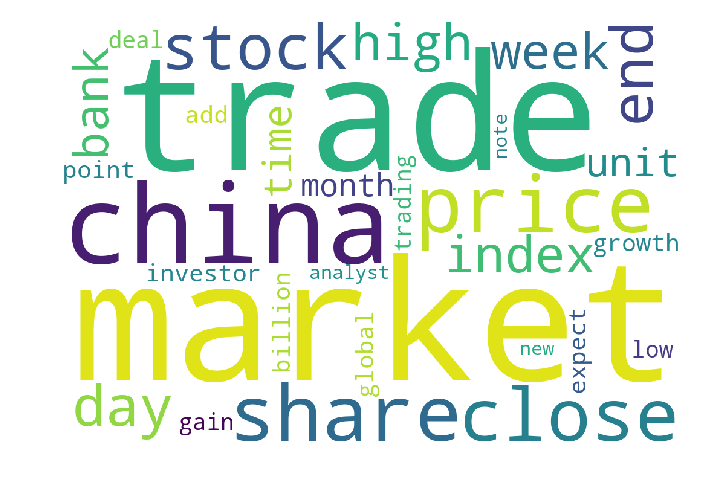



THE TOP 30 WORDS FOR TOPIC #3
['asia', 'look', 'support', 'government', 'organisation', 'bank', 'include', 'datum', 'president', 'digital', 'service', 'come', 'change', 'world', 'use', 'way', 'customer', 'industry', 'like', 'good', 'innovation', 'help', 'technology', 'people', 'company', 'need', 'time', 'work', 'new', 'business']


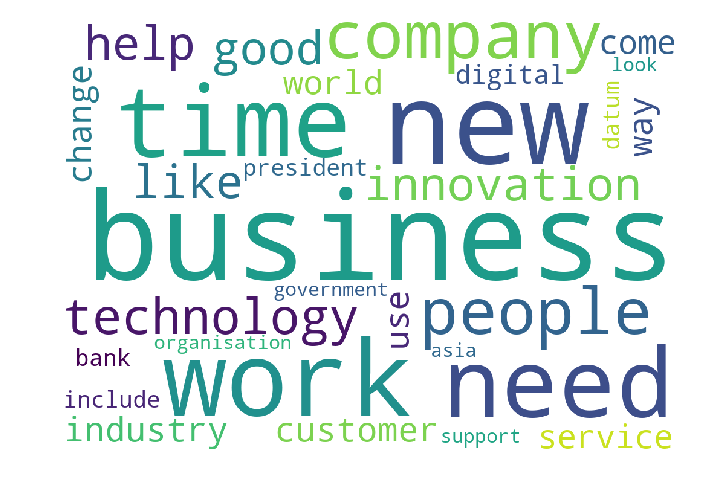



THE TOP 30 WORDS FOR TOPIC #4
['product', 'digital', 'house', 'risk', 'market', 'cyber', 'day', 'home', 'restaurant', 'datum', 'design', 'space', 'need', 'brand', 'come', 'chef', 'food', 'art', 'asia', 'look', 'use', 'include', 'world', 'work', 'company', 'time', 'like', 'good', 'new', 'business']


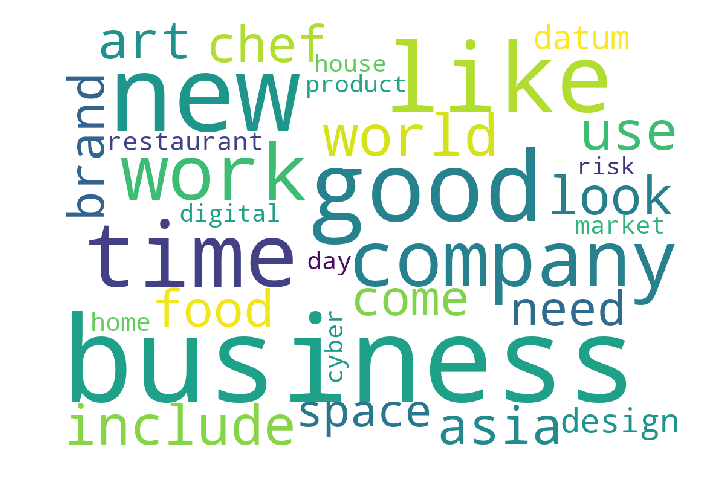



THE TOP 30 WORDS FOR TOPIC #5
['include', 'cost', 'list', 'add', 'bank', 'board', 'offer', 'time', 'project', 'shareholder', 'profit', 'high', 'fund', 'investor', 'net', 'capital', 'firm', 'tax', 'billion', 'investment', 'service', 'financial', 'revenue', 'new', '2018', 'market', 'group', 'business', 'share', 'company']


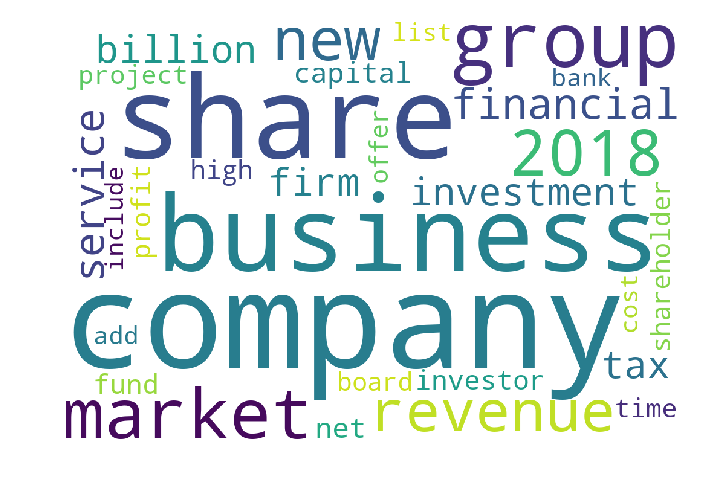





Forming document term matrix for 2019Q2...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2019Q2...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2019Q2 #####


THE TOP 30 WORDS FOR TOPIC #1
['solution', 'director', 'culture', 'development', 'value', 'firm', 'way', 'good', 'build', 'include', 'startup', 'market', 'provide', 'datum', 'use', 'industry', 'employee', 'service', 'customer', 'people', 'help', 'digital', 'time', 'new', 'asia', 'technology', 'need', 'company', 'work', 'business']


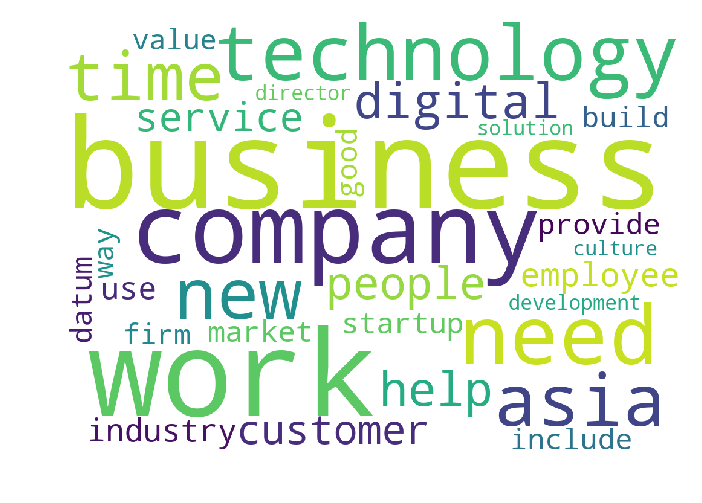



THE TOP 30 WORDS FOR TOPIC #2
['industry', 'include', 'project', 'high', 'list', 'billion', 'global', 'add', 'time', 'profit', 'expect', 'report', 'revenue', 'quarter', 'net', 'investment', '2018', 'firm', 'month', 'service', 'financial', 'growth', 'new', 'market', 'trade', 'share', 'group', 'business', 'china', 'company']


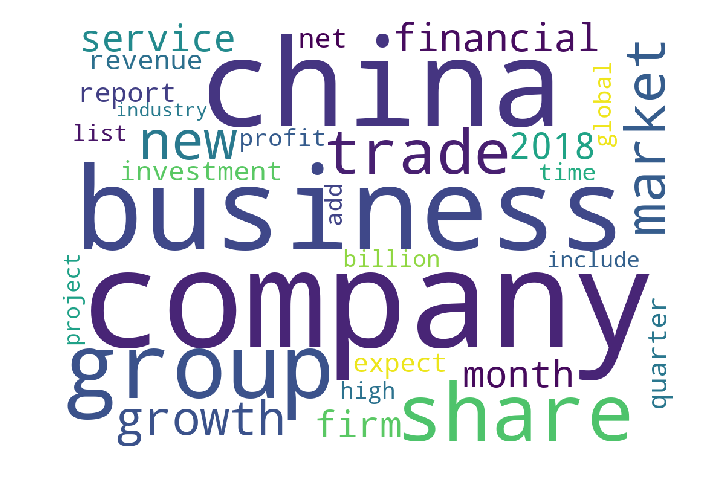



THE TOP 30 WORDS FOR TOPIC #3
['business', 'home', 'know', 'old', 'find', 'day', 'need', 'start', 'chef', 'include', 'experience', 'open', 'restaurant', 'way', 'people', 'use', 'work', 'art', 'design', 'want', 'food', 'look', 'brand', 'car', 'come', 'world', 'like', 'time', 'good', 'new']


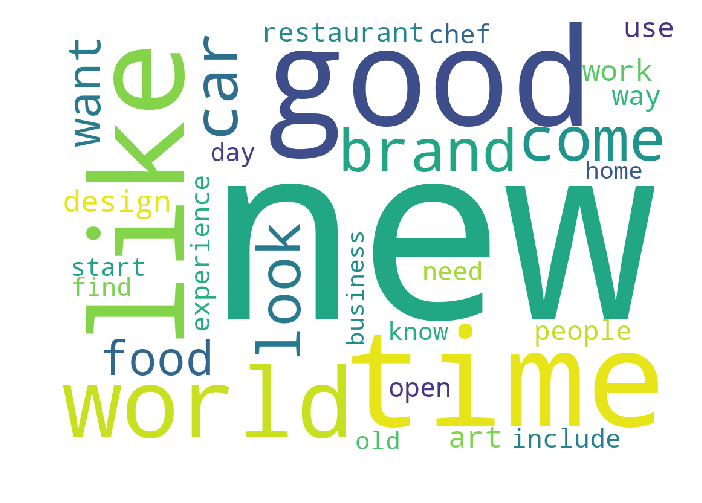



THE TOP 30 WORDS FOR TOPIC #4
['global', 'american', 'interest', 'equity', 'end', 'capital', 'dbs', 'rate', 'month', 'risk', 'company', 'term', 'policy', 'economic', 'high', 'business', 'time', 'group', 'reit', 'trade', 'asset', 'deal', 'president', 'investment', 'trump', 'bank', 'fund', 'hyflux', 'market', 'investor']


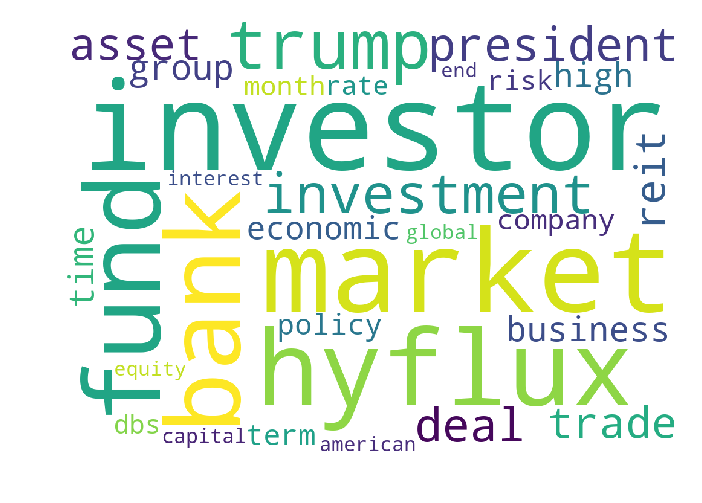



THE TOP 30 WORDS FOR TOPIC #5
['rate', 'asset', 'end', 'group', 'add', 'business', 'time', 'low', 'sale', 'trust', 'new', 'month', 'reit', '2019', 'investor', 'expect', 'quarter', 'growth', 'high', 'investment', 'china', 'billion', 'share', 'close', 'trade', 'unit', 'bank', 'property', 'price', 'market']


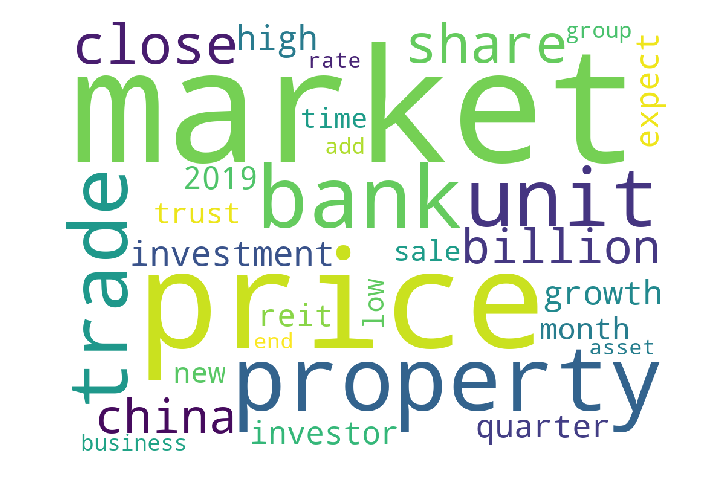





Forming document term matrix for 2019Q3...


/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:301: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


Modelling topics for 2019Q3...
iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


##### TOPICS FOR 2019Q3 #####


THE TOP 30 WORDS FOR TOPIC #1
['term', 'asset', 'interest', 'property', 'investor', 'point', 'economy', 'july', 'business', '2019', 'cut', 'close', 'month', 'low', 'time', 'economic', 'investment', 'billion', 'global', 'asia', 'quarter', 'high', 'expect', 'price', 'rate', 'growth', 'china', 'bank', 'trade', 'market']


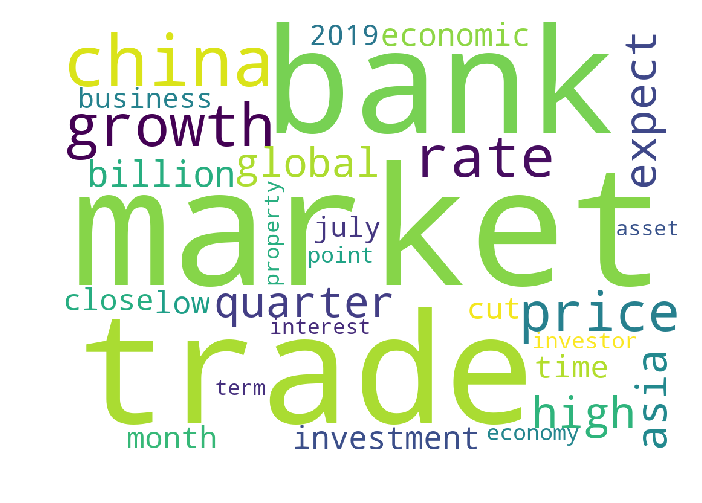



THE TOP 30 WORDS FOR TOPIC #2
['create', 'day', 'experience', 'look', 'country', 'industry', 'market', 'design', 'service', 'help', 'include', 'brand', 'technology', 'want', 'use', 'way', 'come', 'bank', 'world', 'people', 'like', 'good', 'customer', 'digital', 'need', 'time', 'work', 'company', 'new', 'business']


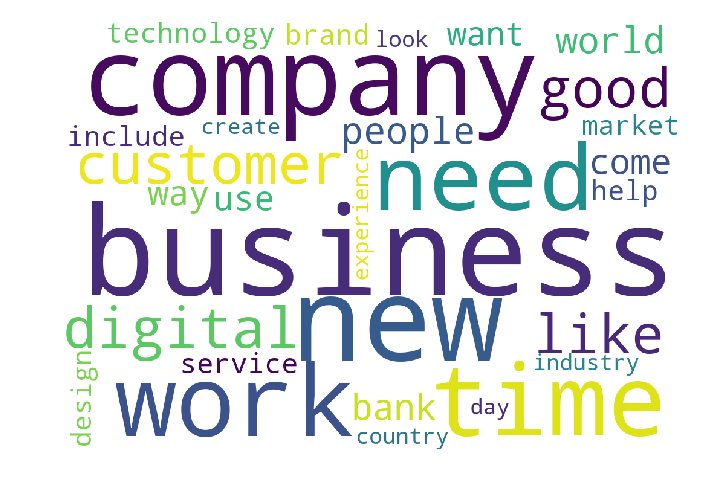



THE TOP 30 WORDS FOR TOPIC #3
['net profit', 'company', 'fall', 'low', 'rise', 'june 30', 'market', '2019', 'result', 'reit', 'new', 'income', 'ago', 'period', 'second', 'trust', 'unit', '30', 'end', 'month', 'high', 'profit', 'business', 'property', 'june', 'net', 'share', 'revenue', 'quarter', 'group']


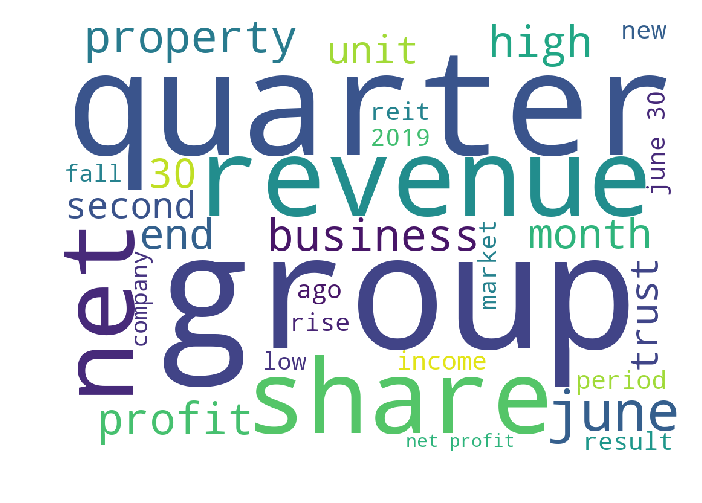



THE TOP 30 WORDS FOR TOPIC #4
['team', 'hotel', 'month', 'unit', 'financial', 'area', 'fund', 'executive', 'new', 'include', 'firm', 'property', 'deal', 'exchange', 'add', 'management', 'time', 'list', 'investor', 'shareholder', 'sgx', 'capital', 'business', 'group', 'investment', 'price', 'offer', 'market', 'share', 'company']


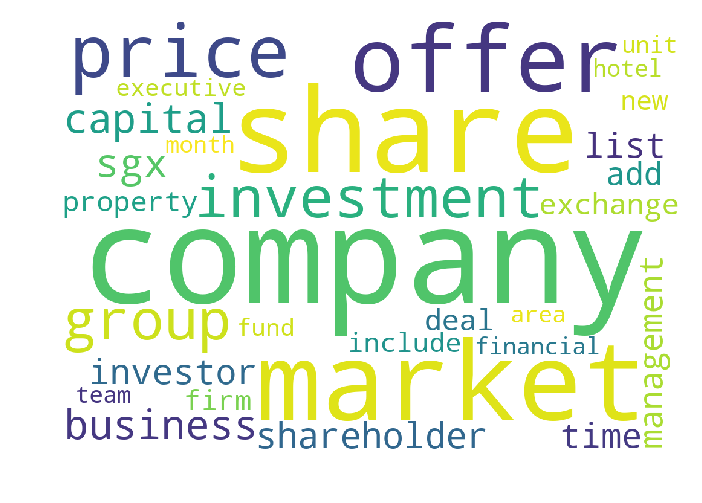



THE TOP 30 WORDS FOR TOPIC #5
['partner', 'product', 'work', 'startup', 'asia', 'capital', 'global', 'solution', 'time', 'include', 'add', 'help', 'industry', 'fund', 'financial', 'new', 'need', 'investment', 'digital', 'deal', 'investor', 'good', 'reit', 'firm', 'market', 'technology', 'use', 'service', 'company', 'business']


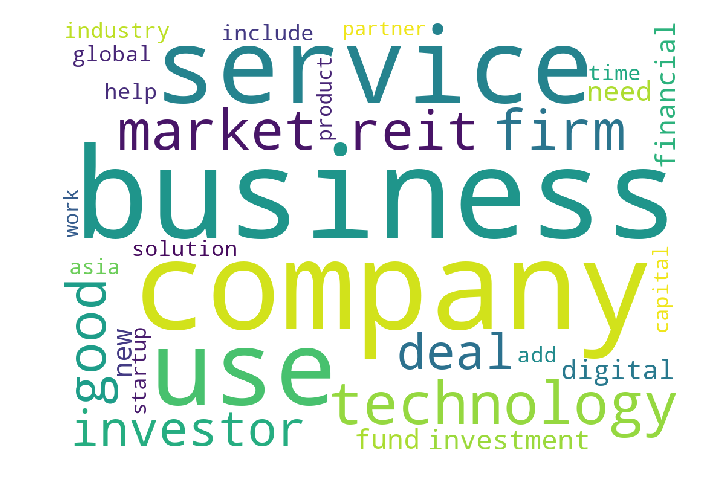

In [101]:
quarters = [str(quarter) for quarter in sorted(bt_df['date'].dt.to_period('Q').unique())] 
#get unique values of quarters, save into a list of strings
topic_by_quart = topic_quarter(quarters, 5)

After grouping topics into five topics, we see that the model is able to identify major events such as the Singapore election in 2015Q3, Trump's election in 2016Q4, and the market tumble in 2018Q4 due to trade tensions from Trump's trade war. Market concerns have carried into 2019, with similar topics appearing in the subsequent quarters.

We now have a dictionary of the topics and the top words associated with each topic. Note that the topic numbers make sense only when viewed within the quarter. For example, 2014Q1 topic 1 is not the same as 2014Q2 topic 1.

In [133]:
print(len(topic_by_quart['topics'])) #check if the len is same as number of articles 
topic_by_quart['topics'] #this is the topic by year 

49159


array([0., 1., 0., ..., 4., 3., 1.])

In [134]:
bt_df['topic_quart'] = topic_by_quart['topics'] #form new column for topics 
bt_df['topic_quart'] = bt_df['topic_quart'].astype(int) #change to int

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [136]:
bt_df

,byline,date,headline,page,text,scores,neg,neu,pos,compound,text_clean,text_lemma,topic_year,topic_quart
0,Helmi Yusof,2014-12-29,Nurturing talent – 10 years and counting,12 - 13,CHILDAID 2104 was a milestone in so many ways....,"{'neg': 0.043, 'neu': 0.821, 'pos': 0.135, 'co...",0.043,0.821,0.135,0.9980,childaid 2104 was a milestone in so many ways ...,childaid 2104 be a milestone in so many way fi...,6,0
1,R Sivanithy,2014-12-29,Good chance for window-dressing push on STI,7,"STOCKS IN THE near term (that is, this week...","{'neg': 0.092, 'neu': 0.814, 'pos': 0.094, 'co...",0.092,0.814,0.094,0.1046,stocks in the near term that is this week t...,stock in the near term that be this week t...,3,1
2,Robert Halili,2014-12-29,Directors’ buying down in holiday shortened week,6,INSIDE MARKETS But selling recovers with 12 co...,"{'neg': 0.023, 'neu': 0.842, 'pos': 0.135, 'co...",0.023,0.842,0.135,0.9995,inside markets but selling recovers with 12 co...,inside market but sell recover with 12 company...,7,0
3,Cai Haoxiang,2014-12-29,Why invest? And how do you do it?,10,MONDAY MULTIPLE Aim for a sustainable stream o...,"{'neg': 0.092, 'neu': 0.81, 'pos': 0.098, 'com...",0.092,0.810,0.098,-0.9206,monday multiple aim for a sustainable stream o...,monday multiple aim for a sustainable stream o...,0,0
4,Claire Huang,2014-12-29,Correction:,4,IN “Continued smooth sailing a safe bet for no...,"{'neg': 0.062, 'neu': 0.85, 'pos': 0.088, 'com...",0.062,0.850,0.088,0.8446,in continued smooth sailing a safe bet for now...,in continue smooth sail a safe bet for now bt ...,0,1
5,Lee Meixian,2014-12-29,Soft market ahead for most developers,1,OUTLOOK 2015: INDUSTRIAL PROPERTY But high-spe...,"{'neg': 0.089, 'neu': 0.814, 'pos': 0.098, 'co...",0.089,0.814,0.098,0.5018,outlook 2015 industrial property but high spec...,outlook 2015 industrial property but high spec...,8,0
6,Pauline Ng,2014-12-29,More of the same enervating and dismal politic...,2,"OUTLOOK 2015: MALAYSIA Analysts, however, hope...","{'neg': 0.139, 'neu': 0.753, 'pos': 0.108, 'co...",0.139,0.753,0.108,-0.9925,outlook 2015 malaysia analysts however hope mo...,outlook 2015 malaysia analyst however hope mor...,3,2
7,NaN,2014-12-30,Advertisers give BT website top marks,3,Singapore THE Business Times website has been ...,"{'neg': 0.0, 'neu': 0.934, 'pos': 0.066, 'comp...",0.000,0.934,0.066,0.8807,singapore the business times website has been ...,singapore the business time website have be ra...,0,3
8,NaN,2014-12-30,PM: Michael Fam a rare and selfless individual,6,OBITUARY: MICHAEL FAM MICHAEL Fam was a “rare ...,"{'neg': 0.023, 'neu': 0.891, 'pos': 0.085, 'co...",0.023,0.891,0.085,0.9682,obituary michael fam michael fam was a rare an...,obituary michael fam michael fam be a rare and...,0,1
9,Anthony Rowley,2014-12-30,Scrabbling for a place at the AIIB table,21,Strong political bargaining is going on behind...,"{'neg': 0.054, 'neu': 0.859, 'pos': 0.087, 'co...",0.054,0.859,0.087,0.9951,strong political bargaining is going on behind...,strong political bargaining be go on behind th...,3,1


#### Save quarterly topic words to dataframe and `csv`

In [259]:
{k:v.keys() for k, v in topic_by_quart['top_words'].items()} #quarter as key, topic number as value

{'2014Q1': dict_keys([0, 1, 2, 3, 4]),
 '2014Q2': dict_keys([0, 1, 2, 3, 4]),
 '2014Q3': dict_keys([0, 1, 2, 3, 4]),
 '2014Q4': dict_keys([0, 1, 2, 3, 4]),
 '2015Q1': dict_keys([0, 1, 2, 3, 4]),
 '2015Q2': dict_keys([0, 1, 2, 3, 4]),
 '2015Q3': dict_keys([0, 1, 2, 3, 4]),
 '2015Q4': dict_keys([0, 1, 2, 3, 4]),
 '2016Q1': dict_keys([0, 1, 2, 3, 4]),
 '2016Q2': dict_keys([0, 1, 2, 3, 4]),
 '2016Q3': dict_keys([0, 1, 2, 3, 4]),
 '2016Q4': dict_keys([0, 1, 2, 3, 4]),
 '2017Q1': dict_keys([0, 1, 2, 3, 4]),
 '2017Q2': dict_keys([0, 1, 2, 3, 4]),
 '2017Q3': dict_keys([0, 1, 2, 3, 4]),
 '2017Q4': dict_keys([0, 1, 2, 3, 4]),
 '2018Q1': dict_keys([0, 1, 2, 3, 4]),
 '2018Q2': dict_keys([0, 1, 2, 3, 4]),
 '2018Q3': dict_keys([0, 1, 2, 3, 4]),
 '2018Q4': dict_keys([0, 1, 2, 3, 4]),
 '2019Q1': dict_keys([0, 1, 2, 3, 4]),
 '2019Q2': dict_keys([0, 1, 2, 3, 4]),
 '2019Q3': dict_keys([0, 1, 2, 3, 4])}

In [260]:
tuple_list = []
for item in {k:v.keys() for k, v in topic_by_quart['top_words'].items()}.items(): #quarter as key, topic number as value
    for i in item[1]: #each topic number
        tuple_list.append((item[0], i)) #pair quart with topic number as tuple 

len(tuple_list) #check if there are 115 total topics

115

In [261]:
word_list = []
for quarter in topic_by_quart['top_words'].values(): #all topic words with topic number 
    for topic in quarter.values(): #each topic
        word_list.append(topic)
        
len(word_list)

115

In [263]:
quart_word_df = pd.DataFrame.from_dict(dict(zip(tuple_list, word_list)), orient="index")
quart_word_df.head()

open    minister        food        china        home  \
2014Q1 0  392.486848  395.161107  395.417788   396.097876  410.684832   
       1         NaN         NaN         NaN          NaN         NaN   
       2         NaN         NaN         NaN  1217.516822         NaN   
       3         NaN         NaN         NaN          NaN         NaN   
       4         NaN         NaN         NaN          NaN  367.744303   

                know     chinese        look  restaurant        need  ...  \
2014Q1 0  422.831288  433.124932  438.914435  443.921349  452.269706  ...   
       1         NaN         NaN         NaN         NaN  718.633618  ...   
       2         NaN         NaN         NaN         NaN         NaN  ...   
       3         NaN         NaN         NaN         NaN         NaN  ...   
       4         NaN         NaN         NaN         NaN         NaN  ...   

          startup  experience  equity  hyflux  cut  net profit  june 30  \
2014Q1 0      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       1      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       2      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       3      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       4      NaN         NaN     NaN     NaN  NaN         NaN      NaN   

          result  period  partner  
2014Q1 0     NaN     NaN      NaN  
       1     NaN     NaN      NaN  
       2     NaN     NaN      NaN  
       3     NaN     NaN      NaN  
       4     NaN     NaN      NaN  

[5 rows x 310 columns]

In [264]:
quart_word_df.to_csv(r'../datasets/bt/quart_word.csv') #save to csv

In [232]:
quart_word_df_test = pd.read_csv('../datasets/bt/quart_word.csv', index_col=(0, 1))#test if it loads back properly use 1st and second column of csv to form multiindex 
quart_word_df_test.head()

open    minister        food        china        home  \
2014Q1 0  392.486848  395.161107  395.417788   396.097876  410.684832   
       1         NaN         NaN         NaN          NaN         NaN   
       2         NaN         NaN         NaN  1217.516822         NaN   
       3         NaN         NaN         NaN          NaN         NaN   
       4         NaN         NaN         NaN          NaN  367.744303   

                know     chinese        look  restaurant        need  ...  \
2014Q1 0  422.831288  433.124932  438.914435  443.921349  452.269706  ...   
       1         NaN         NaN         NaN         NaN  718.633618  ...   
       2         NaN         NaN         NaN         NaN         NaN  ...   
       3         NaN         NaN         NaN         NaN         NaN  ...   
       4         NaN         NaN         NaN         NaN         NaN  ...   

          startup  experience  equity  hyflux  cut  net profit  june 30  \
2014Q1 0      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       1      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       2      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       3      NaN         NaN     NaN     NaN  NaN         NaN      NaN   
       4      NaN         NaN     NaN     NaN  NaN         NaN      NaN   

          result  period  partner  
2014Q1 0     NaN     NaN      NaN  
       1     NaN     NaN      NaN  
       2     NaN     NaN      NaN  
       3     NaN     NaN      NaN  
       4     NaN     NaN      NaN  

[5 rows x 310 columns]

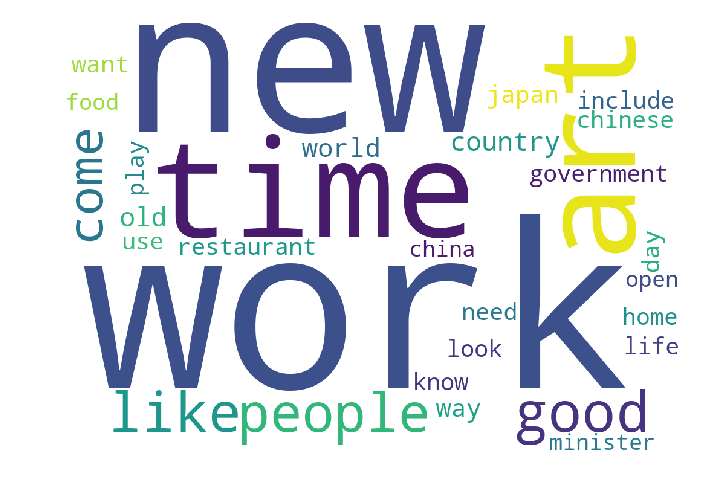

In [266]:
#test making a word cloud from the loaded csv
wc = WordCloud( #instantiate
                background_color="white",
                max_words=2000,
                width=1024,
                height=720)
wc.generate_from_frequencies(quart_word_df_test.loc['2014Q1'].loc[0].dropna().to_dict()) #make the wordcloud
plt.axis('off')
plt.imshow(wc)#display
plt.show()

#### Save wordclouds

In [257]:
#### make a loop to save the word clouds
quarters = []

for year in years:
    for i in range(4):
        quarters.append(str(year) + 'Q' + str(i+1)) #create list of quarters

quarters.remove('2019Q4')  #remove this quarter as data doesnt exist for this quarter

for quarter in quarters: 
    for i in range(5):
        wc = WordCloud( #instantiate
                background_color="white",
                colormap=cmap, #insert custom colour map here
                font_path='../assets/helveticaneue/HelveticaNeue Medium.ttf', #insert custom font
                width=1024,
                height=720)
        wc.generate_from_frequencies(quart_word_df_test.loc[quarter].loc[i].dropna().to_dict()) #make the wordcloud
        wc.to_file("../assets/quarter_word_cloud/{}-topic-{}.jpg".format(quarter, i)) #save the wordcloud

In [368]:
#### save word clouds in lower res for web
quarters = []

for year in years:
    for i in range(4):
        quarters.append(str(year) + 'Q' + str(i+1)) #create list of quarters

quarters.remove('2019Q4')  #remove this quarter as data doesnt exist for this quarter

for quarter in quarters: 
    for i in range(5):
        wc = WordCloud( #instantiate
                background_color="white",
                colormap=cmap, #insert custom colour map here
                font_path='../assets/helveticaneue/HelveticaNeue Medium.ttf', #insert custom font
                width=512,
                height=360)
        wc.generate_from_frequencies(quart_word_df_test.loc[quarter].loc[i].dropna().to_dict()) #make the wordcloud
        wc.to_file("../assets/quarter_word_cloud_low/{}-topic-{}.jpg".format(quarter, i)) #save the wordcloud

## Company/trend evaluation

Let's identify companies and trends through headlines and gauge sentiment towards them. 

### Data cleaning of headlines

In [139]:
bt_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49159 entries, 0 to 49170
Data columns (total 14 columns):
byline         41205 non-null object
date           49159 non-null datetime64[ns]
headline       49154 non-null object
page           47800 non-null object
text           49159 non-null object
scores         49159 non-null object
neg            49159 non-null float64
neu            49159 non-null float64
pos            49159 non-null float64
compound       49159 non-null float64
text_clean     49159 non-null object
text_lemma     49159 non-null object
topic_year     49159 non-null int64
topic_quart    49159 non-null int64
dtypes: datetime64[ns](1), float64(4), int64(2), object(7)
memory usage: 5.6+ MB


There are five null values in the headlines.

In [140]:
bt_df[bt_df['headline'].isna()]

,byline,date,headline,page,text,scores,neg,neu,pos,compound,text_clean,text_lemma,topic_year,topic_quart
5239,NaN,2014-06-30,NaN,4,– Mr Yong,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.000,1.000,0.000,0.0000,mr yong,mr yong,6,1
7588,NaN,2014-04-07,NaN,10 - 11,The Masterplan will provide a comprehensive pl...,"{'neg': 0.012, 'neu': 0.82, 'pos': 0.168, 'com...",0.012,0.820,0.168,0.9994,the masterplan will provide a comprehensive pl...,the masterplan will provide a comprehensive pl...,0,0
14031,"As For Official Pro-Ns Policies, We Do Not Cat...",2015-08-10,NaN,16,Samuel Tsien Group CEO OCBC Bank NATIONAL s...,"{'neg': 0.018, 'neu': 0.794, 'pos': 0.189, 'co...",0.018,0.794,0.189,0.9825,samuel tsien group ceo ocbc bank national s...,samuel tsien group ceo ocbc bank national ...,5,0
36320,To Taste.,2017-01-21,NaN,NaN,Method: 1. Chop garlic and ginger into rough ...,"{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.000,1.000,0.000,0.0000,method 1 chop garlic and ginger into rough bi...,method 1 chop garlic and ginger into rough b...,6,4
43295,<35 Years Old35-55 Years Old,2018-02-23,NaN,NaN,>55 years old FOR FEMALES<35 years old 35-5...,"{'neg': 0.02, 'neu': 0.862, 'pos': 0.118, 'com...",0.020,0.862,0.118,0.9926,55 years old for females35 years old 35 55 ...,55 year old for females35 year old 35 55 ...,4,0


In [141]:
for i, ind in enumerate(bt_df[bt_df['headline'].isna()].index):
    print(f'Article {i+1}')
    print(bt_df.loc[ind]['byline']) #view what is in byline of articles with no headline
    print(bt_df.loc[ind]['text'])#view what is in text of articles with no headline
    print('\n')

Article 1
nan
– Mr Yong  


Article 2
nan
The Masterplan will provide a comprehensive platform for social collaboration, business process improvement, and contextual analytics. It can marry business information with business processes to make collaboration seamless in an organisation. This means employees will be able to team more effectively – with the ability to cross-pollinate ideas and cut down on having to reinvent the wheel – which then enables faster decision-making. Some may call it social media, others social business. We call it the way work is done.   Chris Mead Regional Director Hays in Singapore & Malaysia CREATING a data marketplace comprising both public and private sector datasets is a fascinating idea. It will certainly differentiate Singapore as a place that can help data owners monetise their data with data licensing fees, realise new revenue streams and further encourage them to share data. Data analytics can help businesses plan their marketing strategies and Hays 

Since there are just five articles, we can fill nulls with a generic headline. 

In [142]:
bt_df['headline'] = bt_df['headline'].fillna(value='BT headline')

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [143]:
bt_df['headline_lower'] = bt_df['headline'].map(lambda head: head.lower()) 
#create new column with lowercase headline

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


### Sentiment analysis of subject

We will create a function that can compare the sentiment towards a chosen subject with the overall Beats index as well as display the number of articles about that subject.  

In [144]:
def subject_compare(subject): #create function to compare subject sentiment with overall sentiment and article count
    subject_lower = subject.lower()
    fig, ax1 = plt.subplots(figsize=(14,7)) #dual axis plot

    color1 = 'tab:blue'
    color2 = 'tab:red'
    ax1.set_xlabel('Date', size=12)
    ax1.set_ylabel('Sentiment', size=12)
    ax1.plot(bt_df.groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().index.to_timestamp(), 
             bt_df.groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().values, 
             lw=1.5,
             color=color1, 
             label='Beats')
    #groupby period then take mean of compound score, plot x is time, y is mean compound score
    ax1.plot(bt_df[bt_df['headline_lower'].str.contains(subject_lower, regex=False)].groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().index.to_timestamp(), 
             bt_df[bt_df['headline_lower'].str.contains(subject_lower, regex=False)].groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().values, 
             lw=1.5,
             color=color2, 
             label=subject)
    ax1.tick_params(axis='y', labelsize=12)
    ax1.set_title('Beats index and {} (quarterly)'.format(subject), size=18)

    ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

    color3 = 'tab:green'
    ax2.set_ylabel('Number of {} articles'.format(subject), color=color3, size=12)  # we already handled the x-label with ax1
    ax2.bar(bt_df[bt_df['headline_lower'].str.contains(subject_lower, regex=False)].groupby(bt_df.date.dt.to_period('Q'))['compound'].mean().index.to_timestamp(), 
            bt_df[bt_df['headline_lower'].str.contains(subject_lower, regex=False)].groupby(bt_df.date.dt.to_period('Q')).size(),
            color=color3, 
            width=50, 
            alpha=0.5)
    ax2.tick_params(axis='y', labelsize=12, labelcolor=color3)
    
    # ask matplotlib for the plotted objects and their labels
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax2.legend(lines1 + lines2, labels1 + labels2)

    fig.tight_layout()  # otherwise the right y-label is slightly clipped
    plt.show()

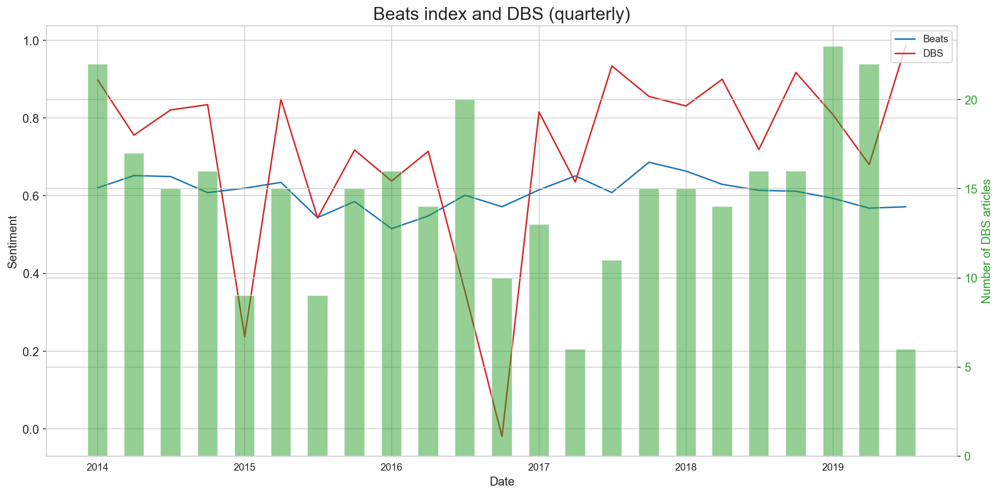

In [270]:
subject_compare('DBS')

Let's also create a function that shows the top three most positive and negative headlines in each quarter.

In [146]:
def headline_highlow(subject): #function to get top 3 most positive and negative article headlines
    quarters = [str(quarter) for quarter in sorted(bt_df['date'].dt.to_period('Q').unique())] #get all quarters in a list
    subject_lower = subject.lower() #lowercase subject
    for quarter in quarters:
        if bt_df[(bt_df['date'].dt.to_period('Q') == quarter) & bt_df['headline_lower'].str.contains(subject_lower, regex=False)].shape[0] < 6:
            print('Five or fewer articles about {} in {}'.format(subject, quarter))
            print('\n') #if fewer than 6 articles, don't do comparison
            print('='*60)
            continue
        else:
            print('##### {} #####'.format(quarter))
            print('Top 3 most positive articles about {}:'.format(subject))
            for i in range(3): #cycle through top three articles
                print(str(bt_df[(bt_df['date'].dt.to_period('Q') == quarter) & bt_df['headline_lower'].str.contains(subject_lower, regex=False)].nlargest(3, 'compound')['date'].iloc[i]).split()[0], #convert date to string, split and get date only so time is excluded
                      bt_df[(bt_df['date'].dt.to_period('Q') == quarter) & bt_df['headline_lower'].str.contains(subject_lower, regex=False)].nlargest(3, 'compound')['headline'].iloc[i]
                ) #this code filters by the quarter and the headline containing the subject, nlargest for top scores in compound
            print('\n')
            print('Top 3 most negative articles about {}:'.format(subject))
            for i in range(3):
                print(str(bt_df[(bt_df['date'].dt.to_period('Q') == quarter) & bt_df['headline_lower'].str.contains(subject_lower, regex=False)].nsmallest(3, 'compound')['date'].iloc[i]).split()[0], 
                      bt_df[(bt_df['date'].dt.to_period('Q') == quarter) & bt_df['headline_lower'].str.contains(subject_lower, regex=False)].nsmallest(3, 'compound')['headline'].iloc[i]
                ) #this code filters by the quarter and the headline containing the subject, nsmallest for lowest scores in compound
            print('\n')
            print('='*60)

In [271]:
headline_highlow('DBS')

##### 2014Q1 #####
Top 3 most positive articles about DBS:
2014-02-05 DBS, OCBC see jump in brand value
2014-02-15 DBS posts 6% higher Q4 net profit of $802m
2014-03-28 DBS offers new multiplier scheme to reward customers


Top 3 most negative articles about DBS:
2014-02-15 DBS sees home prices falling by 10-15% this year
2014-02-25 Higher CPF contribution to have minimal impact on firms: DBS
2014-03-22 DBS eyes higher growth from SME segment


##### 2014Q2 #####
Top 3 most positive articles about DBS:
2014-06-21 DBS goes big on the mass affluent
2014-06-21 HSBC, StanChart, DBS zoom in on RMB cross-border financing
2014-04-08 OCBC trumps UOB, DBS as most regionalised bank


Top 3 most negative articles about DBS:
2014-06-17 DBS, POSB ATMs, online services down for 5 hrs
2014-05-03 DBS, OCBC impress with stronger Q1 performance
2014-05-08 DBS embarks on journey of human-centred design


##### 2014Q3 #####
Top 3 most positive articles about DBS:
2014-08-01 Deloitte, DBS top guns bag acco

2017-10-07 DBS appoints Taimur Baig as chief economist
2017-11-14 Noble loses support from DBS, co-CEO resigns


##### 2018Q1 #####
Top 3 most positive articles about DBS:
2018-01-03 DBS and Chubb in 15-year insurance distribution deal
2018-01-12 Stock markets could go higher still in 2018: DBS
2018-02-09 DBS shares soar on S$1.20 dividend pledge and record earnings


Top 3 most negative articles about DBS:
2018-01-20 EOL restructuring terms not sitting well with DBS, UOB
2018-02-22 DBS throws bash to mark new year and golden jubilee
2018-02-02 Ezion to redeem S$120m DBS-backed notes


##### 2018Q2 #####
Top 3 most positive articles about DBS:
2018-05-01 DBS shares shoot past S$30 on 21% surge in Q1 earnings
2018-05-19 DBS makes a big splash with Marina Regatta
2018-05-14 Carousell snags US$85m in new funding by investors including DBS


Top 3 most negative articles about DBS:
2018-06-30 DBS names Tan Teck Long as new chief risk officer
2018-04-06 DBS aims for 30% reduction in corporat

## Save `csv` file

Let's save a `csv` file containing the sentiment, cleaned text, and topics in case we need to use them at a later point.

In [148]:
bt_df.to_csv(r'../datasets/bt/bt_score_topics.csv')  #save the file with sentiment scores, cleaned text, and topics

Let's also save a `csv` file containing the date, headlines columns, and sentiment. This will reduce the size of the dataframe needed for our Dash dashboard. 

In [67]:
bt_df[['date', 'headline', 'headline_lower', 'compound']].to_csv(r'../datasets/bt/bt_abridged.csv')  